In [1]:
import os
import pandas as pd
import Bio.PDB.PDBList as biopy
import PCN
import traceback
import tarfile
import random
import numpy as np
import networkx as nx
import MDAnalysis as mda
import random
import Bio
import matplotlib.pyplot as plt
import esm
import torch
import os
from Bio import SeqIO
import itertools
from typing import List, Tuple
import string
import MDAnalysis as mda
from sklearn.metrics import accuracy_score,f1_score,precision_score,recall_score,matthews_corrcoef,roc_curve, auc
torch.set_grad_enabled(False)


## Helper Functions for ESM-1b

In [2]:
deletekeys = dict.fromkeys(string.ascii_lowercase)
deletekeys["."] = None
deletekeys["*"] = None
translation = str.maketrans(deletekeys)

def read_sequence(filename: str) -> Tuple[str, str]:
    """ Reads the first (reference) sequences from a fasta or MSA file."""
    record = next(SeqIO.parse(filename, "fasta"))
    return record.description, str(record.seq)

def remove_insertions(sequence: str) -> str:
    """ Removes any insertions into the sequence. Needed to load aligned sequences in an MSA. """
    return sequence.translate(translation)

def read_msa(filename: str, nseq: int) -> List[Tuple[str, str]]:
    """ Reads the first nseq sequences from an MSA file, automatically removes insertions."""
    return [(record.description, remove_insertions(str(record.seq)))
            for record in itertools.islice(SeqIO.parse(filename, "fasta"), nseq)]

def load_ESM_1b():
    """ Download the ESM_1b model and initalizes it."""
    esm1b, esm1b_alphabet = esm.pretrained.esm1b_t33_650M_UR50S()
    esm1b = esm1b.eval().cpu()
    esm1b_batch_converter = esm1b_alphabet.get_batch_converter()
    return esm1b,esm1b_batch_converter

## Data for Contact Map Analysis

#### The query for obtaining the list of PDB_IDs are as follows:
<a href="https://www.rcsb.org/search?request=%7B%22query%22%3A%7B%22type%22%3A%22group%22%2C%22logical_operator%22%3A%22and%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22group%22%2C%22logical_operator%22%3A%22and%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22group%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22full_text%22%2C%22parameters%22%3A%7B%22value%22%3A%22kinase%22%7D%7D%2C%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22full_text%22%2C%22parameters%22%3A%7B%22value%22%3A%22crystal%20structure%20%22%7D%7D%5D%2C%22logical_operator%22%3A%22and%22%7D%5D%2C%22label%22%3A%22full_text%22%7D%2C%7B%22type%22%3A%22group%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22group%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22text%22%2C%22parameters%22%3A%7B%22attribute%22%3A%22rcsb_entry_info.resolution_combined%22%2C%22operator%22%3A%22range%22%2C%22value%22%3A%5B1%2C1.5%5D%7D%7D%5D%2C%22logical_operator%22%3A%22and%22%7D%2C%7B%22type%22%3A%22group%22%2C%22nodes%22%3A%5B%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22text%22%2C%22parameters%22%3A%7B%22attribute%22%3A%22entity_poly.rcsb_entity_polymer_type%22%2C%22operator%22%3A%22exact_match%22%2C%22value%22%3A%22Protein%22%7D%7D%2C%7B%22type%22%3A%22terminal%22%2C%22service%22%3A%22text%22%2C%22parameters%22%3A%7B%22attribute%22%3A%22rcsb_entry_info.resolution_combined%22%2C%22operator%22%3A%22range%22%2C%22value%22%3A%5B1%2C1.5%5D%7D%7D%5D%2C%22logical_operator%22%3A%22and%22%7D%5D%2C%22logical_operator%22%3A%22and%22%2C%22label%22%3A%22text%22%7D%5D%7D%2C%22return_type%22%3A%22entry%22%2C%22request_info%22%3A%7B%22query_id%22%3A%2213e2ed91c000ae1a14db66b7028d506d%22%7D%2C%22request_options%22%3A%7B%22pager%22%3A%7B%22start%22%3A0%2C%22rows%22%3A25%7D%2C%22scoring_strategy%22%3A%22combined%22%2C%22sort%22%3A%5B%7B%22sort_by%22%3A%22score%22%2C%22direction%22%3A%22desc%22%7D%5D%7D%7D">Search Query</a>



In [8]:
query_res3="2D9Z,2G7B,2FS6,3D95,7D0E,2FR3,7Q9Q,5O9M,3IU1,6FR3,1SMO,4PZ3,1YPQ,5N86,4N6X,6QRN,6FR4,4O8I,5ML3,5EMA,5GJH,6YA6,4JV8,4AL0,4R0X,4MPA,4LMM,3MRK,1D1Z,2YXF,3WA4,6TSE,5V1Y,3FSO,2J8B,4L0N,4P0C,5Y45,6AT6,2H2T,5Y46,6EYM,2AEB,4JL7,4Q3H,5CFA,1NKO,3RFE,6ISM,6ITA,3IQJ,3K05,3SPV,3NFK,5YD3,4GXV,2DN2,6TDP,3MRB,3ICH,3IQV,3IQU,5E5V,6TT2,5DZO,1IE9,6JOZ,7KGQ,7KGP,1OGT,3A40,2DN3,5IB2,5YD4,6F2Q,2NW2,6YPE,7BRQ,2UWR,6FR5,6EH4,6EH5,1OBX,1FD0,7E0B,4N19,4DND,4YUD,2EAQ,1JWR,2DN1,2D5Z,4WW1,6EEY,5LXI,3FQ4,3EY6,3I4W,1XPH,7LHJ,7LHO,6AQ1,6GKS,6TCR,4RAH,6LAN,4UDT,4RFZ,3TV3,6Y26,6Y27,6Y29,6Y2B,6Y2A,1FCX,1FCY,1FCZ,3UE2,3R0N,6B8G,3US5,1LF7,6EGE,5PYW,5PXB,5PXA,5PXL,5PY5,5PXT,5PXS,5PXN,5PWG,5PWF,5PX4,5PWS,5PX2,5PWR,5PX6,5PWU,4GSV,4GRZ,1D4T,7DY4,7DY3,3NZL,4RMT,4RMQ,2ZNR,1OKI,1H4A,6RQU,5AUL,6B8F,2BNU,3O46,5ZG1,5ZG2,4IEJ,5C0E,5N1Y,3CN4,4YEP,1M9Z,1IWX,1IWY,1IWZ,1IWT,1IWU,1IWV,1IWW,7NDY,6R9U,6R8O,6R8W,1HK0,3ESP,3ESO,3ESN,1TBF,4P5Q,3CJW,6PUV,6ETC,6RQW,6RQQ,4N7U,2A83,2QGB,2QGC,2QGE,5L0S,3G36,5P21,1K5N,6EW4,3CZF,1K8U,1XOZ,6MS1,6DN7,5FFV,3AJ4,1UZ3,4F3J,3NSO,3WH2,3WH3,1PWA,1OGA,5L0T,5LLP,5MSB,6TRN,5LXX,6B8K,2AKZ,3IB4,2PIE,6FBB,1SQN,5P9K,1SG4,3IMW,3IMV,3IMU,3IMT,3IMS,5HKJ,7BQI,5DWP,3O5P,3O5O,3O5L,1XD3,2VWR,4PQW,6FCP,6HMT,1K96,6V7S,6V7Q,6UYZ,1MJN,4WJQ,7AEW,6HYO,4XOF,7EV1,5C0F,1NTE,6Y8E,4H2Z,4GH0,1QDD,6B9X,1X7Q,5PG1,2XZC,4N7I,6FZL,6FXU,6HK9,3CR6,2CB8,5LJG,2XR6,4IN0,6TX7,6TX5,6TX4,6G6K,2Q3G,6UMU,6UMV,6TX9,6TX8,5W2F,6L9O,4QPN,6PYJ,1I71,1SR7,6Y1J,5FAZ,5F7G,5F6B,6O5W,5MR1,6DCM,6SW3,5LF9,2QG1,4WLH,2CAR,5O6H,2V89,3JVE,3GIX,2ILI,4QGX,2ICC,7LIN,4CAY,1WM3,2B69,5BOW,5ZCK,7KQL,3KHF,2FZD,6TGK,3PE6,3KUJ,3BQP,5IO9,4YDP,3O2T,5EV9,5EVA,5ETD,5ETB,5EPS,5EM3,6ZBK,4FH0,2GBJ,6Z1V,5PVT,5PV3,5PUZ,5PV8,5PTF,5PTG,5PTQ,5PTN,5PTM,5PTK,5PTT,5PTS,5PT0,5PSN,5PSK,5PSL,5PSJ,5PT9,5PST,5PSQ,5PRP,5PPX,5PPY,5PPW,5PQC,5PQI,5PPE,5PPB,5PQ2,4BB9,3M9J,5POU,5PNX,5PNY,5PO5,5POC,5POO,5PO4,5PO0,6W2G,3CZT,5VEI,6FNK,6FNL,6FNI,6FNJ,6AC0,1T3Y,2HXS,3MAO,5DK8,2RCQ,2FRG,5XN3,1PA7,3EYI,6HAR,4TXR,4JFI,6VB2,7JX5,4NUA,4NKE,6MEE,3S92,2HQX,6VJJ,2FE5,6PYV,6PYW,6G9Z,5O8I,5WLV,7CIO,3RZN,3O3U,6A66,6MEG,6R6Y,4C45,2FZ8,2P02,6D0A,6YZH,6Z19,4HCV,4HCU,4HCT,3LNY,5WL1,1WMS,1J40,1J41,6GBI,6EXY,3WAR,6MV4,5LLC,5LLG,4EO7,4RRV,5AJO,3HNB,3HNY,2VXV,2JIK,6ASH,1X3S,3S8S,4L7X,6L0O,5BT5,5HFQ,5HEL,6I80,7JGW,3VWD,4JZQ,4K0G,4K0N,4ZZ1,4ZZ2,7M3X,5EQ0,5TDB,5PNW,5PNU,5PMY,5PMZ,5PN8,5PMW,5PN9,5PMX,5PN6,5PMU,5PN7,5PMV,5PN4,5PMS,5PN5,5PMT,5PNB,5PNC,5PNJ,5PNK,5PNH,5PNI,5PNF,5PNG,5PND,5PNE,5PNR,5PNS,5PNP,5PNQ,5PNN,5PNL,5PNM,5PLX,5PLY,5PM7,5PLV,5PLW,5PLU,5PM3,5PM4,5PMA,5PMJ,5PME,5PMF,5PN2,5PMQ,5PN0,5PN1,5PMM,5PMK,5PKW,5PKX,5PL6,5PKU,5PL7,5PKV,5PL4,5PL2,5PKQ,5PL3,5PKR,5PLA,5PKY,5PLH,5PLI,5PLF,5PLG,5PLD,5PLE,5PLB,5PLC,5PLP,5PLQ,5PLN,5PLO,5PLL,5PLM,5PLJ,5PLK,5PK7,5PJV,5PK8,5PK5,5PJU,5PK3,5PJR,5PK1,5PJP,5PK2,5PJQ,5PJZ,5PK9,5PJX,5PJY,5PKH,5PKE,5PKF,5PKC,5PKB,5PL0,5PL1,5PKP,5PKM,5PKN,5PKL,5PKI,5PKJ,5PJ6,5PIU,5PJ7,5PIV,5PIS,5PJ5,5PJ2,5PJ3,5PIR,5PJ0,5PJ1,5PIP,5PIY,5PIZ,5PJ8,5PIW,5PIX,5PJF,5PJG,5PJD,5PJE,5PJC,5PJN,5PK0,5PJO,5PJM,5PJH,5PJI,5PI5,5PI6,5PI3,5PI4,5PI1,5PHO,5PHZ,5PI9,5PHX,5PHY,5PI8,5PHW,5PIE,5PIF,5PIC,5PIA,5PIM,5PII,5PIJ,5PIG,5VHG,5TP0,3T7L,5HA1,5H9A,4YL3,4YL1,4YK5,2HSH,1UPQ,5HDK,6B29,6N0D,6N0N,5PHN,5PH4,5PH5,5PH2,5PH3,5PH0,5PH1,5PH8,5PH9,5PH7,5PHD,5PHE,5PHB,5PHC,5PHA,5PHL,5PHM,5PHJ,5PHK,5PHF,5PHG,6VRD,3GMZ,3S0K,6IUX,6FNM,6ELM,3I2V,2WWE,5NZX,3LLU,6JWM,4ZX2,5O6O,5O6X,6B26,6HOG,3MEU,2NZL,1R29,5DEJ,4Y89,5TJN,6SAN,3ZSM,3ZSL,3TJM,6RHL,3LN4,2WL1,1CY5,7B13,1WYX,3LQ3,3FEG,5YDE,5YDF,4LM4,4LM3,5MSA,7A22,7A1Z,7A2H,7A1B,5S9B,5S9C,5S9A,5S9J,5S9H,5S9I,5S9F,5S9G,5S9D,5S9E,5S92,5S93,5S8R,5S90,5S91,5S8Y,5S8Z,5S98,5S8W,5S99,5S8X,5S8U,5S97,5S8V,5S94,5S8S,5S95,5S8T,4XX9,3B8Z,3SD6,5MME,2ZOU,3FIA,5CMM,3CX2,4HJP,3PD7,1QGV,1EAX,5WS7,5FG6,2VIF,6ELW,6MTL,5WMQ,6HGM,6HGN,4WY4,5HGZ,7M8U,1XH3,7PJ7,7PJ8,7PJQ,7P8B,7P87,3K82,3MEA,4GJY,3Q6L,6DUB,3F1A,3F16,3F19,3F18,3F17,5OAB,4TW6,3TW2,5OGJ,2AFY,4N5U,2O8T,4ZKR,4ZKO,4ZKN,3BWA,6O53,2E3N,2E3P,4D6R,4D6Q,4U1M,2RGG,7NPG,7NPB,7NP2,7NND,5OHH,7KD7,1JK3,6BCD,4QOG,2YJC,3MHW,3OBQ,1MF7,6L5H,6Y1L,2G3R,3HUP,2IIM,5CVD,5FW6,5FO2,5B78,4GNE,3GHC,5L4I,5L4F,5JID,5JIM,3NU0,7S5A,6BHI,3NTZ,3BWY,3SOV,4GA0,4TL5,1K0M,2OVJ,4Q78,1I27,5GHN,5GHI,5GHJ,5GHQ,5GHP,6ILI,6SYS,6SX9,1KMS,6VI2,7S6O,6YPW,6GR7,2X7K,7AAH,6YOQ,6YNP,6YNK,6YNI,6YL0,6YKI,6YKZ,6YM7,6YM6,5ELQ,1PWB,1I4F,7D3D,6F5S,6F5Q,6ETE,4GJZ,4XEM,4D6S,6H10,6H0Y,6H0Z,6H0W,2FOV,2FOS,3MHR,5UGG,5UGD,5NSA,3TEM,1EAZ,4QHE,1Z89,3GJ0,7JRH,6GY5,2XW9,3V43,4L58,5HGJ,6FQO,6FQU,5OWK,5EP7,5ENG,5MPN,5MMG,3U23,3P1N,4J46,4J45,4J44,4J47,2QFA,6MT3,6MT6,2BVP,4QRT,4QRS,1V05,6KEC,6KEI,4XCF,4XAW,6CBU,5T5J,4HT2,6O3D,6O3K,3SO6,1QH5,6PHQ,6PHM,6PHN,2X18,6T4X,6M5Y,4X08,4KP5,6BLN,6BKW,1KMV,1KGD,5HJG,6BJJ,2VXT,1ZIZ,5D14,6R6F,3L46,7AV9,7BBO,3G4E,5M9O,1ZMI,5IHH,4IPC,2UXW,5KUP,4RX5,3GA3,4YPD,6HRP,6HRT,6DI0,6DI1,6DI9,6DI5,6J2A,4U6Y,6X3P,6HPQ,6M80,3WFG,6SQK,5B5O,6ZRN,6KJW,2ADO,7JQK,3UI5,6NP9,5JJ2,2NN8,5ZBZ,2NMO,1MFG,5E8X,6BJZ,5JI8,6EVN,6E5L,6VA5,3D25,5C3F,5GGN,2NXB,5GGJ,4DPZ,5GGL,5XHK,5XHE,7KPU,6E6K,5EP6,5E8S,6Q43,2GCO,3ZYQ,5NI9,5NIG,6J65,6J5S,3EW0,5KLY,5KM4,6B42,5WA8,5WA9,1PIN,6RCH,6RCG,1ZMK,5XCQ,5XCT,2PPO,2QT1,5U0I,4OBE,4LDJ,6BXP,6G3R,1S1P,6TNQ,3GHW,6KUG,3FE7,3FEA,4C6K,4C6J,4C6I,4C6F,4C6E,4C6D,4C6C,5P9M,5P9L,5P9I,5P9J,7CCW,5GH9,3BFO,5YWR,2RCT,7L9M,6XXJ,2X04,6WYF,1UZK,1N3L,5A0E,2BFD,2BFF,5KYF,5KYC,5W89,3KUS,6BHD,6BHG,6BHE,4Y5I,4IS5,2C01,6SA5,6FNG,6FNH,4ZGG,4KS7,3HYG,4KEL,6O21,5O5F,5O55,5MWZ,5NRA,5NRF,5NR8,3TOW,5YX1,3DGD,6K04,4XZF,1SO7,2HC1,2HC2,5GZE,5GZD,6FQ1,6XZZ,6XYX,1KMT,5D7X,4K8Y,4K1E,2XRW,2CG7,5E13,6ENP,4QOD,2W4F,4GE6,1WMA,7F0W,3VHV,5MGW,2XR5,1I76,4EEW,1I73,4IKU,6QJL,6QJK,6J5Z,2IKG,2IKI,3MRE,4NYW,4NYX,4NR7,6YIM,6YIL,4C9X,4FKL,4EK4,4EK3,5ED3,4MTH,1JSF,6XVD,5H8T,3BER,4P5E,5E50,4QKD,7AJN,7REK,6SE4,6S25,5O97,6I7Y,6I7X,5W55,5E0R,6ZED,6ZEL,6ZF9,2ERF,5NK5,5NK6,5NK4,5NKA,5NKG,5NKH,5NKE,5NKF,5NKC,5NKD,6HOL,2OUS,6J6M,2XN7,2XN6,5U9D,6YIA,6E4F,3F1N,5GOD,5GOB,6WN7,3F1P,5TY6,5GZC,5E1D,6QHJ,3S4E,5D7F,5I4H,4NN2,6WPQ,3UFN,7PCP,7PBY,2RGB,2RGE,2C60,2WP3,4Q26,3AZ3,6Q41,6Q3P,3TGP,3L8Z,7NPC,5XCO,6Q4Q,5WXF,4Y88,1TGR,4OU0,5SZ5,3MHO,2QP6,6EQ4,6H6S,3BUV,4XO6,3AP9,5UM3,2ANY,4FGL,4FGK,3UVW,6GCY,3SBI,3SAX,3S9T,3S8X,5ITQ,7B67,6XLV,3ME9,2PUY,1LKK,1ZUA,4FVN,3S5E,3S4M,4X3K,6HB9,4ONM,2RA3,3PP2,4QOE,2FVV,6R8P,5TJK,3SXE,3SXB,3SX8,3SX5,4FXL,4RMW,4RMV,4RMU,5JIQ,4TQI,6V4G,6WG8,6SRE,3UP3,3E5H,6BJM,7LH7,7B2V,7B2Y,2R9P,2OUR,4NZU,1IRD,4TLS,4TLK,5EN3,3BUX,3F00,5M4L,2YJ2,2YJ9,2YJ8,2YJB,4HBQ,1GP0,2R3Q,2R3R,2R3I,3GHU,3GHT,3GHS,3GHR,5GHO,6KC4,6I18,4J82,3I33,7ASJ,1XAW,6P0J,5GWN,6P0K,6P0L,2H14,4QSB,5WMJ,6IJY,3HLJ,6TEW,6HMB,6HMC,6HMD,3DD0,4MNW,6DMJ,4Q08,7PLP,4QIY,4Q09,4Q07,4Q06,1MJ4,1X9D,4WK7,4QXV,4XEO,2FOQ,6QHL,6YW1,6I4R,6ZK0,5INB,4EIH,7KTE,6HPH,6HPT,6GD3,1Q92,5WCA,7N3G,7N3H,2CVD,7BE3,4WJX,3SX7,3SX3,4YY6,5I9X,5I9Y,5I9V,5I9W,2C9V,2C9S,2C9U,1K3Y,4MUM,5KM2,5KM3,5NP5,4H7W,2B3H,5GGK,7O88,7O4P,2QCE,2QCF,5XRD,5JBT,5WIQ,5FEB,4NFL,4JNU,3WUZ,4HXQ,4HWW,3MFW,3N9G,5KFN,5KFS,7M7N,7M7M,7M84,7M7T,7B2Z,2QUZ,6L1P,6VUP,6VUN,6VUO,7OVY,7FB7,6HFQ,3ZZY,5N20,4KEB,6HAZ,6QUW,4PZH,6QUV,5DFB,3FEC,7MFY,7PB5,5M4G,5MC1,6H2P,7PBA,7PA4,7P9R,4BN4,5SZB,6G5P,4J3Y,2VZC,3F6Y,6S6M,4R9C,4R9B,4R9A,4R9D,4UU5,5VI6,5K26,1I1J,2W7A,4RBX,5PAG,5PAV,5PAS,5PB2,5PAO,5PAX,5PAE,1KJL,4JCK,5N7X,7NTO,2AW1,6F6Y,3GHV,6I77,6I78,6I75,6I76,4XZP,3K7I,4YIK,5E95,6G2L,6G2M,5SZ6,2QO8,4M91,1MFM,6LCB,4E35,4E34,5A1I,7PD9,1Z70,4FGJ,5KM9,3PO6,5SZC,7KT5,5WXH,2A26,5LR1,5XRE,5NYI,4WK9,4WKH,4WKF,4RI5,5WHN,3IOH,5UD9,3ZNV,3ZNX,2C2S,3SP7,1ZKK,1H8D,5DQY,4UZ1,4FVO,2FGB,1ZQ5,5F02,6WFY,6I3C,6I3D,7LB1,6XWZ,5TC6,6GPK,6F4S,6F4T,7KDB,7KDA,7KCF,1USE,4OEL,7E7F,5J1S,5J1T,5V8Q,7B37,7ARG,7B3F,5RYA,5RYI,5RYJ,5RYG,5RYF,5RXA,5RXK,5RXH,5RXF,5RXD,5RXE,5RXR,5RY4,5RXS,5RXL,5RXM,5RXX,5RXY,5RXW,5RWA,5RWB,5RWI,5RWJ,5RWG,5RWE,5RWF,5RWC,5RWD,5RX2,5RWQ,5RX3,5RWR,5RX0,5RWO,5RX1,5RWP,5RWM,5RWN,5RWK,5RWL,5RWY,5RWZ,5RX8,5RWW,5RX9,5RWX,5RX6,5RWU,5RX7,5RWV,5RX4,5RWS,5RX5,5RWT,5RW2,5RW9,5RW7,5RW8,5RW5,5RW6,5RW3,5RW4,6R6I,6R67,6R68,6R66,5WHP,6SQO,5W50,1Y93,1RMZ,5KFZ,5H8X,2HU6,2VH7,5EOP,3DN5,6Q3Y,1T41,1F41,6QUU,5MFA,4GQL,4GR3,4GR0,4GR8,5MPZ,5MQG,2OEI,6DDM,6C3L,3MC5,3M64,3M0I,3LEN,7RXV,7CC7,2BRF,6TOK,2H4E,3HJ2,6EW6,7OKJ,7OKE,7OKG,7OKM,7OKL,5OK6,2OSS,4KNN,5T5L,3U5L,6W2I,5WIA,5FBI,3TCT,3HJ0,5LLL,3SJM,6I0L,6I0J,4PME,4WJO,5LBN,7KJO,6RCJ,6RD2,6N6I,6N6J,4P0T,6RW0,3EAZ,3EAC,4FKU,4NN0,6KDQ,6ZEI,4Y9C,4Y9B,4Y9E,5AYT,4WO0,3P3T,3P3R,6TXW,6LUJ,6F4Q,7L8K,5LVS,1ZLM,5WFB,5KJZ,3HHA,6HMU,1OGW,4ERC,6F3B,6P0I,4H30,6Y7Q,4ICV,4PWI,4PWE,4PMF,4PM1,4D7B,6KGB,6SUG,6SUH,3MO7,7EJR,7EJQ,7DT5,7DT6,7DT3,7DT8,5FH7,6I44,4ZGU,5NWD,5NWG,7PUV,7PUW,6R8R,5R8B,5R8A,5R8K,5R8I,5R8F,5R8G,5R8D,5R8E,5R8Q,5R8N,5R8O,5R8M,5R88,5R87,5R85,4BOQ,7B9Y,7B9Z,7BA0,3SFJ,6XZO,6Y00,3GYL,6LZC,6LZB,5CLY,5CLX,3G9Y,2QFE,6SRH,6Z36,6C7Z,5QIB,6TUZ,7MT1,3ZXH,6FDC,1P5F,5KQL,5CG5,4GKC,4EDE,4RUU,7JWR,7JVG,7JVY,7JWD,7K3I,6VRR,4UP0,3FF3,2GRR,7F3O,6V7P,6V1B,2ETX,6J9O,5LL9,5LL5,3ASL,1PL4,4E1H,6ICG,1F86,7NYG,7NYE,7NZ6,7O6K,7NSV,7O3A,7O3F,7O3P,7NR7,7NMH,7NLE,7NM3,7NK5,7NJB,7NK3,7BIQ,7BI3,7M10,5Y4M,5TEG,3NER,4INC,6SZM,6FBW,6I6V,4MTY,6XXX,6GN5,4BUH,6QF9,6QJU,3VBD,3V7X,6RHK,6RHJ,6RG3,6RG4,5R5A,5R57,5R55,5R53,5R52,5AHG,5AFY,5AF9,4UEH,4UDW,4UE7,4UD9,3HS4,7JOC,7JNR,7JNZ,7JNW,7JNV,6TL7,6Z4A,2IZX,4AE7,6G7A,6G5L,4IGH,6OE1,6OE0,6ODZ,4BMB,5TAB,5LJT,5LJQ,5TH4,6MBY,2NNS,2NNV,2NNO,2NNG,5NEA,5E2K,5E28,5NP4,6ETV,6ETW,4YDN,4YDM,5DSK,5DSL,5DSR,5DSO,5DSP,5DSM,7ERA,6G3Q,4QEF,5YUI,5YUJ,5YUK,6B4D,4KUV,6YQU,5N1S,5N25,5N1R,4RUY,4RUX,6XXT,4RH2,1R2Q,4AW0,7PBB,3MRG,6N3D,6G36,7MU3,4DHR,4WNJ,2PEZ,4WNS,7L1A,7KCE,7KCC,7BHS,7BHR,7BHU,7BHT,7BHW,7BHV,7BHX,7OTF,7OSP,4WW8,5LVN,4CRG,5DC8,3KZD,2DKO,6I5H,6AT8,7O6D,7O6C,7O6A,7O63,6D31,7B8H,5NL4,6M64,6QW3,5VBM,6YAU,5U00,5KTU,6ZDA,6ZD3,6ZD4,2CKK,4YY4,3U2C,3U2U,2YD6,5H1D,7MW7,7MSE,7L9G,2RIT,2RIZ,7RXW,7RXX,5E2M,4QLI,5JNT,3DFJ,2VC8,5ZXE,6ATR,4YZU,4Z0K,6BEV,6RCF,7AKI,3PB7,7AP7,3PB4,3PB9,3PB8,3PB6,4HY4,3F66,5WY9,4N7F,3ZXF,7LIP,6LFH,2HE4,4RQR,4K12,2OLM,5UG8,5UG9,5H5Q,5H5R,5RY8,6ZVO,5QA0,5QA1,5Q9E,5Q9B,5Q9C,5Q9M,5Q9I,5Q9F,5Q9T,5Q9U,5Q9S,5Q9P,5Q9N,5Q9O,5Q9V,5Q8D,5Q8A,5Q8L,5Q8I,5Q8F,5Q95,5Q90,5Q91,5Q8P,5Q8N,5Q8Z,5Q99,5Q8X,5Q8V,5Q7B,5Q7C,5Q7A,5Q7I,5Q7D,5Q83,5Q7S,5Q82,5Q80,5Q7O,5Q7M,5Q7Y,5Q87,5Q7W,5Q86,5Q5Z,5Q6G,5Q6H,5Q6E,5Q6D,5Q72,5Q6Q,5Q73,5Q6R,5Q70,5Q6O,5Q6M,5Q78,5Q6X,5Q76,5Q6U,5Q6V,5Q74,5Q75,5Q5H,5Q5F,5Q5E,5Q5C,5Q5Q,5Q60,5Q5W,5Q5R,5Q64,5Q49,5Q3X,5Q3Y,5Q4E,5Q51,5Q4P,5Q4K,5Q54,5Q55,5Q4Q,5Q38,5Q3F,5Q3G,5Q3E,5Q3C,5Q3A,5Q3M,5Q3J,5Q3K,5Q47,5Q48,5Q3U,5Q43,5Q3P,5Q3Q,5Q2F,5Q2D,5Q2B,5Q2M,5Q2N,5Q2L,5Q2J,5Q2G,5Q36,5Q2U,5Q34,5Q35,5Q2Q,5Q33,5Q2R,6FAV,6FAW,6FAU,2HZC,6YPR,4B5O,5A7G,3KNB,5YQO,3N01,1U3W,5QXJ,5QXO,5QXP,5QXN,5R4Z,5R4X,5R4V,5R4W,7APT,7APQ,5Q1Z,5Q29,5Q1X,5Q1Y,5Q1J,5Q1K,5Q25,5Q1T,5Q23,5Q1R,5Q24,5Q22,5Q1Q,5Q1N,5Q1O,6BTI,6BTH,6J6V,5NZP,5NZO,5N53,1MH1,3LF5,3SZA,5FTG,4EZF,4KXY,4KXX,4F2C,3I0J,3FGH,7K5L,7K3Q,5LTL,6L0X,6GWY,5MYC,5MY9,5QQY,5QR5,5QQR,5QR1,1P1V,2VR6,1OZU,4FRA,6XDS,1JI7,5J80,5J64,7K6S,6SZ8,7LAY,3BBB,3B7S,6VJ3,7JNX,4YBM,6OA6,6UYV,7JR8,4GWG,7ER9,7ER8,5X08,5THN,4LNP,4LN2,7C4I,1W1H,4HYI,5QU7,5QU4,5QU3,6O24,6LJE,3FED,3UVK,6HFI,6HFE,5QK0,5QK1,5QJC,6C5F,3NSZ,6HFU,6HFK,6HFL,6HFJ,6HFH,6HFS,6HFR,6PAF,5FBE,3CBP,3M58,6GL8,1GK7,6KEY,3P8G,2E3H,4UFD,3NCL,4WN5,3MNG,7EKB,7KG8,1W70,7JJK,3NG8,3N4W,6GLJ,6GLH,6GLG,6GLE,6GLN,6GLL,7NFB,7NEL,7N03,4J1P,6DDJ,1QTN,1O04,5OM2,6FT8,5V1M,7MRU,6WWB,4NYH,5D1C,5KDI,3Q1I,4YVY,5ZXW,4WL4,2XQQ,4JJ7,7L68,7L65,7JUH,7JUG,7JUD,7JUC,7JUF,7JUE,7JUB,4L6A,1K2A,7RA0,6Z8L,6G39,6G37,6G38,6G3A,5JB8,5JB9,5JBA,5LSH,5W7W,6N6K,5ZUN,4Q7Z,5KCO,6HFP,6HFN,5NDU,5NCF,5NAT,6WE8,6RJB,2RJ5,2Y5F,2Y5H,2Y5G,4UW3,6D30,6D2Z,7L8Q,6FJT,6WFN,6TI9,6RJ3,1DG6,5QID,5QIE,5QIC,5QIH,5QIF,5QIG,4GOF,4GOD,4GOE,5ILS,3G3M,3DJJ,6TVE,3EX6,3EX3,3EX1,3EWY,3EWX,3EWW,3L0K,5ILU,4CO8,3MI2,6V4Q,5J2X,1W1G,6FCH,6HXM,2ITK,5Z1C,5YC6,4X9Y,2J6L,6VL4,6PKF,1IFR,5N9C,6YVK,6YVN,6YVL,6YVM,2HO2,6H5W,6B0Y,7AA7,3IOI,4OQV,4IUM,5QIT,5QIR,5QIQ,5QIO,5QIX,5QIV,6GX2,5M7D,5M79,5Y90,4YH4,6E4A,5D0C,7A2N,7A2S,7A2T,7A2R,7A2Z,5ZXF,5Z02,5IVB,6MOA,2RB8,3TT8,2XU4,5R61,5R62,4AG1,5ACM,2VR8,1CTQ,4JK8,4JK7,4JKB,4ONL,2ZHN,6UFD,6UFC,5KHT,5GIK,7O69,6Y9Q,4K6Y,4JOH,4JOG,4JOF,4JOE,4JOK,4JOJ,4QTC,6D1L,6D1M,3OYQ,5TDI,5MJN,5G03,5G01,3P5A,6H3Q,7JO2,5TY3,6WQ8,6WQ4,6WQ9,4YXU,4YYT,4YX4,4YXO,6LVA,6LV7,6LUV,6LV8,6LUW,6LV5,6LV6,6LUU,6LV3,6LV4,6LV1,6LV2,6LUZ,6LV9,6LUX,6LUY,5WG7,6PDV,6PEA,2WWZ,4Z1N,4Z0Q,4Z1K,4Z1J,4Q8Y,5BRW,5JQT,5JQ0,3IBU,3GZ0,3M96,4NMV,4NMT,4NMQ,4NMP,4NMO,3RS0,3M1K,4MDG,6IC2,3PYK,3EDG,5U0E,3D93,3D92,7K6I,7K6K,4WEV,6LJW,6LJV,6LJT,3U9W,3MWO,5BYI,3TVN,2EU2,6YH4,6YH6,6YH7,6YHC,6HOI,2H3L,6FGG,5LJM,5U8F,5U8A,5U69,3MZC,4FIK,6KM5,6KM6,6KM3,6KM4,6KM1,6PGX,5LL4,4HEY,4HF3,4HEZ,4Q6E,4Q6D,5Z1S,5Z1T,3ZOO,2GZ5,6T7P,6Y3V,4R4T,4R4Q,4R4O,5NYA,5NXG,5NXO,5NXM,5NXV,5NXW,5NY6,5NY3,5NY1,5NXP,6YO2,6YO7,6YOK,6YOL,6YOI,4ITO,6OUD,6OUB,6OUK,6OUJ,6OUH,6OUE,6OUF,6OTK,6OTO,6OTM,5LL8,6NM0,6CEH,5Y2R,3ZP9,2WEG,2WEO,2WEJ,5WLR,5WEX,5EKJ,5EKH,5EKM,3OKU,7BG5,3OIM,5ULN,4YLQ,6R2W,6ZTB,6SZL,6SZN,6SZX,6SZ3,6T0Z,6T0X,6T08,6T0D,6T12,6T10,6T11,6T02,6YNN,6YNO,6ZCM,6B1K,7L61,7L67,7L64,6PHO,4L57,5NNF,2A2A,6ZJE,6G0R,2X5Y,6WB3,6LX6,6KAX,2O23,3I3S,2UV4,3EDI,5QI4,5QHT,5QI8,5QI9,5QI6,5QHV,6PCL,6PCK,3U8I,5RAR,6V6U,6V6V,6V6M,5BQG,6HG7,6OQD,3I0G,6HXL,5OOH,5OOG,6GIU,6G2N,4U7H,5BXC,5C49,5C8R,5C47,5C48,5C4F,5C4C,5C4D,5C38,5C3D,5C3B,5C3A,5C1G,5C1L,6NMW,4OHA,4HVY,5TL9,5T36,3DK8,6MBU,4XCT,5F2E,1LZI,1LZJ,2YEX,5V9U,7L73,5KU3,4DO4,4DRI,4DLR,5HG8,5Y8C,1ZGK,5QS8,5QS9,5QSJ,5KH9,5B8D,6HH2,2QJZ,5MAJ,5MAE,1BKR,5DRS,6EQS,5DC4,5R4G,5R4N,5R4L,5R4M,5R4J,5R4K,5R4H,5R4I,6C7W,5DOH,6QL2,6LJK,4X9J,6G6T,6QL3,6QL1,5E7N,7JOB,7JO1,7JO3,5R4Q,7BED,4Q7W,2GD8,4BF1,3CO1,3MYQ,4WW6,4YWP,5TI0,4HZR,5XVE,3EDH,3A7I,4WOH,6EZP,4ABL,6YHA,1Z0J,5TXY,6ETG,6ETT,6ETU,6ETS,4CY7,3W80,6OC0,6YH5,6YH8,5QU1,5S8I,5S8J,5S8G,5S8H,5S8E,5S8F,5S8C,5S8D,5S8P,5S8M,5S8N,5S8K,5S8L,5RKU,5RKV,5RKS,5RKT,5RKQ,5RKR,5RKO,5RKP,5RKY,5RKW,5RKX,5RK5,5RJT,5RK6,5RJU,5RK3,5RJR,5RK4,5RJS,5RK1,5RJP,5RK2,5RJQ,5RJN,5RK0,5RJO,5RJZ,5RK9,5RJX,5RJY,5RK7,5RJV,5RK8,5RKE,5RKF,5RKC,5RKD,5RKA,5RKB,5RKM,5RKN,5RKK,5RKL,5RKI,5RKJ,5RKG,5RKH,5RJL,5RJM,5RJJ,5RJK,5ENE,5ENF,4O0A,6T9Q,4LUV,6UWP,6UWV,5C0G,5H7Q,6T29,6W9L,6P7Z,7MYI,6N7A,6NV2,6QHM,5EHW,5EHV,6XVT,6XXR,5F5A,6PHK,6PHL,6PHI,6AC5,6TYM,4M6K,6UDV,4M6J,5LX6,3R4G,5FOX,6MYE,4DG4,3GU6,3GU4,5QI5,5QI2,5QI3,5QI0,5QI1,5QHY,5QHZ,5QHW,5QHX,5QHU,5QI7,5QIA,6LVQ,6L1S,7C8S,4PF4,5NNG,2A2R,5NNE,6DQ4,5KHM,6D3Y,1KQ6,6I9N,2W3B,5UUL,2CLD,2CE2,2CLC,2CL7,2CL6,2EVW,3P95,6HYN,5W46,6HXU,3VF3,6EQM,5LAB,3FDO,3ZVZ,6BT1,4GGC,5ZN0,5ZN1,5ZN2,5F6Y,5F6V,5F6E,5MOH,4NB3,6BSC,5VSC,1L3K,6MX3,5OHQ,5HHE,5MXO,5AV4,2I5F,4XXC,6DTN,5O6J,4QYN,1R8S,5CU6,5CVG,5CSV,6EHK,5OUL,5OTQ,5OTY,5OTZ,3F8Y,3FS6,5V37,5OCG,3WHA,3B28,3NXR,3NXO,3NXX,6TJQ,7LP1,6TC2,4GRN,4JOR,4PYI,3P34,6BH2,6BGY,5UUK,2X2A,5CQ2,4LXO,6MJ7,7LCU,6E3I,6E3J,6EOX,6ELA,6EKN,4D3P,4GAI,5CZM,5CXA,5D3C,5D2B,7RT1,7RT5,1X97,4DAT,3BHY,5FS8,4XZH,4QX4,1PWL,4QR5,4QR4,4QR3,4NUC,4NUE,4NUD,3BUW,4CFL,7KHL,5J0D,5YOV,4OUF,6FT4,6V0U,4BW1,3F9X,6U71,5S96,4KWP,5I83,5I89,5I86,6VUJ,4PCI,4PCE,6PS9,6PRT,6ZB3,5IVY,3H61,3H63,7RXR,6BCB,6S17,6S1B,6S1J,6S1H,6S14,3H62,4IOR,4IOO,4O7A,4O74,4O72,4O78,6AJW,7RXS,5NXI,4J3I,5M39,4LYI,7MLS,7MLR,7MLQ,6YQO,6YQP,6YQN,5DW2,5LJB,5LJC,5LJE,5QOQ,5J0F,6XID,6XIE,6XIC,7C2Z,4Z1Q,4X2I,6U0D,5HM0,6RWJ,6S6K,5VBO,6XUZ,6XVC,6XV3,4Z1S,4LYH,7REE,5FAF,7LL4,7ROV,6OC7,6AY5,4YSI,5JFD,3SV2,3SI4,3RMO,3RM2,3RM0,3QX5,3T5F,5LCE,6T4A,6T3Q,5MM6,5A2M,5MJT,5I88,6TKL,6TKG,6T56,6T55,6T53,6YQV,6YHG,6Y02,6ODG,5L0V,6BOF,4LUC,6G0Q,6G0O,6IMI,6IMD,6IMT,2P4K,3WLU,6N3X,6N3V,2AXI,5SYA,5SY9,5SY6,6LRM,5B4O,4P2G,4P36,3CZ9,3CZA,3CY6,7AVC,2C4J,2RI7,4A1Y,6DJC,6Q7C,6HEX,6Q7B,6HEY,6HEV,6HEW,6HET,6Q7G,6Q7E,6Q7F,6HES,2WNV,5NR4,6C7E,6V2O,6V2P,6XXC,6XY5,6Y18,6MBT,3F04,6ESM,6MBQ,2HYV,6TZ3,4M1Y,1X96,1X98,6MKK,6MK3,3PA3,3OT3,3EMH,4MOV,6GJ5,4QL3,6B0V,4TQ9,4TQA,5KTW,5KTX,6DNO,7NX1,6G0S,4YLL,4YLK,3QFT,3QFS,2ZQT,3ONB,3ONC,5HPR,6FT3,6FSY,6CZU,2FCW,4YUH,4YUG,4YUO,4YUL,4YUK,4YUJ,4YUI,6CD4,5F62,5F63,5F60,5F61,6CJ2,5WA5,4QZS,4PS5,4O71,6AJV,5BXJ,5ENA,6G0P,4F3I,6P2F,6P2C,4EY1,4EY9,4EYD,5OAZ,4JFM,4JFL,4JFK,4JFJ,4OUM,2V0A,2IMS,2IMT,5VX1,3T0H,4DRM,5QU5,5DIU,4DRO,4DRN,3Q27,6LX9,6KB4,6KB3,6KB0,6KB1,6KAZ,6KB8,6KB6,3O5R,4DRQ,3O22,6Y3W,6Y1D,4X5W,4U1J,4LLD,4LLQ,7O07,6GG1,4QC4,4QBV,4BCY,3T10,6P0Z,3F05,5LRL,6OLX,6N8X,6CYH,3VVV,2OMH,5N5W,6FEW,7AA8,5OBK,6VAJ,2UUJ,2UUF,2UUK,3VXE,2CN0,4NIB,4TX0,5M33,4J9F,2W73,2HXM,2JJU,3VG7,3FCI,4D6A,6RJL,6RHC,4TW7,5S9K,5S8A,5S81,5S7N,5S7L,5S7M,5S7K,5S7Y,5S7W,5S85,5S7T,5S86,5S83,5S84,5B29,5B27,4QUJ,4W9Q,4W9O,6YOP,6FEX,6UYR,6UYP,4PF3,4J9E,4J9C,5BT3,7KJM,6EDF,5QU2,4DJC,5IMK,5UQA,6LX7,6LXA,5S7Z,5S7A,5S7H,5S7I,5S7F,5S7D,5S7E,5S7B,5S7C,5S7P,5S7O,5S7J,5S89,5S7X,5S87,5S7V,5S88,5S7R,5S7S,5S78,5S76,5S77,5S75,6QGV,4JJE,7AZ1,7AZ2,7AXN,7BG3,4GQ4,4GPQ,4OG4,4OG6,2UYZ,5UUI,4ZSD,6E1F,6OMU,7KXQ,7KXN,7KXM,6O8I,7N5O,6NSV,6NE2,2QOC,2QOI,2QOK,2QOL,2QOO,2QOD,2QOF,6E28,6VIP,5J41,6UX1,6NFH,6Y1E,3DJH,5JGI,6VXQ,5C2K,6RL3,1EAJ,2FST,3ZM1,3EG3,4JMG,7LTL,7KBG,5LMA,6TYU,5BN8,2Y7L,5G4M,5G4N,5CFH,4BTE,6E5Z,4N12,4S0Z,4OQ4,4MTC,3EZG,3F71,2OR3,1SOA,6G8J,6G8L,6G8K,6G6X,6PJV,5C5A,6IPY,6OSV,6OSH,6OSN,5TA2,5T9Z,3O0I,5NOY,5NOW,5NOX,5NOU,5NOS,5NOT,3TVJ,5COY,6RZM,6RZK,6RZL,6RZI,6RZJ,4BLJ,4BLI,7RNS,4WT2,4OGN,5M6V,5M71,5M6Y,5M0L,5LCQ,5LCP,4CT2,7M3Z,3LW1,7NHU,6SI3,6SI1,6SHZ,5HRQ,5EDC,5EDB,6I42,4AVS,6SBO,5LBZ,5LBY,2WNP,7DF5,4MZI,6EOG,6QLT,6QLU,6QLS,6QLP,6QLQ,6QLN,6QLO,2XG3,6TF7,6G0V,6RZF,6RZG,5ODY,5OAX,6QGE,6QGF,6KXA,6FK2,5IUQ,7SN1,2F3Y,7JY3,6HN3,6YQ2,6YPY,6YOW,4X2F,7NZK,7NZG,7NZV,7NYF,7NXW,7NXY,7NY4,7NXS,7NXT,7NWS,7NVI,7O6M,7O6J,7NV4,7O6O,7O57,7O59,7NQP,7O34,7NLA,7NM1,7NJ9,7BKH,7BJF,7BJL,7BJW,7BIW,5UDP,5ACK,5LVO,5LVL,5LVM,5MRD,3D32,6IBD,1RG8,6LCX,6LCW,6X8H,3S66,6CEW,4F14,6YOO,5C7G,5SVY,1OAI,6YF2,6YF3,6YF1,6KX2,6L5V,6KAO,6KAP,6KA9,6KAI,6KAH,6KAE,2W72,7N4N,6XY7,6ZEH,4FYO,5TIU,3UGC,6DIX,6CB9,7D5B,7KT0,7KSZ,4BGC,4WZX,6OD3,4QXX,3IJJ,7KTF,7KTG,7KTN,7KSW,7KT9,3D06,3D08,5MHC,5G4O,6V4F,6RT4,6RT6,3NHE,6GGF,5O1I,6GGC,6GGD,6GGB,5O1G,5O1D,5O1E,5O1B,5O1A,5O1H,5AOK,6ZEG,4R1V,7KT2,3ZCL,7RNU,4ERY,5N8A,5YBY,5BXU,4CFR,4CFQ,6F4R,7B50,7B4X,7B3P,7B3I,7B3X,7B3H,5JIY,6TR7,6F4P,6T2K,6T2H,5BXO,7B7Y,3KAN,7B9N,7B9I,7B84,7B86,7B8C,7B8A,7B8L,7B8M,7B45,7B3G,7BDA,7BDF,7BDC,7BDB,7BDD,7BD8,6ZVL,6YXI,4GV1,6YSK,6TR6,1UNR,6BXX,6BWZ,5WDQ,5WDP,6MQT,6BXV,2CIA,3OIU,3OIW,5M78,6Y3E,7ABT,5R7W,6Y8I,4GYX,6YBM,5CM1,5CLZ,5FW7,3K8Y,6K39,6E78,6E72,4DUQ,5E4A,1QWH,5E23,5E21,5E1Y,5ZGD,4FI8,4FI7,4FI6,4KY2,6YQD,4MAS,3HSV,2IWN,3SGP,2Q20,5CNH,5CN3,3M1O,4MRB,3IPE,5TZL,4JP4,2OCT,5IXB,4AK8,7ALS,6EP1,2KNT,6TRJ,1MKK,5KMC,4HK2,5U4B,5U4E,5L6Q,7BF2,7THI,3I35,6TJT,5FWC,4HIS,4HIQ,2NLF,4HI9,4HI8,6WCY,6W5B,6Y7K,4XJJ,6ZFQ,5NEG,2FBR,6FVI,6N0K,6ZNV,2QT7,3W0T,2C0C,4RZ9,5IVN,2XIO,6J14,5WAA,3VW9,3JUB,7AWF,2PLZ,7Q0D,3UJR,3UCD,5IPC,5IPE,6YQM,6HA3,6HAD,4ORS,3V4K,2RJ6,4OS3,4ORR,5I2F,4HJU,4HJT,4HJS,4L1T,6EOY,6GMC,6GMB,1Q7L,6EIM,5AL0,5AKT,5AKS,5MT0,7JOD,6BQA,5HOC,5OL9,3IVV,6DBC,5I7X,5I7Y,5I40,7NPZ,4JXH,5YP8,7KH8,1SEN,4J5R,6G28,6ZFN,7JZQ,6Z6Y,4J5Q,6YYR,4UIT,5XFC,4Q2Q,6W7J,4OYN,4MMM,5NCG,5NAJ,5NBF,1B9O,5NAW,6AR0,4Q27,4Q2F,4Q1R,4Q1P,5MWX,5HOB,5O10,7BF1,3L14,3JUC,2IZR,7AOU,5D6E,1HAZ,6FUH,6FUI,5O75,6OPL,3T0V,4W93,4X6H,6IBE,6FYR,3KWZ,7NYO,7NYK,5TZM,3L42,5W0G,6G4L,6H0M,5TNT,1HDO,1HE2,1HE3,2QXI,5FAH,6US3,7OET,6TVG,3EX4,3EWZ,6G6R,7MS7,7QHG,5O3H,5O3I,5O3E,5O38,7ARW,6VKG,1I2T,7NIZ,7NFW,7B9T,7B9R,7BA8,7BA7,7BA9,7BAB,7BAA,7BA3,7BA6,7BA5,6LJQ,5JO3,1ZD8,6TS6,6TS4,6TS5,2NLD,2NLE,7OE8,7NQ0,5C6S,2PXX,4NIN,6OTP,3M5S,3M1W,6RG5,5RKZ,5O5T,4OWZ,1PSR,6USY,6B6U,6GRO,4IBY,5A7B,5R4F,4AGQ,5EMY,6NLQ,2ESK,2ESQ,7NZD,7NZC,7B82,7B7B,7B7I,7B7G,6HIP,4Y08,5M7A,6GX0,2JKH,4H27,5NB7,5TJX,5W3R,2RJ4,6QNV,5MG7,5MCT,3OVX,2R8U,7B4N,7B49,7B4H,5X57,3T3T,3T3L,3T3K,5FSL,3KL6,5JIX,5ANW,5ANV,5K0I,7AGN,6UH0,6UGN,6UGQ,6UGR,6UGZ,6U4T,6U4Q,2OXC,3DK4,5W0H,4YGJ,4YGN,3RYJ,3RYZ,3RYY,3RYV,6SFQ,6SG0,5L0N,1HE4,1HMS,1HMR,1HMT,5TOG,5OF0,5TY8,5U0F,5AML,2NXT,6HX5,4KAP,5VGY,5TDR,7CAP,4QK3,7Q0C,7Q0E,5JGS,5JGT,5JG5,5JG3,5JES,5JE7,5JDV,5JEG,5JEH,5JEP,3KNE,3KIG,3S74,3S71,4E4A,2WZB,5OGP,5OGN,3P5L,3P58,2GZV,2I7D,6Q0M,6Q0N,6SEY,4WBK,6RZX,6S03,6OTQ,4R4C,4R4I,6NJ5,6NJ3,6NJ4,3V2M,3M2Y,3M14,3M04,7ONV,7ONP,6T9Z,6T7U,6T5C,6T4N,6T4O,4DZ9,4DZ7,6SFU,6SDL,6SDJ,6SDH,6SDI,3RJ7,6SAS,6SB7,6SAC,3QYK,6RMP,5WLU,7M24,7M23,7M26,6YZX,6YZL,6YZJ,6YZW,6YZT,6YZU,6YZR,6YZS,6YZP,6YZQ,6QFX,6QFV,6QFW,6Z04,6YKH,6YKC,6GXE,6GXB,3OKV,6H29,6G25,6N2U,6SSO,7KKN,4IJH,7KKP,4UE1,6X0T,5HZ6,5HZ8,5ND0,5N91,6WO7,6WOE,6WOC,6WOD,6WOB,3RZY,3P6H,3P6G,3P6F,3P6E,3P6D,6UJH,6UHY,6UHZ,2XU1,1MOO,4NIO,6U8B,6U6W,5MQY,6E1Y,4JKA,4QX5,5R4O,6E1Z,7AES,6Q9Y,5EH7,5EH8,5EH5,6BG3,6BG5,6P5V,6UGP,4FLK,4Y63,6WQ7,6WQ5,6WKA,5T74,5T71,5T72,5V86,5R7X,6BSL,7AT9,4A3P,5JAX,5J48,6SD7,6S9G,6RSZ,6RRI,6RRG,6RS5,6RNP,6RL9,6RIT,6RJJ,5HZ5,2WD2,4E49,4J5D,5RJI,3RCK,3RCI,3RDA,3R59,3R54,5FPK,5FOT,6GDC,6HXD,6I2F,6HR3,6HQX,6I1U,6I0W,6GM9,6VET,4CQ0,6SDS,2W4J,4G95,4GQR,4GQQ,3IJ8,5TOF,5NVG,5HDZ,6EJ2,4QKZ,4NFN,2PZN,6RA7,4GRP,4L7G,4QR6,4Q7B,4PUU,4RPQ,4YU1,4PRR,4PR4,4NKC,5HVE,5HUI,5HSU,5HSR,5HQY,5HQZ,6X8O,4U3Y,6Q4A,6Q4D,6Q4B,6Q4K,6Q3B,2RK4,2RK6,2RK3,1J96,4AGO,6VYJ,4J5C,4J58,6W92,3RCF,3RD9,3R56,6AFC,6AFJ,6AFD,6AF9,6AF7,6MS7,5CBT,5CBU,6WJ7,5K4F,6D40,5ZMZ,4M5S,5YP7,5EXN,4B3B,5M9Q,4JTR,4JQA,3LJG,3B0T,1RYO,4EPV,6TAN,6SWT,7RPZ,3P6C,2OXU,2OXW,4YS1,7SUG,7SUF,4Q01,6MS9,7A1X,2PDG,2PDH,2PDL,3UVC,1Z3N,5UF0,3LQG,6UGO,4GCJ,6PQA,2IFQ,7QGJ,2PQ8,6Q4H,6Q4I,6Q4F,6Q4E,6Q4J,6Q3F,6Q3C,6Q48,6Q49,6GUK,6YQZ,4Z93,6DQ8,4PK3,4PK2,6FVF,5MHQ,5CFW,5EI4,6AJZ,6F4O,6I3E,6TLS,4LR6,5A5S,4UIZ,4UIY,4CL9,6DL2,6SWN,6Z7M,6FVH,6FVE,4Q6S,6UWX,6UVJ,4UYD,6GQZ,6TKK,4GRR,5LJ2,6G0D,6FNX,4WHW,5XI4,6JJ5,6JJ6,7JKY,7JKX,7JKW,7A9U,7P6W,7P6V,7M16,4A7V,4A7T,4A7S,4A7G,4A7Q,2WYT,6Z3V,6Z4G,6Z4O,6Z4K,4P2K,5O3Y,5YVN,3CBZ,5FMI,2YI7,4AOH,5M9R,6T5B,6T5V,6U4W,6U4U,5OQ5,6QXU,7S5H,2F69,4PZZ,4Q03,2AGT,3T42,6T7Q,6T5G,6T27,1GZ8,6ALC,5I8G,4PUW,3LZ3,3LQL,3LD5,3LBO,3K0N,3K0M,6AY3,6AXQ,5W0E,6F8O,6F84,6F82,6TUF,6TUC,1H10,5LUD,5AD3,5F66,6X3Y,4N1M,4N1S,2X25,5WC7,2BVR,2BVS,5I80,6GJL,6GJM,6GJJ,6GJY,6GS6,4HXS,4HXN,1Y2K,1Y2B,4Z47,6TPZ,6TPX,6G0G,5WMA,5WMG,5WMD,3GZQ,5IBP,2XJK,1UYL,3VHA,3VHC,2YKJ,2YKE,2YK9,5IT3,3I6C,5LO5,6GQS,6GR5,6GPO,6TN5,6TN4,4TNS,3TC5,6F78,1C5L,5I29,3P17,2CF8,6GBW,5JZY,6ROT,2ZFF,3U98,5NHU,6I51,7AC9,6T52,6T3M,6YSX,6YSJ,6YN3,6YMP,6YHJ,6YB6,6Y9H,4PWQ,5MYX,4PQD,6VIG,6YOJ,2J30,2J32,6O5I,7OFV,3U8R,3U8O,6SJA,3GP2,6RWU,6WBW,6WBZ,6JD8,6YIP,6AX4,4R0U,5KL3,6TS3,7NUS,6Q9L,6Q9O,5UL6,4X9V,4X9R,3EXX,1T7H,6VER,5USV,5UU2,5URT,5USP,5UOZ,4ZZN,4QTA,6SLG,5WP1,4QTB,4RMI,4RMH,4O6W,4U1P,3W7Z,6GV0,4XC4,6S34,4AJX,4FKA,5C4M,5NJ9,5NJA,4YJR,4YJQ,6ZCS,5G0C,5TXD,3PZZ,3Q2X,6GGE,5AB9,5LAP,5O1F,5O1C,5AOJ,3ZME,7K3C,1A7S,5ONR,5ONQ,5ONP"

In [9]:
pdb_list3=query_res3.split(",")
len(pdb_list3)

4343

In [10]:
pdb_list3

['2D9Z',
 '2G7B',
 '2FS6',
 '3D95',
 '7D0E',
 '2FR3',
 '7Q9Q',
 '5O9M',
 '3IU1',
 '6FR3',
 '1SMO',
 '4PZ3',
 '1YPQ',
 '5N86',
 '4N6X',
 '6QRN',
 '6FR4',
 '4O8I',
 '5ML3',
 '5EMA',
 '5GJH',
 '6YA6',
 '4JV8',
 '4AL0',
 '4R0X',
 '4MPA',
 '4LMM',
 '3MRK',
 '1D1Z',
 '2YXF',
 '3WA4',
 '6TSE',
 '5V1Y',
 '3FSO',
 '2J8B',
 '4L0N',
 '4P0C',
 '5Y45',
 '6AT6',
 '2H2T',
 '5Y46',
 '6EYM',
 '2AEB',
 '4JL7',
 '4Q3H',
 '5CFA',
 '1NKO',
 '3RFE',
 '6ISM',
 '6ITA',
 '3IQJ',
 '3K05',
 '3SPV',
 '3NFK',
 '5YD3',
 '4GXV',
 '2DN2',
 '6TDP',
 '3MRB',
 '3ICH',
 '3IQV',
 '3IQU',
 '5E5V',
 '6TT2',
 '5DZO',
 '1IE9',
 '6JOZ',
 '7KGQ',
 '7KGP',
 '1OGT',
 '3A40',
 '2DN3',
 '5IB2',
 '5YD4',
 '6F2Q',
 '2NW2',
 '6YPE',
 '7BRQ',
 '2UWR',
 '6FR5',
 '6EH4',
 '6EH5',
 '1OBX',
 '1FD0',
 '7E0B',
 '4N19',
 '4DND',
 '4YUD',
 '2EAQ',
 '1JWR',
 '2DN1',
 '2D5Z',
 '4WW1',
 '6EEY',
 '5LXI',
 '3FQ4',
 '3EY6',
 '3I4W',
 '1XPH',
 '7LHJ',
 '7LHO',
 '6AQ1',
 '6GKS',
 '6TCR',
 '4RAH',
 '6LAN',
 '4UDT',
 '4RFZ',
 '3TV3',
 '6Y26',
 '6Y27',
 

In [11]:
len(pdb_list3)

4343

In [12]:
pdb_list3.remove('6NW7')

ValueError: list.remove(x): x not in list

In [13]:
pdb_list3.remove('2XR5')

### Download corresponding PDB Files and store it in a directory

In [ ]:
pdblist = biopy()
PDB_IDs = pdb_list
counter = 1
for PDB_ID in PDB_IDs:
    print(f'At entry {counter} out of {len(PDB_IDs)} entries.')
    pdblist.retrieve_pdb_file(pdb_code = PDB_ID, file_format = 'pdb', pdir = './data1/test1/')
    counter += 1

### Download corresponding Files and store it in a directory

<a href="https://www.rcsb.org/downloads/fasta">Use this link to download all FASTA files by providing the list of PDB IDs</a>



## Comparative Analysis of Contact maps- ESM_1b  and PDB Structure

In [3]:
def getContactMap_fromPDB(PDB_file):
    """ Takes a PDB file and creates a PCN from the alpha carbons and computes distance matrix 
    followed by generating a contact map with 8.0 Å threshold value."""
    protein_contact_network = PCN.PCN(PDB_file)
    C_alphas = protein_contact_network.get_C_alphas()
    chain_length = protein_contact_network.get_chain_length(C_alphas)
    if protein_contact_network.get_link_lengths(C_alphas) is not None:
        distance_matrix=protein_contact_network.get_link_lengths(C_alphas)
        print(distance_matrix)
        contact_map = distance_matrix > 0
        contact_map=np.multiply(contact_map,1)
        return contact_map
    else:
        return None

In [4]:
def getContactMap_fromESM(esm1b,esm1b_batch_converter,fasta_file):
    """ Loads the ESM_1b model, computes contact map from the inputted FASTA file. """
    esm1b_data = [read_sequence(fasta_file),]
    esm1b_batch_labels, esm1b_batch_strs, esm1b_batch_tokens = esm1b_batch_converter(esm1b_data)
    esm1b_batch_tokens = esm1b_batch_tokens.cpu()
    esm1b_contacts = esm1b.predict_contacts(esm1b_batch_tokens).cpu()
    seqlen = len(esm1b_batch_strs[0])
    #contact_map=esm1b_contacts[0][:seqlen, :seqlen]>=0.1
    contact_map=esm1b_contacts[0][:seqlen, :seqlen]>=0.125
    contact_map=contact_map.numpy()
    contact_map=np.multiply(contact_map,1)
    return contact_map

In [8]:
def compareContactMaps_Difference4(contact_pdb,contact_esm,pdb_name,results_path):
    """ Compare contact maps generated by ESM_1b vs PDB and compute accuracy."""
    print(contact_pdb.shape[0],contact_esm.shape[0])
    if contact_pdb.shape[0]==contact_esm.shape[0]:
        
#         contact_pdb_upperTraingle=contact_pdb[np.triu_indices(contact_pdb.shape[0],k=1)]
#         contact_pdb_upperTraingle=np.multiply(contact_pdb_upperTraingle,1)
#         contact_esm_upperTraingle=contact_esm[np.triu_indices(contact_esm.shape[0],k=1)]
#         contact_esm_upperTraingle=np.multiply(contact_esm_upperTraingle,1)
#         plt.imshow(contact_pdb,cmap="Blues")
#         plt.imshow(contact_esm,cmap="Blues")
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 9))
        title_text='Contact Map Analysis ESM vs PDB- %s'%(pdb_name)
        fig.suptitle(title_text, fontsize=11,fontweight='bold')
        ax[0].title.set_text('PDB -> Contact Map')
        ax[0].imshow(contact_pdb,cmap="Blues")
        ax[1].title.set_text('ESM-1b -> Contact Map')
        ax[1].imshow(contact_esm,cmap="Blues")
        contact_esm_flatten=contact_esm.flatten()
        print(contact_esm_flatten.shape)
        contact_pdb_flatten=contact_pdb.flatten()
        acc,f1=accuracy_score(contact_pdb_flatten,contact_esm_flatten),f1_score(contact_pdb_flatten,contact_esm_flatten)
        print("F1")
        print(f1)
        gt=np.where(contact_pdb == 1)
        pred=np.where(contact_esm == 1)
        fps=np.where(contact_pdb-contact_esm==-1)
        tps=np.where(contact_esm+contact_pdb==2)
        fns=np.where(contact_pdb-contact_esm==1)
        #precision=len(tps[0])/(len(tps[0])+len(fps[0]))
        prec,recall=precision_score(contact_pdb_flatten,contact_esm_flatten),recall_score(contact_pdb_flatten,contact_esm_flatten)
        mcc=matthews_corrcoef(contact_pdb_flatten,contact_esm_flatten)
        fpr, tpr, thresholds = roc_curve(contact_pdb_flatten,contact_esm_flatten)
        print(fpr)
        print(tpr)
        print(thresholds)
        #recall=len(tps[0])/(len(tps[0])+len(fns[0]))
        #f1_score1=(2*precision*recall)/(precision+recall)
        #print("F1-score")
        #print(f1_score1)
        #fig = plt.figure()
        
        scatter1 = ax[2].scatter(gt[0],gt[1],c='grey',marker=".",label="Groundtruth")
        scatter2 = ax[2].scatter(fps[0],fps[1],c='red', marker="x", label="False Positive")
        scatter3=ax[2].scatter(tps[0],tps[1],c='blue', marker="o",label="True Positive")
        #scatter4=plt.scatter(fns[0],fns[1],c='orange', marker="v",label="False Negative")
        ax[2].title.set_text('ESM-1b vs PDB CMs')
        ax[2].legend(loc='upper right',bbox_to_anchor=(1.5,1.05))
        ax1 = scatter1.axes
        ax1.invert_yaxis()
        ax2 = scatter2.axes
        ax2.invert_yaxis()
        ax3 = scatter3.axes
        ax3.invert_yaxis()
#         ax4 = scatter4.axes
#         ax4.invert_yaxis()
#         if len(gt[0])==0:
#             p_tps=0
#             p_fps=0
#         else:
#             p_tps=len(tps[0])/len(gt[0])
#         #p_fps=(len(fps[0])+len(fns[0]))/len(gt[0])
#             p_fps=len(fps[0])/len(gt[0])
        #resultstr = 'Metrics\n True pred percent:%.2f\n False pred percent:%.2f'%(p_tps,p_fps)
    
        resultstr = 'Metrics\n Precision:%.2f\n Recall:%.2f\n F1-Score:%.2f\n MCC:%.2f'%(prec,recall,f1,mcc)
        ax[2].text(contact_esm.shape[0]+8, contact_esm.shape[0]/2+4, resultstr, fontsize=10)
        fig.tight_layout()
        final_result_path=results_path+pdb_name+".pdf"
        fig.savefig(final_result_path, bbox_inches='tight')
        return prec,recall,f1,mcc,fpr,tpr
    else:
        print('FASTA and PDB are differentt for' +str(pdb_name))
        return None,None,None,None,None,None

In [16]:
def compareContactMaps_Difference7(contact_pdb,contact_esm,pdb_name,results_path):
    """ Compare contact maps generated by ESM_1b vs PDB and compute accuracy."""
    print(contact_pdb.shape[0],contact_esm.shape[0])
    if contact_pdb.shape[0]==contact_esm.shape[0]:
        fig = plt.figure()
        title_text='Contact Map Analysis ESM vs PDB- %s'%(pdb_name)
        fig.suptitle(title_text, fontsize=11,fontweight='bold')
        contact_esm_flatten=contact_esm.flatten()
        print(contact_esm_flatten.shape)
        contact_pdb_flatten=contact_pdb.flatten()
        acc,f1=accuracy_score(contact_pdb_flatten,contact_esm_flatten),f1_score(contact_pdb_flatten,contact_esm_flatten)
        print("F1")
        print(f1)
        gt=np.where(contact_pdb == 1)
        pred=np.where(contact_esm == 1)
        fps=np.where(contact_pdb-contact_esm==-1)
        tps=np.where(contact_esm+contact_pdb==2)
        fns=np.where(contact_pdb-contact_esm==1)
        #precision=len(tps[0])/(len(tps[0])+len(fps[0]))
        prec,recall=precision_score(contact_pdb_flatten,contact_esm_flatten),recall_score(contact_pdb_flatten,contact_esm_flatten)
        mcc=matthews_corrcoef(contact_pdb_flatten,contact_esm_flatten)
        fpr, tpr, thresholds = roc_curve(contact_pdb_flatten,contact_esm_flatten)
        print(fpr)
        print(tpr)
        print(thresholds)
        #recall=len(tps[0])/(len(tps[0])+len(fns[0]))
        #f1_score1=(2*precision*recall)/(precision+recall)
        #print("F1-score")
        #print(f1_score1)
        #fig = plt.figure()
        
        scatter1 = plt.scatter(gt[0],gt[1],c='grey',marker=".",label="Groundtruth")
        scatter2 = plt.scatter(fps[0],fps[1],c='red', marker="x", label="False Positive")
        scatter3=plt.scatter(tps[0],tps[1],c='blue', marker="o",label="True Positive")
        #scatter4=plt.scatter(fns[0],fns[1],c='orange', marker="v",label="False Negative")
        #ax[0].title.set_text('ESM-1b vs PDB CMs')
        plt.legend(loc='upper right',bbox_to_anchor=(1.5,1.05))
        ax1 = scatter1.axes
        ax1.invert_yaxis()
        ax2 = scatter2.axes
        ax2.invert_yaxis()
        ax3 = scatter3.axes
        ax3.invert_yaxis()
#         ax4 = scatter4.axes
#         ax4.invert_yaxis()
#         if len(gt[0])==0:
#             p_tps=0
#             p_fps=0
#         else:
#             p_tps=len(tps[0])/len(gt[0])
#         #p_fps=(len(fps[0])+len(fns[0]))/len(gt[0])
#             p_fps=len(fps[0])/len(gt[0])
        #resultstr = 'Metrics\n True pred percent:%.2f\n False pred percent:%.2f'%(p_tps,p_fps)
    
        resultstr = 'Metrics\n Precision:%.2f\n Recall:%.2f\n F1-Score:%.2f\n MCC:%.2f'%(prec,recall,f1,mcc)
        plt.text(contact_esm.shape[0]+8, contact_esm.shape[0]/2+4, resultstr, fontsize=11)
        fig.tight_layout()
        final_result_path=results_path+pdb_name+".pdf"
        fig.savefig(final_result_path, bbox_inches='tight')
        return prec,recall,f1,mcc,fpr,tpr
    else:
        print('FASTA and PDB are differentt for' +str(pdb_name))
        return None,None,None,None,None,None

In [8]:
def compareContactMaps_Difference7a(contact_pdb,contact_esm,pdb_name,results_path):
    """ Compare contact maps generated by ESM_1b vs PDB and compute accuracy."""
    print(contact_pdb.shape[0],contact_esm.shape[0])
    if contact_pdb.shape[0]==contact_esm.shape[0]:
        fig = plt.figure()
        title_text='Contact Map- %s'%(pdb_name)
        fig.suptitle(title_text, fontsize=11,fontweight='bold')
        contact_esm_flatten=contact_esm.flatten()
        print(contact_esm_flatten.shape)
        contact_pdb_flatten=contact_pdb.flatten()
        acc,f1=accuracy_score(contact_pdb_flatten,contact_esm_flatten),f1_score(contact_pdb_flatten,contact_esm_flatten)
        print("F1")
        print(f1)
        gt=np.where(contact_pdb == 1)
        pred=np.where(contact_esm == 1)
        fps=np.where(contact_pdb-contact_esm==-1)
        tps=np.where(contact_esm+contact_pdb==2)
        fns=np.where(contact_pdb-contact_esm==1)
        #precision=len(tps[0])/(len(tps[0])+len(fps[0]))
        prec,recall=precision_score(contact_pdb_flatten,contact_esm_flatten),recall_score(contact_pdb_flatten,contact_esm_flatten)
        mcc=matthews_corrcoef(contact_pdb_flatten,contact_esm_flatten)
        fpr, tpr, thresholds = roc_curve(contact_pdb_flatten,contact_esm_flatten)
        print(fpr)
        print(tpr)
        print(thresholds)
        #recall=len(tps[0])/(len(tps[0])+len(fns[0]))
        #f1_score1=(2*precision*recall)/(precision+recall)
        #print("F1-score")
        #print(f1_score1)
        #fig = plt.figure()
        
        scatter1 = plt.scatter(gt[0],gt[1],c='grey',marker=".",label="Groundtruth")
        scatter2 = plt.scatter(fps[0],fps[1],c='red', marker="x", label="False Positive")
        scatter3=plt.scatter(tps[0],tps[1],c='blue', marker="o",label="True Positive")
        #scatter4=plt.scatter(fns[0],fns[1],c='orange', marker="v",label="False Negative")
        #ax[0].title.set_text('ESM-1b vs PDB CMs')
        plt.legend(loc='upper right',bbox_to_anchor=(1.5,1.05))
        ax1 = scatter1.axes
        ax1.invert_yaxis()
        ax2 = scatter2.axes
        ax2.invert_yaxis()
        ax3 = scatter3.axes
        ax3.invert_yaxis()
#         ax4 = scatter4.axes
#         ax4.invert_yaxis()
#         if len(gt[0])==0:
#             p_tps=0
#             p_fps=0
#         else:
#             p_tps=len(tps[0])/len(gt[0])
#         #p_fps=(len(fps[0])+len(fns[0]))/len(gt[0])
#             p_fps=len(fps[0])/len(gt[0])
        #resultstr = 'Metrics\n True pred percent:%.2f\n False pred percent:%.2f'%(p_tps,p_fps)
    
        resultstr = 'Metrics\n Precision:%.2f\n Recall:%.2f\n F1-Score:%.2f\n MCC:%.2f'%(prec,recall,f1,mcc)
        plt.text(contact_esm.shape[0]+8, contact_esm.shape[0]/2+4, resultstr, fontsize=11)
        fig.tight_layout()
        final_result_path=results_path+pdb_name+".png"
        fig.savefig(final_result_path, bbox_inches='tight')
        return prec,recall,f1,mcc,fpr,tpr
    else:
        print('FASTA and PDB are differentt for' +str(pdb_name))
        return None,None,None,None,None,None

In [17]:
def compareContactMaps_Difference4(contact_pdb,contact_esm,pdb_name,results_path):
    """ Compare contact maps generated by ESM_1b vs PDB and compute accuracy."""
    print(contact_pdb.shape[0],contact_esm.shape[0])
    if contact_pdb.shape[0]==contact_esm.shape[0]:
        
#         contact_pdb_upperTraingle=contact_pdb[np.triu_indices(contact_pdb.shape[0],k=1)]
#         contact_pdb_upperTraingle=np.multiply(contact_pdb_upperTraingle,1)
#         contact_esm_upperTraingle=contact_esm[np.triu_indices(contact_esm.shape[0],k=1)]
#         contact_esm_upperTraingle=np.multiply(contact_esm_upperTraingle,1)
#         plt.imshow(contact_pdb,cmap="Blues")
#         plt.imshow(contact_esm,cmap="Blues")
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(10, 5))
        ax[0].title.set_text('PDB -> Contact Map')
        ax[0].imshow(contact_pdb,cmap="Blues")
        ax[1].title.set_text('ESM-1b -> Contact Map')
        ax[1].imshow(contact_esm,cmap="Blues")
        contact_esm_flatten=contact_esm.flatten()
        print(contact_esm_flatten.shape)
        contact_pdb_flatten=contact_pdb.flatten()
        acc,f1=accuracy_score(contact_pdb_flatten,contact_esm_flatten),f1_score(contact_pdb_flatten,contact_esm_flatten)
        print("F1")
        print(f1)
        gt=np.where(contact_pdb == 1)
        pred=np.where(contact_esm == 1)
        fps=np.where(contact_pdb-contact_esm==-1)
        tps=np.where(contact_esm+contact_pdb==2)
        fns=np.where(contact_pdb-contact_esm==1)
        precision=len(tps[0])/(len(tps[0])+len(fps[0]))
        recall=len(tps[0])/(len(tps[0])+len(fns[0]))
        f1_score1=(2*precision*recall)/(precision+recall)
        print("F1-score")
        print(f1_score1)
        fig = plt.figure()
        title_text='Contact Map- %s'%(pdb_name)
        fig.suptitle(title_text, fontsize=11,fontweight='bold')
        scatter1 = plt.scatter(gt[0],gt[1],c='grey',marker=".",label="Groundtruth")
        scatter2 = plt.scatter(fps[0],fps[1],c='red', marker="x", label="False Positive")
        scatter3=plt.scatter(tps[0],tps[1],c='blue', marker="o",label="True Positive")
        #scatter4=plt.scatter(fns[0],fns[1],c='orange', marker="v",label="False Negative")
        plt.legend(loc='upper right',bbox_to_anchor=(1.5,1.05))
        ax1 = scatter1.axes
        ax1.invert_yaxis()
        ax2 = scatter2.axes
        ax2.invert_yaxis()
        ax3 = scatter3.axes
        ax3.invert_yaxis()
#         ax4 = scatter4.axes
#         ax4.invert_yaxis()
        if len(gt[0])==0:
            p_tps=0
            p_fps=0
        else:
            p_tps=len(tps[0])/len(gt[0])
        #p_fps=(len(fps[0])+len(fns[0]))/len(gt[0])
            p_fps=len(fps[0])/len(gt[0])
        #resultstr = 'Metrics\n True pred percent:%.2f\n False pred percent:%.2f'%(p_tps,p_fps)
        resultstr = 'Metrics\n True pred percent:%.2f\n Precision:%.2f\n Recall:%.2f\n F1-Score:%.2f'%(p_tps,precision,recall,f1_score1)
        plt.text(contact_esm.shape[0]+8, contact_esm.shape[0]/2+4, resultstr, fontsize=10)
        fig.tight_layout()
        final_result_path=results_path+pdb_name+".png"
        fig.savefig(final_result_path, bbox_inches='tight')
    else:
        print('FASTA and PDB are differnet for' +str(pdb_name))

In [13]:
filenames = next(os.walk("/Users/rohan/Desktop/contact_map_analysis/contacts2/" ))[2]
efn=[f.split('.')[0] for f in filenames]
print(efn)

['6NB9', '6UVJ', '6T2H', '5V5C', '6CD4', '1MFM', '4R0U', '1GK7', '6UWX', '4A3P', '6BXX', '5K7N', '2YKJ', '5NHU', '5VOS', '5C7G', '5ZCK', '1J96', '1RG8', '1I27', '2YK9', '4NUE', '5COY', '6Q9L', '6TKG', '1ZD8', '4RIL', '5KO0', '3O0I', '2EVW', '6YXI', '5ZXF', '6OIZ', '7LIP', '5D0C', '2C9U', '6BCB', '4JL7', '3T0H', '3Q6L', '2PDL', '4CL9', '6HRP', '6JJ5', '6XXX', '4NIN', '6O4J', '7LB1', '7L9G', '7KKN', '4NIO', '2X25', '1Z89', '6XV3', '6L1S', '6BQA', '7C2Z', '4O7A', '5W55', '6JJ6', '1TBF', '2FZD', '1CTQ', '1XOZ', '1BKR', '7A2N', '2IKG', '4D3P', '5WMJ', '1T7H', '5ZGD', '5JO3', '2QOL', '1C5L', '5LO5', '4OWZ', '5P21', '6LJW', '6XUZ', '2XJK', '6Z7M', '5XRD', '5Z02', '7L8Q', '6HRT', '6LJV', '2PDH', '4MZI', '5B4O', '2GRR', '2FZ8', '4WHW', '7L73', '6TUZ', '2ERF', '3DJH', '2IKI', '6YIL', '1M9Z', '2ZHN', '6ALC', '5MJT', '7L9M', '6T52', '4ZNN', '2PDG', '5KHM', '2R3Q', '1S1P', '3PZZ', '5S75', '7LL4', '5S9H', '1H10', '4GCJ', '7AJN', '1PA7', '3Q2X', '5WA5', '5S9K', '2C01', '5S77', '6Q3F', '3SGP', '6YQM',

In [9]:
pdb_list=['2D9Z',
 '3D95',
 '4JL7',
 '4Q3H',
 '2DN2',
 '5E5V',
 '2DN3',
 '1JWR',
 '2D5Z',
 '7LHJ',
 '7LHO',
 '1FCX',
 '1FCZ',
 '1D4T',
 '7DY4',
 '7DY3',
 '2BNU',
 '5ZG2',
 '1HK0',
 '2QGB',
 '2QGC',
 '5P21',
 '1UZ3',
 '3NSO',
 '1OGA',
 '2VWR',
 '1MJN',
 '1NTE',
 '1QDD',
 '1X7Q',
 '6HK9',
 '1I71',
 '2ICC',
 '1WM3',
 '5ZCK',
 '2FRG',
 '1PA7',
 '6D0A',
 '1J40',
 '1J41',
 '6ASH',
 '4ZZ2',
 '5PH2',
 '5PHB',
 '1EAX',
 '1XH3',
 '1MF7',
 '1I27',
 '6VI2',
 '1I4F',
 '2FOV',
 '5UGD',
 '3TEM',
 '1Z89',
 '1V05',
 '1QH5',
 '1ZMI',
 '3GA3',
 '1MFG',
 '3D25',
 '6Q43',
 '6J5S',
 '1ZMK',
 '4LDJ',
 '3GHW',
 '2RCT',
 '7L9M',
 '2X04',
 '5KYC',
 '6BHD',
 '2C01',
 '5YX1',
 '7F0W',
 '6QJL',
 '2IKG',
 '4NYW',
 '1JSF',
 '7AJN',
 '2ERF',
 '5GOD',
 '5GOB',
 '3S4E',
 '6WPQ',
 '5UM3',
 '1LKK',
 '3SXE',
 '5JIQ',
 '1IRD',
 '3F00',
 '2R3R',
 '6KC4',
 '5WMJ',
 '2CVD',
 '2C9U',
 '1K3Y',
 '5WIQ',
 '4HXQ',
 '4HWW',
 '2QUZ',
 '6L1P',
 '6QUV',
 '6S6M',
 '1I1J',
 '1MFM',
 '4FGJ',
 '5WXH',
 '5WHP',
 '5W50',
 '2OEI',
 '3HJ2',
 '5WIA',
 '6I0L',
 '3EAC',
 '6LUJ',
 '1ZLM',
 '1OGW',
 '7PUV',
 '1PL4',
 '1F86',
 '7NYG',
 '7O6K',
 '5Y4M',
 '6RHJ',
 '5AHG',
 '3KZD',
 '2DKO',
 '3F66',
 '3ZXF',
 '2HE4',
 '1U3W',
 '5NZP',
 '6VJ3',
 '1GK7',
 '5KDI',
 '7JUC',
 '1K2A',
 '5KCO',
 '5NAT',
 '4GOF',
 '4GOE',
 '3MI2',
 '5YC6',
 '7A2Z',
 '5ZXF',
 '3TT8',
 '1CTQ',
 '5GIK',
 '4K6Y',
 '6WQ8',
 '4Z0Q',
 '3EDG',
 '2H3L',
 '4HEY',
 '6OUJ',
 '5EKH',
 '5EKM',
 '6PHO',
 '6G0R',
 '6V6V',
 '5BQG',
 '2YEX',
 '4YWP',
 '4CY7',
 '3W80',
 '3R4G',
 '6LVQ',
 '6L1S',
 '2CE2',
 '2CLC',
 '2CL7',
 '2CL6',
 '2EVW',
 '3FDO',
 '7LP1',
 '2X2A',
 '4D3P',
 '7RT1',
 '4OUF',
 '6FT4',
 '5I83',
 '5I86',
 '3H61',
 '3H62',
 '4O7A',
 '7MLS',
 '5LJB',
 '5J0F',
 '6XUZ',
 '6XV3',
 '7LL4',
 '5A2M',
 '6TKL',
 '6TKG',
 '6ODG',
 '2P4K',
 '5B4O',
 '2C4J',
 '6C7E',
 '5KTW',
 '6CJ2',
 '4EY1',
 '4EYD',
 '6KB8',
 '4QC4',
 '4QBV',
 '2OMH',
 '2CN0',
 '4NIB',
 '2HXM',
 '5S7N',
 '5S84',
 '5S7H',
 '5S7D',
 '3DJH',
 '4MTC',
 '5T9Z',
 '5COY',
 '5HRQ',
 '6KXA',
 '7JY3',
 '7NZK',
 '7NXS',
 '6LCX',
 '6LCW',
 '6CEW',
 '1OAI',
 '6L5V',
 '6KAO',
 '6KAP',
 '6KA9',
 '6KAI',
 '6KAH',
 '6KAE',
 '6CB9',
 '6OD3',
 '4QXX',
 '7KSW',
 '3D08',
 '6BXX',
 '6BWZ',
 '6BXV',
 '5FW7',
 '5E21',
 '5ZGD',
 '3SGP',
 '2KNT',
 '3I35',
 '4HIS',
 '2NLF',
 '2PLZ',
 '6BQA',
 '5I7Y',
 '7JZQ',
 '4UIT',
 '1HAZ',
 '6FUI',
 '6OPL',
 '1HDO',
 '1HE2',
 '7MS7',
 '5O3H',
 '5O3E',
 '1I2T',
 '2NLD',
 '2NLE',
 '4NIN',
 '4OWZ',
 '1PSR',
 '1HE4',
 '1HMR',
 '5TDR',
 '2I7D',
 '4NIO',
 '6WQ7',
 '6WQ5',
 '6BSL',
 '4A3P',
 '3RDA',
 '3R54',
 '5HUI',
 '5HQY',
 '6Q4K',
 '1J96',
 '3RD9',
 '6AFJ',
 '5ZMZ',
 '4EPV',
 '6UGO',
 '6PQA',
 '6AJZ',
 '4CL9',
 '6FVH',
 '6UWX',
 '6UVJ',
 '6JJ5',
 '6JJ6',
 '6T5B',
 '4PZZ',
 '4Q03',
 '6ALC',
 '6X3Y',
 '2XJK',
 '2CF8',
 '5NHU',
 '4PQD',
 '6YIP',
 '4R0U',
 '4X9R',
 '1T7H',
 '3W7Z',
 '4XC4',
 '5TXD',
 '3PZZ',
 '3Q2X',
 '7K3C']


In [10]:
def main7a():
    #PDB_IDs = ['2D9Z']
    PDB_IDs = pdb_list
    #Load ESM_1b Model
    esm1b,esm1b_batch_converter=load_ESM_1b()
    #Set the path to results
    results_path="/Users/rohan/Desktop/contact_map_analysis/contacts_only4/" 
    lis_pdbname=[]
    lis_prec=[]
    lis_recall=[]
    lis_f1=[]
    lis_mcc=[]
    lis_fpr=[]
    lis_tpr=[]
    for i,j in enumerate(PDB_IDs):
        print(PDB_IDs[i])
        PDB_IDs_lower = str(PDB_IDs[i]).lower()
        #Set path to PDB files
        PDB_file = f'//Users/rohan/Desktop/contact_map_analysis/data_main/pdb_all/pdb{PDB_IDs_lower}.ent' 
        #Set path to FASTA files
        fasta_file=f'//Users/rohan/Desktop/contact_map_analysis/data_main/fasta_all/{PDB_IDs[i]}_1.fasta'
        if os.path.isfile(PDB_file) and os.path.isfile(fasta_file):
            contact_pdb=getContactMap_fromPDB(PDB_file)
            fasta_data = [read_sequence(fasta_file),]
            if len(fasta_data[0][1])<1024:
                print("FASTA Length:")
                print(len(fasta_data[0][1]))
                contact_esm=getContactMap_fromESM(esm1b,esm1b_batch_converter,fasta_file)
            else:
                print("Fasta sequence>1024")
                continue
        if (contact_pdb is not None) and (contact_pdb.shape[0]==contact_esm.shape[0]):
            prec,recall,f1,mcc,fpr,tpr=compareContactMaps_Difference7a(contact_pdb,contact_esm,PDB_IDs[i],results_path)
            lis_pdbname.append(PDB_IDs[i])
            lis_prec.append(prec)
            lis_recall.append(recall)
            lis_f1.append(f1)
            lis_mcc.append(mcc)
            lis_fpr.append(fpr)
            lis_tpr.append(tpr)
        else: 
            continue
    return lis_pdbname,lis_prec,lis_recall,lis_f1,lis_mcc,lis_fpr,lis_tpr

In [18]:
def main7():
    #PDB_IDs = ['2D9Z']
    PDB_IDs = pdb_list3
    #Load ESM_1b Model
    esm1b,esm1b_batch_converter=load_ESM_1b()
    #Set the path to results
    results_path="/Users/rohan/Desktop/contact_map_analysis/contacts_only1/" 
    lis_pdbname=[]
    lis_prec=[]
    lis_recall=[]
    lis_f1=[]
    lis_mcc=[]
    lis_fpr=[]
    lis_tpr=[]
    for i,j in enumerate(PDB_IDs):
        print(PDB_IDs[i])
        PDB_IDs_lower = str(PDB_IDs[i]).lower()
        #Set path to PDB files
        PDB_file = f'//Users/rohan/Desktop/contact_map_analysis/data_main/pdb_all/pdb{PDB_IDs_lower}.ent' 
        #Set path to FASTA files
        fasta_file=f'//Users/rohan/Desktop/contact_map_analysis/data_main/fasta_all/{PDB_IDs[i]}_1.fasta'
        if os.path.isfile(PDB_file) and os.path.isfile(fasta_file):
            contact_pdb=getContactMap_fromPDB(PDB_file)
            fasta_data = [read_sequence(fasta_file),]
            if len(fasta_data[0][1])<1024:
                print("FASTA Length:")
                print(len(fasta_data[0][1]))
                contact_esm=getContactMap_fromESM(esm1b,esm1b_batch_converter,fasta_file)
            else:
                print("Fasta sequence>1024")
                continue
        if (contact_pdb is not None) and (contact_pdb.shape[0]==contact_esm.shape[0]):
            prec,recall,f1,mcc,fpr,tpr=compareContactMaps_Difference7(contact_pdb,contact_esm,PDB_IDs[i],results_path)
            lis_pdbname.append(PDB_IDs[i])
            lis_prec.append(prec)
            lis_recall.append(recall)
            lis_f1.append(f1)
            lis_mcc.append(mcc)
            lis_fpr.append(fpr)
            lis_tpr.append(tpr)
        else: 
            continue
    return lis_pdbname,lis_prec,lis_recall,lis_f1,lis_mcc,lis_fpr,lis_tpr

2G7B
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
137
2FS6
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
137
3D95
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
137
137 137
(18769,)
F1
0.3758241758241759
[0.         0.02635284 1.        ]
[0.         0.33861386 1.        ]
[2 1 0]
7D0E
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
105
2FR3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


6TSE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
169
5V1Y
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
115
3FSO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
123
2J8B
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
79
4L0N
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
51
4P0C
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
138
2AEB


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
322
4JL7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
91
91 91
(8281,)
F1
0.3067226890756302
[0.         0.02325885 1.        ]
[0.         0.23248408 1.        ]
[2 1 0]
4Q3H
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
92
92 92
(8464,)
F1
0.18706467661691542
[0.         0.03241097 1.        ]
[0.         0.14285714 1.        ]
[2 1 0]
5CFA
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
331
1NKO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_88342/2699209317.py:62: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6TT2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
169
5DZO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
107
1IE9
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
259
6JOZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
275
7KGQ


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
278
7KGP
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
278
1OGT


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
3A40
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
263
2DN3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.11729323308270677
[0.         0.01146193 1.        ]
[0.         0.07528958 1.        ]
[2 1 0]
5IB2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
5YD4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Leng

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
138
2NW2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
200
6YPE


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AS
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
205
7BRQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
137
2UWR
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
79
6FR5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
202
6EH4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
204
6EH5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


1FD0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
235
7E0B
[[ 0.  0.  2. ... 96.  0.  0.]
 [ 0.  0.  0. ... 95. 96.  0.]
 [ 2.  0.  0. ... 94. 95.  0.]
 ...
 [96. 95. 94. ...  0.  0.  2.]
 [ 0. 96. 95. ...  0.  0.  0.]
 [ 0.  0.  0. ...  2.  0.  0.]]
FASTA Length:
96
4N19
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
107
4DND
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
130


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


4YUD
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
92
2EAQ
[[ 0.  0.  2. ...  0. 87.  0.]
 [ 0.  0.  0. ... 85. 86. 87.]
 [ 2.  0.  0. ... 84. 85. 86.]
 ...
 [ 0. 85. 84. ...  0.  0.  2.]
 [87. 86. 85. ...  0.  0.  0.]
 [ 0. 87. 86. ...  2.  0.  0.]]
FASTA Length:
90


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


1JWR
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
130
130 130
(16900,)
F1
0.15592680986475735
[0.         0.01037344 1.        ]
[0.         0.09859155 1.        ]
[2 1 0]
2DN1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
2D5Z
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.12139605462822459
[0.         0.01134857 1.        ]
[0.       0.078125 1.      ]
[2 1 0]
4WW1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
207
6EEY
[[ 0.  0.  2. ...  0.  0.  0.]
 [ 0.  0.  0. ... 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


3R0N
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
128
6B8G
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
182
3US5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
118
1LF7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
182
6EGE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
302
5PYW
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
322
4GRZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
288
1D4T
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
104
104 104
(10816,)
F1
0.2674772036474164
[0.         0.01356704 1.        ]
[0.         0.18384401 1.        ]
[2 1 0]
7DY4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.11746987951807229
[0.         0.01167047 1.        ]
[0.         0.07572816 1.        ]
[2 1 0]
7DY3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


4RMT
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
100
4RMQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
100
2ZNR


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: PR
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
178
1OKI
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
210
1H4A
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
173
6RQU
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
256
5AUL
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
109
6B8F
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


5ZG1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
263
5ZG2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
263
263 263
(69169,)
F1
0.15688859591298615
[0.         0.01090828 1.        ]
[0.         0.11531008 1.        ]
[2 1 0]
4IEJ
[[ 0.  0.  2. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 2.  0.  0. ...  0.  0. 83.]
 ...
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0. 83. ...  0.  0.  0.]]
FASTA Length:
93
5C0E
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
277
5N1Y
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


5P21
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
166
166 166
(27556,)
F1
0.3209169054441261
[0.         0.01983283 1.        ]
[0.         0.27184466 1.        ]
[2 1 0]


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_88342/2699209317.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()


1K5N
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
6EW4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
133
3CZF
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
1K8U
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
90


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


1XOZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
6MS1
[[ 0.  0.  2. ...  0. 94.  0.]
 [ 0.  0.  0. ... 92. 93. 94.]
 [ 2.  0.  0. ... 91. 92. 93.]
 ...
 [ 0. 92. 91. ...  0.  0.  2.]
 [94. 93. 92. ...  0.  0.  0.]
 [ 0. 94. 93. ...  2.  0.  0.]]
FASTA Length:
94
6DN7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
229
5FFV
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
116
3AJ4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
112
1UZ3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


6FCP
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
236
6HMT
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
236
1K96
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
90
6V7S
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
83
6V7Q
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
83
6UYZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
227
6PYJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
1I71
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
83
83 83
(6889,)
F1
0.09574468085106383
[0.         0.01437011 1.        ]
[0.         0.05750799 1.        ]
[2 1 0]
1SR7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
259
6Y1J
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
343
5BOW
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
151
5ZCK
[[0. 0. 2. 0.]
 [0. 0. 0. 2.]
 [2. 0. 0. 0.]
 [0. 2. 0. 0.]]
FASTA Length:
4
4 4
(16,)
F1
0.0
[0.         0.16666667 1.        ]
[0. 0. 1.]
[2 1 0]


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_88342/2699209317.py:62: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


7KQL
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
234
3KHF
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
99
2FZD
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
316
6TGK
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
105
3PE6
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
303
3KUJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


2GBJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
84
6Z1V
[[ 0.  0.  2. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 2.  0.  0. ... 83.  0.  0.]
 ...
 [ 0.  0. 83. ...  0.  0.  2.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  2.  0.  0.]]
FASTA Length:
89
5PVT
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5PV3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5PUZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5PV8
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


6FNK
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
297
6FNL
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
297
6FNI
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
297
6FNJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
297
6AC0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
118
1T3Y
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0.

3O3U
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
581
6A66
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
142
6MEG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
230
6R6Y
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
263
4C45
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
104
2FZ8
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.11532625189681336
[0.         0.01156069 1.        ]
[0.         0.07421875 1.        ]
[2 1 0]
1J41


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.11782477341389729
[0.         0.01145828 1.        ]
[0.         0.07572816 1.        ]
[2 1 0]
6GBI
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
104
6EXY


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
139
3WAR
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
340
6MV4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
235
5LLC
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
260
5LLG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
260
4EO7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
195
3S8S
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
110


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


4L7X
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
63
6L0O
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
81
5BT5
[[  0.   0.   2. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  2.   0.   0. ...   0. 111.   0.]
 ...
 [  0.   0.   0. ...   0.   0.   2.]
 [  0.   0. 111. ...   0.   0.   0.]
 [  0.   0.   0. ...   2.   0.   0.]]
FASTA Length:
114
5HFQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
114
5HEL
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
126
6I80
[[0. 0. 2. ... 0. 0. 0.]
 [0. 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
407
5EQ0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
55
5TDB
[[ 0.  0.  2. ...  0. 70.  0.]
 [ 0.  0.  0. ...  0. 69.  0.]
 [ 2.  0.  0. ...  0.  0.  0.]
 ...
 [ 0.  0.  0. ...  0.  0.  2.]
 [70. 69.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  2.  0.  0.]]
FASTA Length:
76
5PNW


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PNU
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PMY
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PMZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PN8
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PMW
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


5PMQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PN0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PN1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PMM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PMK
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PKW
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0.

5PK9
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PJX
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PJY
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PKH
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PKE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PKF
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0.

5PI3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PI4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PI1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PHO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PHZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PI9
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
364
5PH0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PH1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
364
5PH8
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PH9
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PH7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PHA
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
364
5PHL
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
364
5PHM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PHJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PHK
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
322
3S0K
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
209
6IUX
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
379
6FNM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
297
6ELM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
98
3I2V
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


2WWE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
127
5NZX
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
343
3LLU


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[  0.   0.   2. ...   0.   0.   0.]
 [  0.   0.   0. ...   0. 188. 189.]
 [  2.   0.   0. ...   0.   0.   0.]
 ...
 [  0.   0.   0. ...   0.   0.   2.]
 [  0. 188.   0. ...   0.   0.   0.]
 [  0. 189.   0. ...   2.   0.   0.]]
FASTA Length:
196
6JWM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
209
4ZX2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
333
5O6O
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
274
5O6X
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
274
6B26
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 

5S9E
[[  0.   0.   2. ... 122.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  2.   0.   0. ...   0.   0.   0.]
 ...
 [122.   0.   0. ...   0.   0.   2.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   2.   0.   0.]]
FASTA Length:
149
5S92
[[  0.   0.   2. ... 121.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  2.   0.   0. ...   0.   0.   0.]
 ...
 [121.   0.   0. ...   0.   0.   2.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   2.   0.   0.]]
FASTA Length:
149
5S93
[[  0.   0.   2. ... 120.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  2.   0.   0. ...   0.   0.   0.]
 ...
 [120.   0.   0. ...   0.   0.   2.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   2.   0.   0.]]
FASTA Length:
149
5S8R
[[  0.   0.   2. ... 121.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  2.   0.   0. ...   0.   0.   0.]
 ...
 [121.   0.   0. ...   0.   0.   2.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   2.   0.   0.]]
FASTA Length:


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


5MME
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
119
2ZOU
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
149
3FIA
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
121
5CMM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
259
3CX2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
108
4HJP
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


2VIF
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
6ELW


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
192
6MTL
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
5WMQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
6HGM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
369
6HGN
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
369
4WY4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
235
3Q6L
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
152
6DUB


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
222
3F1A
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
158
3F16
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
158
3F19
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
158
3F18
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
158
3F17
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
343
4D6Q
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
343
4U1M
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
277
2RGG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
166
7NPG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
253
7NPB
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


6Y1L
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
255
2G3R
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
123
3HUP
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
130
2IIM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
62
5CVD
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
243
5FW6
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
239
3NTZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
186
3BWY
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
214
3SOV
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
318
4GA0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
150
4TL5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
258
1I27
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
73
73 73
(5329,)
F1
0.267022696929239
[0.         0.03285803 1.        ]
[0.         0.20408163 1.        ]
[2 1 0]
5GHN
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5GHI
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5GHJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
15

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
166
7AAH
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
166
6YOQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
183
6YNP
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
183
6YNK
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
183
6YNI
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
342
6F5Q
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
342
6ETE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
342
4GJZ


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
235
4XEM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
475
4D6S
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
343
6H10
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
342
6H0Y
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
342
6H0Z
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
260
260 260
(67600,)
F1
0.1713859910581222
[0.         0.00516157 1.        ]
[0.         0.10869565 1.        ]
[2 1 0]
2FOS


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
260
3MHR
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
236
5UGG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
251
5UGD
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
251
251 251
(63001,)
F1
0.07138461538461538
[0.         0.01487552 1.        ]
[0.         0.05201794 1.        ]
[2 1 0]
5NSA
[[  0.   0.   2. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0. 113.]
 [  2.   0.   0. ...   0.   0. 112.]
 ...
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.  

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


3TEM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
228
228 228
(51984,)
F1
0.2922374429223744
[0.         0.01007045 1.        ]
[0.         0.22094361 1.        ]
[2 1 0]
1EAZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
125
4QHE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
285
1Z89
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
316
316 316
(99856,)
F1
0.27066904095649963
[0.         0.00996633 1.        ]
[0.         0.21911038 1.        ]
[2 1 0]
3GJ0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0

4HT2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
263
6O3D
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
215
6O3K
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
215
3SO6
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
137
1QH5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
260
260 260
(67600,)
F1
0.322071360909378
[0.         0.00798888 1.        ]
[0.         0.23898782 1.       

5HJG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
127
6BJJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
294
2VXT
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
216
1ZIZ


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
293
5D14
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
70
6R6F
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
260
3L46
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
112


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


7AV9
7BBO
3G4E
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
297
5M9O
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
224
1ZMI
[[ 0.  0.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0. 26. 27.  0.]
 [ 0.  0.  0.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0. 25. 26. 27.]
 [ 2.  0.  0.  0.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 14. 15.
   0.  0.  0.  0.  0.  0. 22. 23. 24. 25.  0.]
 [ 0.  2.  0.  0.  0.  2.  3.  4.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0. 21. 22. 23. 24.  0.]
 [ 0.  0.  2.  0.  0.  0.  2.  3.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0. 20. 21.  0.  0.  0.]
 [ 0.  0.  0.  2.  0. 

3WFG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
275
6SQK
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
380
5B5O
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
172
6ZRN
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
185
6KJW
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
142
2ADO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
223
3UI5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
101
6NP9
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
127
5JJ2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
211
2NN8
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
138
5ZBZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


3D25
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
274
274 274
(75076,)
F1
0.24154589371980675
[0.         0.00698267 1.        ]
[0.       0.171737 1.      ]
[2 1 0]
5C3F
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5GGN
[[  0.   0.   2. ... 150.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  2.   0.   0. ...   0.   0.   0.]
 ...
 [150.   0.   0. ...   0.   0.   2.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   2.   0.   0.]]
FASTA Length:
164
2NXB
[[  0.   0.   2. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  2.   0.   0. ...   0. 122.   0.]
 ...
 [  0.   0.   0. ...   0.   0.   2.]
 [  0.   0. 122. ...   0.   0.   0.]
 [  0.   0.   0. ...   2.   0.   0.]]
FASTA Length:
123
5GGJ
[[  0.   0.   2. ... 15

29 29
(841,)
F1
0.40955631399317405
[0.         0.07738998 1.        ]
[0.         0.32967033 1.        ]
[2 1 0]
5XCQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
169
5XCT
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
168
2PPO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
107
2QT1


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
207
5U0I
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
140
4OBE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
170
4LDJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
170
170 170
(28900,)
F1
0.32427366447985
[0.         0.01817918 1.        ]
[0.         0.26905132 1.        ]
[2 1 0]
6BXP
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: TE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
380
1S1P
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
331
6TNQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
75
3GHW
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
186
186 186
(34596,)
F1
0.3395369950068089
[0.         0.01417053 1.        ]
[0.         0.27540501 1.        ]
[2 1 0]
6KUG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
162
1N3L
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
372
5A0E
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
165
2BFD


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
400
2BFF
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
400
5KYF
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
351
5KYC
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
351
351 351
(123201,)
F1
0.04962492787074438
[0.         0.00513123 1.        ]
[0.         0.03113686 1.        ]
[2 1 0]
5W89
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Len

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
239
239 239
(57121,)
F1
0.13225202744853398
[0.         0.01749832 1.        ]
[0.        0.1044335 1.       ]
[2 1 0]
6BHG


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
239
6BHE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
239
4Y5I
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
236
4IS5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
241
2C01
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
135
135 135
(18225,)
F1
0.0075187969924812035
[0.         0.00267271 1.        ]
[0.         0.00394477 1.        

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
190
4KS7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
292
3HYG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
221
4KEL
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
223
6O21
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
223
5O5F
[[  0.   0.   2. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0. 117.]
 [  2.   0.   0. ...   0.   0. 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: LI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
223
2XRW
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
371
2CG7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
90
5E13
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
161
6ENP
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
128
4QOD
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 

IndexError: index 159 is out of bounds for axis 1 with size 159

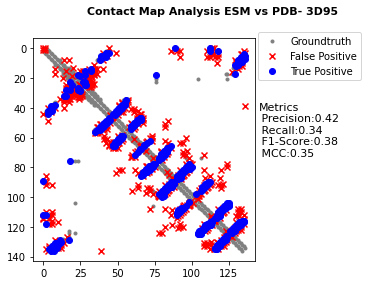

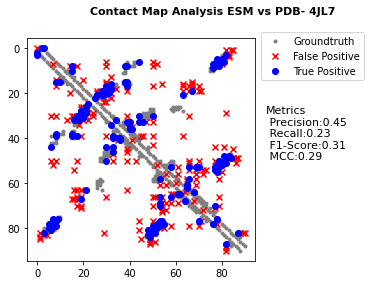

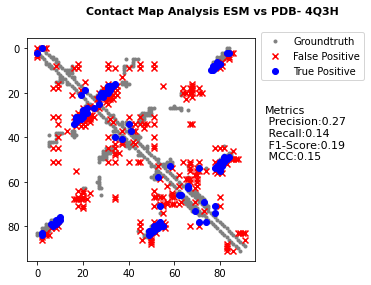

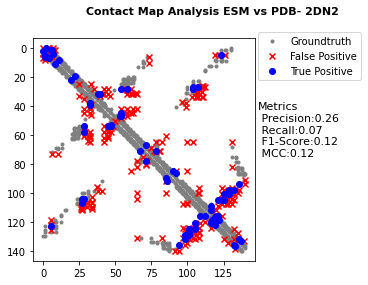

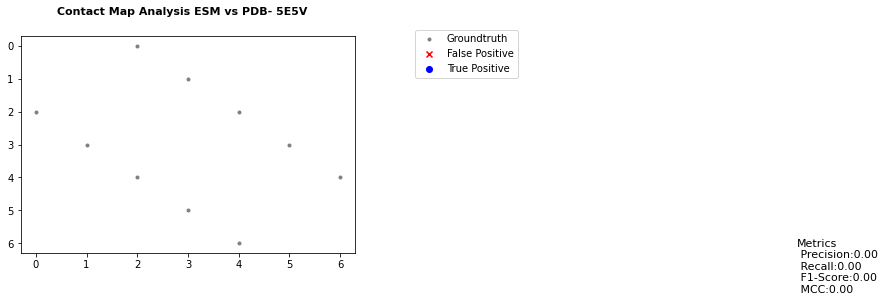

...

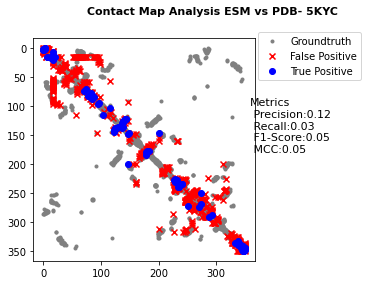

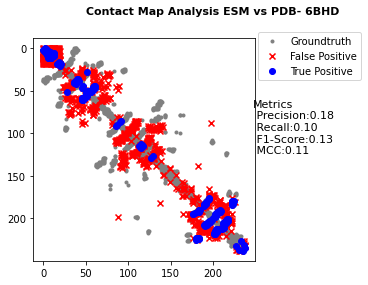

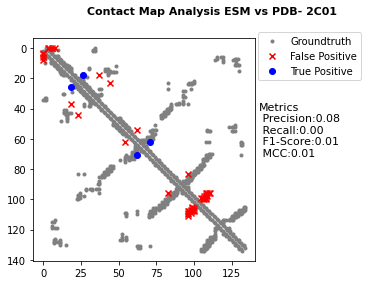

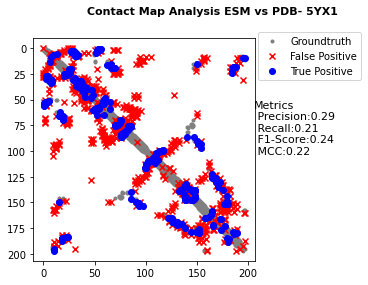

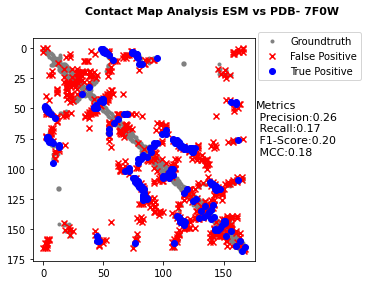

In [29]:
main7()

2D9Z
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
129
129 129
(16641,)
F1
0.1533546325878594
[0.         0.01953244 1.        ]
[0.         0.18604651 1.        ]
[2 1 0]
3D95
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
137
137 137
(18769,)
F1
0.19557195571955718
[0.         0.03806434 1.        ]
[0.         0.38686131 1.        ]
[2 1 0]
4JL7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
91
91 91
(8281,)
F1
0.19762845849802368
[0.         0.03383134 1.        ]
[0.         0.27472527 1.        ]
[2 1 0]
4Q3H
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


2DN3
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
1JWR
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
130
130 130
(16900,)
F1
0.09942638623326962
[0.         0.01424279 1.        ]
[0.  0.1 1. ]
[2 1 0]
2D5Z
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
7LHJ
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
166
166 166
(27556,)
F1
0.1915966386554622
[0.         0.02732883 1.        ]
[0.         0.34337349 1.        ]
[2 1 0]
1UZ3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
102
102 102
(10404,)
F1
0.025078369905956112
[0.         0.01088235 1.        ]
[0.         0.01960784 1.        ]
[2 1 0]
3NSO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
101
101 101
(10201,)
F1
0.00954653937947494
[0.         0.02150215 1.        ]
[0.         0.00990099 1.        ]
[2 1 0]
1OGA
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


2FRG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
106
106 106
(11236,)
F1
0.23529411764705882
[0.         0.03791727 1.        ]
[0.         0.39622642 1.        ]
[2 1 0]
1PA7
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
130
130 130
(16900,)
F1
0.09904761904761905
[0.         0.01436298 1.        ]
[0.  0.1 1. ]
[2 1 0]
6D0A
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
431
431 431
(185761,)
F1
0.14201183431952663
[0.         0.00892379 1.        ]
[0.         0.22273782 1.        ]
[2 1 0]
1J40


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
1J41


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
6ASH
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
215
215 215
(46225,)
F1
0.11251212415130941
[0.         0.01185719 1.        ]
[0.         0.13488372 1.        ]
[2 1 0]
4ZZ2
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
210
210 210
(44100,)
F1
0.07166556071665561
[0.         0.02364927 1.        ]
[0.         0.12857143 1.        ]
[2 1 0]
5PH2


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
364
364 364
(132496,)
F1
0.023104693140794223
[0.         0.00486461 1.        ]
[0.         0.02197802 1.        ]
[2 1 0]
5PHB


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
364
364 364
(132496,)
F1
0.025992779783393503
[0.         0.00484943 1.        ]
[0.         0.02472527 1.        ]
[2 1 0]
1EAX
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
241
241 241
(58081,)
F1
0.145791915175613
[0.         0.01592042 1.        ]
[0.         0.22821577 1.        ]
[2 1 0]
1XH3
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
276
276 276
(76176,)
F1
0.13165266106442577
[0.         0.01034063 1.        ]
[0.         0.17028986 1.        ]
[2 1 0]
1MF7
[[  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0. 191.   0.]
 [  0.   0.   0. ...   0.   0.   0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
260
260 260
(67600,)
F1
0.10661764705882353
[0.         0.00760286 1.        ]
[0.         0.11153846 1.        ]
[2 1 0]
5UGD
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
251
251 251
(63001,)
F1
0.049934296977660976
[0.         0.01571225 1.        ]
[0.         0.07569721 1.        ]
[2 1 0]
3TEM
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
228
228 228
(51984,)
F1
0.1426448736998514
[0.        0.0154091 1.       ]
[0.         0.21052632 1.        ]
[2 1 0]
1Z89
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0.

29 29
(841,)
F1
0.2366863905325444
[0.         0.11621967 1.        ]
[0.         0.34482759 1.        ]
[2 1 0]
4LDJ
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
170
170 170
(28900,)
F1
0.18518518518518517
[0.         0.02584034 1.        ]
[0.         0.32352941 1.        ]
[2 1 0]
3GHW
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
186
186 186
(34596,)
F1
0.17091207888249796
[0.         0.02165147 1.        ]
[0.         0.27956989 1.        ]
[2 1 0]
2RCT
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.15717092337917485
[0.        0.0334711 1.       ]
[0.         0.28368794 1.        ]
[2 1 0]

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
239
239 239
(57121,)
F1
0.04836759371221282
[0.         0.02005543 1.        ]
[0.         0.08368201 1.        ]
[2 1 0]
2C01
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
135
135 135
(18225,)
F1
0.012499999999999999
[0.         0.00267335 1.        ]
[0.         0.00740741 1.        ]
[2 1 0]
5YX1
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
198
198 198
(39204,)
F1
0.11030478955007256
[0.        0.0233457 1.       ]
[0.         0.19191919 1.        ]
[2 1 0]
7F0W
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[ 0.  0.  2. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0. 73.]
 [ 2.  0.  0. ...  0.  0.  0.]
 ...
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0. 73.  0. ...  0.  0.  0.]]
FASTA Length:
75
75 75
(5625,)
F1
0.05673758865248227
[0.        0.0226484 1.       ]
[0.         0.05333333 1.        ]
[2 1 0]
1LKK
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
105
105 105
(11025,)
F1
0.12526096033402923
[0.         0.02209894 1.        ]
[0.         0.14285714 1.        ]
[2 1 0]
3SXE


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
293
293 293
(85849,)
F1
0.09691629955947137
[0.         0.00832718 1.        ]
[0.         0.11262799 1.        ]
[2 1 0]
5JIQ
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
127
127 127
(16129,)
F1
0.022440392706872373
[0.         0.02840945 1.        ]
[0.         0.03149606 1.        ]
[2 1 0]
1IRD
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
3F00
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
198
198 198
(39204,)
F1
0.10152284263959391
[0.         0.02352608 1.        ]
[0.         0.17676768 1.        ]
[2 1 0]
2C9U
[[  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0. 149. 150.]
 ...
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0. 149. ...   0.   0.   0.]
 [  0.   0. 150. ...   0.   0.   0.]]
FASTA Length:
153
153 153
(23409,)
F1
0.15238095238095237
[0.         0.01614509 1.        ]
[0.         0.18300654 1.        ]
[2 1 0]
1K3Y
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
221
221 221
(48841,)
F1
0.1320890165111271
[0.        0.0177483 1.       ]
[0.        0.2081448 1.       ]
[2 1 0]
5WIQ
[[0. 0. 2. 0. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0. 

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
314
314 314
(98596,)
F1
0.12288135593220341
[0.         0.01167728 1.        ]
[0.         0.18471338 1.        ]
[2 1 0]
4HWW


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
314
314 314
(98596,)
F1
0.12076271186440679
[0.        0.0116977 1.       ]
[0.         0.18152866 1.        ]
[2 1 0]
2QUZ
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
166
166 166
(27556,)
F1
0.18604651162790697
[0.         0.02791654 1.        ]
[0.        0.3373494 1.       ]
[2 1 0]
6L1P
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
70
70 70
(4900,)
F1
0.13
[0.         0.04915966 1.        ]
[0.         0.18571429 1.        ]
[2 1 0]
6QUV
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ... 149.   0.   0.]
 [  0.   0.   0. ...   0. 149.   0.]
 ...
 [  0. 149.   0. ...   0.   0.   0.]
 [  0.   0. 149. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]]
FASTA Length:
153
153 153
(23409,)
F1
0.13966480446927376
[0.         0.01558239 1.        ]
[0.         0.16339869 1.        ]
[2 1 0]
4FGJ
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
233
233 233
(54289,)
F1
0.07293946024799416
[0.        0.0158854 1.       ]
[0.         0.10729614 1.        ]
[2 1 0]
5WXH
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
63
63 63
(3969,)
F1
0.1813031161473088
[0.         0.05074161 1.        ]
[0.         0.25396825 1.        ]
[2 1 0]
5WHP
[[0. 0. 2. 3. 0. 0.]
 [0. 0. 0. 2. 0. 0.]
 [2

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6 6
(36,)
F1
0.0
[0. 1.]
[0. 1.]
[1 0]
2OEI


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[ 0.  0.  2. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0. 36.]
 [ 2.  0.  0. ...  0.  0.  0.]
 ...
 [ 0.  0.  0. ...  0.  0.  2.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0. 36.  0. ...  2.  0.  0.]]
FASTA Length:
38
38 38
(1444,)
F1
0.251207729468599
[0.         0.07675439 1.        ]
[0.         0.34210526 1.        ]
[2 1 0]
3HJ2
[[ 0.  0.  2. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 2.  0.  0. ...  0.  0. 30.]
 ...
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0. 30. ...  0.  0.  0.]]
FASTA Length:
33
33 33
(1089,)
F1
0.2222222222222222
[0.         0.09188661 1.        ]
[0.        0.3030303 1.       ]
[2 1 0]
5WIA
[[0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]
 [2. 0. 0. 0. 2. 0.]
 [0. 2. 0. 0. 0. 2.]
 [0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]]
FASTA Length:
6
6 6
(36,)
F1
0.0
[0.         0.07142857 1.        ]
[0. 0. 1.]
[2 1 0]
6I0L


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
261
261 261
(68121,)
F1
0.033962264150943396
[0.         0.00769242 1.        ]
[0.         0.03448276 1.        ]
[2 1 0]
3EAC
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
106
106 106
(11236,)
F1
0.09034907597535935
[0.         0.02294993 1.        ]
[0.         0.10377358 1.        ]
[2 1 0]
6LUJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
66
66 66
(4356,)
F1
0.17297297297297298
[0.         0.04876894 1.        ]
[0.         0.24242424 1.        ]
[2 1 0]
1ZLM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
198
198 198
(39204,)
F1
0.12793176972281448
[0.         0.01242012 1.        ]
[0.         0.15151515 1.        ]
[2 1 0]
1F86
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
115
115 115
(13225,)
F1
0.1839080459770115
[0.         0.03093497 1.        ]
[0.         0.27826087 1.        ]
[2 1 0]
7NYG
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
236
236 236
(55696,)
F1
0.05336297943301834
[0.         0.02316022 1.        ]
[0.         0.10169492 1.        ]
[2 1 0]
7O6K
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
225
225 225
(50625,)
F1
0.05436893203883496
[0.         0.02098655 1.        ]
[0.         0.09333333 1.        ]
[2 1 0]
5NAT
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
232
232 232
(53824,)
F1
0.034031413612565446
[0.         0.01945277 1.        ]
[0.         0.05603448 1.        ]
[2 1 0]
4GOF
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
52
52 52
(2704,)
F1
0.12280701754385966
[0.         0.04230769 1.        ]
[0.         0.13461538 1.        ]
[2 1 0]
4GOE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


29 29
(841,)
F1
0.04878048780487805
[0.         0.02809706 1.        ]
[0.         0.03448276 1.        ]
[2 1 0]
6G0R
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
127
127 127
(16129,)
F1
0.1125703564727955
[0.         0.01568504 1.        ]
[0.         0.11811024 1.        ]
[2 1 0]
6V6V
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
183
183 183
(33489,)
F1
0.0727874276261373
[0.         0.02412221 1.        ]
[0.         0.12021858 1.        ]
[2 1 0]
5BQG
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
154
154 154
(23716,)
F1
0.03755868544600939
[0.         0.01362782 1.        ]
[0.         0.03896104 1.        ]
[2 1 

90 90
(8100,)
F1
0.06734006734006734
[0.        0.0135101 1.       ]
[0.         0.05555556 1.        ]
[2 1 0]
7LP1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
39
39 39
(1521,)
F1
0.15384615384615383
[0.         0.06237006 1.        ]
[0.         0.17948718 1.        ]
[2 1 0]
2X2A
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
165
165 165
(27225,)
F1
0.06998654104979811
[0.         0.01438929 1.        ]
[0.         0.07878788 1.        ]
[2 1 0]
4D3P
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
147
147 147
(21609,)
F1
0.16684045881126172
[0.         0.02744546 1.        ]
[0.         0.27210884 1.        ]
[2 1 0]
7

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
315
315 315
(99225,)
F1
0.09127516778523491
[0.         0.00803286 1.        ]
[0.         0.10793651 1.        ]
[2 1 0]
3H62


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
315
315 315
(99225,)
F1
0.09395973154362415
[0.         0.00801258 1.        ]
[0.         0.11111111 1.        ]
[2 1 0]
4O7A
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
127
127 127
(16129,)
F1
0.1125703564727955
[0.         0.01568504 1.        ]
[0.         0.11811024 1.        ]
[2 1 0]
7MLS
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
127
127 127
(16129,)
F1
0.09005628517823641
[0.         0.01606299 1.        ]
[0.         0.09448819 1.        ]
[2 1 0]
5LJB
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
198
198 198
(39204,)
F1
0.128068303094984
[0.         0.01239435 1.        ]
[0.         0.15151515 1.        ]
[2 1 0]
5B4O
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
114
114 114
(12996,)
F1
0.07865168539325842
[0.         0.03571429 1.        ]
[0.         0.12280702 1.        ]
[2 1 0]
2C4J
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
218
218 218
(47524,)
F1
0.06845238095238095
[0.         0.01830615 1.        ]
[0.         0.10550459 1.        ]
[2 1 0]
6C7E
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0

21 21
(441,)
F1
0.11320754716981132
[0.         0.14536341 1.        ]
[0.         0.14285714 1.        ]
[2 1 0]
2CN0
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
257
257 257
(66049,)
F1
0.06205559146735618
[0.         0.01503014 1.        ]
[0.         0.09338521 1.        ]
[2 1 0]
4NIB
[[ 0.  0.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.]
 [ 0.  0.  0.  2.  0.  0.  5.  0.  0.  0.  0.  0.  0.  0.  0. 14.  0.  0.
  17.  0.  0.]
 [ 2.  0.  0.  0.  0.  3.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.]
 [ 0.  2.  0.  0.  0.  0.  0.  4.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  2.  0.  0.  5.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.]
 [ 0.  0.  3.  0.  0.  0.  0.  2.  0.  0.  5.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.]
 [ 0.  5.  0.  0.  2.  0.  0.  0.  2.  0.  0.  0. 

236 236
(55696,)
F1
0.05780989438576986
[0.         0.02308779 1.        ]
[0.         0.11016949 1.        ]
[2 1 0]
6LCX


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
6LCW


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
6CEW
[[0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]
 [2. 0. 0. 0. 2. 0.]
 [0. 2. 0. 0. 0. 2.]
 [0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]]
FASTA Length:
6
6 6
(36,)
F1
0.0
[0.         0.07142857 1.        ]
[0. 0. 1.]
[2 1 0]


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


1OAI
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
59
59 59
(3481,)
F1
0.10526315789473685
[0.         0.03984538 1.        ]
[0.         0.11864407 1.        ]
[2 1 0]
6L5V
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
6KAO
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
6KAP
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
6KAI


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
6KAH


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
6KAE


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.0763888888888889
[0.         0.01387826 1.        ]
[0.         0.07801418 1.        ]
[2 1 0]
6CB9
[[0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]
 [2. 0. 0. 0. 2. 0.]
 [0. 2. 0. 0. 0. 2.]
 [0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]]
FASTA Length:
6
6 6
(36,)
F1
0.3333333333333333
[0.         0.07142857 1.        ]
[0.   0.25 1.  ]
[2 1 0]
6OD3


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
62
62 62
(3844,)
F1
0.027586206896551724
[0.         0.04354839 1.        ]
[0.         0.03225806 1.        ]
[2 1 0]
4QXX
[[0. 0. 2. 0. 0.]
 [0. 0. 0. 2. 0.]
 [2. 0. 0. 0. 2.]
 [0. 2. 0. 0. 0.]
 [0. 0. 2. 0. 0.]]
FASTA Length:
5
5 5
(25,)
F1
0.0
[0. 1.]
[0. 1.]
[1 0]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


7KSW
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
356
356 356
(126736,)
F1
0.014554275318374773
[0.         0.00733987 1.        ]
[0.         0.01685393 1.        ]
[2 1 0]
3D08
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
200
200 200
(40000,)
F1
0.03815580286168521
[0.        0.0054798 1.       ]
[0.   0.03 1.  ]
[2 1 0]
6BXX
[[0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]
 [2. 0. 0. 0. 2. 3.]
 [0. 2. 0. 0. 0. 2.]
 [0. 0. 2. 0. 0. 0.]
 [0. 0. 3. 2. 0. 0.]]
FASTA Length:
6
6 6
(36,)
F1
0.0
[0.         0.07692308 1.        ]
[0. 0. 1.]
[2 1 0]


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6BWZ
[[0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]
 [2. 0. 0. 0. 2. 0.]
 [0. 2. 0. 0. 0. 2.]
 [0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]]
FASTA Length:
6
6 6
(36,)
F1
0.0
[0.         0.14285714 1.        ]
[0. 0. 1.]
[2 1 0]
6BXV


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[0. 0. 2. 0. 0. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0. 0. 0.]
 [2. 0. 0. 0. 2. 0. 0. 0.]
 [0. 2. 0. 0. 0. 2. 0. 0.]
 [0. 0. 2. 0. 0. 0. 2. 0.]
 [0. 0. 0. 2. 0. 0. 0. 2.]
 [0. 0. 0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 0. 0. 2. 0. 0.]]
FASTA Length:
8
8 8
(64,)
F1
0.0
[0.         0.11538462 1.        ]
[0. 0. 1.]
[2 1 0]
5FW7


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
127
127 127
(16129,)
F1
0.02808988764044944
[0.         0.02822047 1.        ]
[0.         0.03937008 1.        ]
[2 1 0]
5E21
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
95
95 95
(9025,)
F1
0.19327731092436976
[0.         0.02716469 1.        ]
[0.         0.24210526 1.        ]
[2 1 0]
5ZGD
[[0. 0. 2. 3. 4. 5. 0. 0. 0.]
 [0. 0. 0. 0. 3. 0. 0. 0. 0.]
 [2. 0. 0. 0. 2. 0. 0. 0. 0.]
 [3. 0. 0. 0. 0. 0. 0. 0. 0.]
 [4. 3. 2. 0. 0. 0. 2. 0. 0.]
 [5. 0. 0. 0. 0. 0. 0. 2. 0.]
 [0. 0. 0. 0. 2. 0. 0. 0. 2.]
 [0. 0. 0. 0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 2. 0. 0.]]
FASTA Length:
9
9 9
(81,)
F1
0.0
[0.         0.04761905 1.        ]
[0. 0. 1.]
[2 1 0]
3SGP


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0.]
 [2. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0.]
 [0. 2. 0. 0. 0. 2. 0. 0. 0. 0. 0.]
 [0. 0. 2. 0. 0. 0. 2. 0. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 0. 2. 0. 0. 0. 2. 0. 0.]
 [0. 0. 0. 0. 0. 2. 0. 0. 0. 2. 0.]
 [0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 2.]
 [0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0.]]
FASTA Length:
11
11 11
(121,)
F1
0.0
[0.         0.25242718 1.        ]
[0. 0. 1.]
[2 1 0]
2KNT
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
58
58 58
(3364,)
F1
0.1273209549071618
[0.         0.07296798 1.        ]
[0.         0.20689655 1.        ]
[2 1 0]
3I35
[[ 0.  0.  2. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 2.  0.  0. ... 55.  0. 57.]
 ...
 [ 0.  0. 55. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0. 57. ...  0.  0.  0.]]
FASTA Length:
60
60 60


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6FUI
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
232
232 232
(53824,)
F1
0.0549738219895288
[0.         0.01915292 1.        ]
[0.         0.09051724 1.        ]
[2 1 0]
6OPL
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
205
205 205
(42025,)
F1
0.1645070422535211
[0.         0.02929232 1.        ]
[0.         0.35609756 1.        ]
[2 1 0]
1HDO
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
206
206 206
(42436,)
F1
0.15358554488989273
[0.         0.02910242 1.        ]
[0.         0.33009709 1.        ]
[2 1 0]
1HE2
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
134
134 134
(17956,)
F1
0.0
[0.         0.00559701 1.        ]
[0. 0. 1.]
[2 1 0]
1PSR


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
100
100 100
(10000,)
F1
0.07758620689655173
[0.         0.02510204 1.        ]
[0.   0.09 1.  ]
[2 1 0]
1HE4
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
206
206 206
(42436,)
F1
0.15584415584415584
[0.         0.02905483 1.        ]
[0.         0.33495146 1.        ]
[2 1 0]
1HMR
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
132
132 132
(17424,)
F1
0.19710144927536233
[0.         0.03898601 1.        ]
[0.         0.38636364 1.        ]
[2 1 0]
5TDR
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AL
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0. 191.]
 [  0.   0.   0. ...   0.   0.   0.]
 ...
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0. 191.   0. ...   0.   0.   0.]]
FASTA Length:
193
193 193
(37249,)
F1
0.13220338983050844
[0.         0.01942327 1.        ]
[0.         0.20207254 1.        ]
[2 1 0]
4NIO
[[0. 0. 2. 0. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0. 0.]
 [2. 0. 0. 0. 2. 0. 0.]
 [0. 2. 0. 0. 0. 2. 0.]
 [0. 0. 2. 0. 0. 0. 2.]
 [0. 0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 0. 2. 0. 0.]]
FASTA Length:
7
7 7
(49,)
F1
0.0
[0.         0.05128205 1.        ]
[0. 0. 1.]
[2 1 0]
6WQ7


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
260
260 260
(67600,)
F1
0.051470588235294115
[0.         0.00805009 1.        ]
[0.         0.05384615 1.        ]
[2 1 0]
6WQ5
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
260
260 260
(67600,)
F1
0.05514705882352941
[0.         0.00802027 1.        ]
[0.         0.05769231 1.        ]
[2 1 0]
6BSL
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
202
202 202
(40804,)
F1
0.09533678756476684
[0.         0.01274752 1.        ]
[0.         0.11386139 1.        ]
[2 1 0]
4A3P
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


4EPV
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
170
170 170
(28900,)
F1
0.1804255319148936
[0.         0.02552521 1.        ]
[0.         0.31176471 1.        ]
[2 1 0]
6UGO
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
257
257 257
(66049,)
F1
0.12076852698993595
[0.         0.00782788 1.        ]
[0.         0.12840467 1.        ]
[2 1 0]
6PQA
[[0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]
 [2. 0. 0. 0. 2. 0.]
 [0. 2. 0. 0. 0. 2.]
 [0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]]
FASTA Length:
6
6 6
(36,)
F1
0.3333333333333333
[0.         0.07142857 1.        ]
[0.   0.25 1.  ]
[2 1 0]
6AJZ


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
135
135 135
(18225,)
F1
0.05421686746987952
[0.         0.02094124 1.        ]
[0.         0.06666667 1.        ]
[2 1 0]
4CL9
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
127
127 127
(16129,)
F1
0.1125703564727955
[0.         0.01568504 1.        ]
[0.         0.11811024 1.        ]
[2 1 0]
6FVH
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
114
114 114
(12996,)
F1
0.10112359550561797
[0.         0.03508772 1.        ]
[0.         0.15789474 1.        ]
[2 1 0]
6UWX
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


4X9R
[[  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ... 233.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 ...
 [  0. 233.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]]
FASTA Length:
237
237 237
(56169,)
F1
0.017291066282420747
[0.         0.00384236 1.        ]
[0.         0.01265823 1.        ]
[2 1 0]
1T7H
[[ 0.  0.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 14.  0.  0.]
 [ 2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 15.]
 [ 0.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 13.  0.]
 [ 0.  0.  0.  0.  0.  0.  2.  0.  0.  5.  0.  0.  8.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  2.  0.  0.  0.  2.  0.  0.  0.  6.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  2.  0.  0.  0.  0.  3.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


3PZZ
[[0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]
 [2. 0. 0. 0. 2. 0.]
 [0. 2. 0. 0. 0. 2.]
 [0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]]
FASTA Length:
6
6 6
(36,)
F1
0.0
[0.         0.14285714 1.        ]
[0. 0. 1.]
[2 1 0]


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


3Q2X
[[0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]
 [2. 0. 0. 0. 2. 0.]
 [0. 2. 0. 0. 0. 2.]
 [0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0.]]
FASTA Length:
6
6 6
(36,)
F1
0.0
[0. 1.]
[0. 1.]
[1 0]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


7K3C
[[0. 0. 2. 0. 0. 0. 0.]
 [0. 0. 0. 2. 0. 0. 0.]
 [2. 0. 0. 0. 2. 0. 0.]
 [0. 2. 0. 0. 0. 2. 0.]
 [0. 0. 2. 0. 0. 0. 2.]
 [0. 0. 0. 2. 0. 0. 0.]
 [0. 0. 0. 0. 2. 0. 0.]]
FASTA Length:
7
7 7
(49,)
F1
0.0
[0.         0.05128205 1.        ]
[0. 0. 1.]
[2 1 0]


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_97847/4183556554.py:57: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


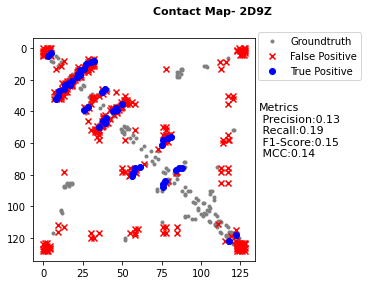

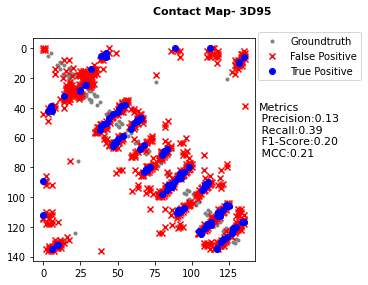

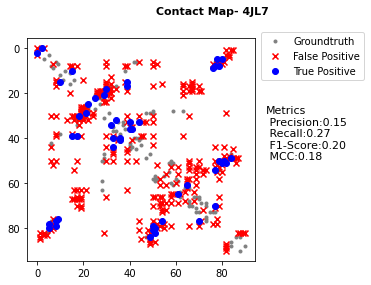

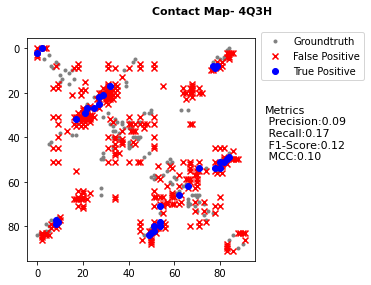

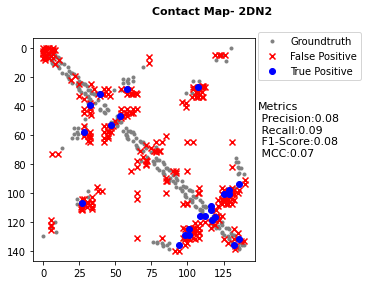

...

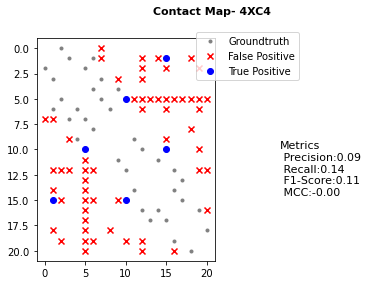

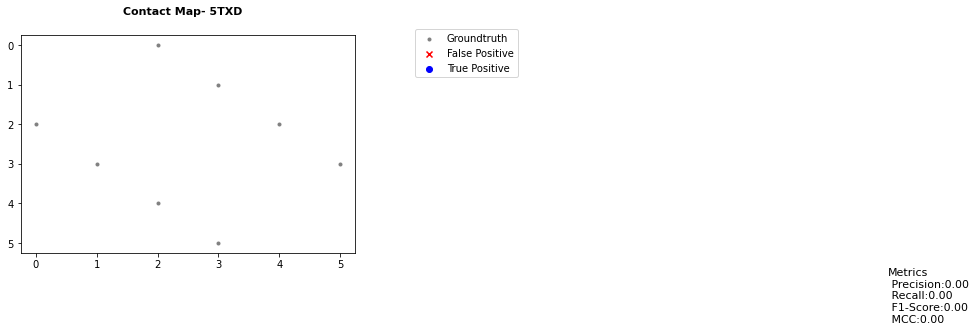

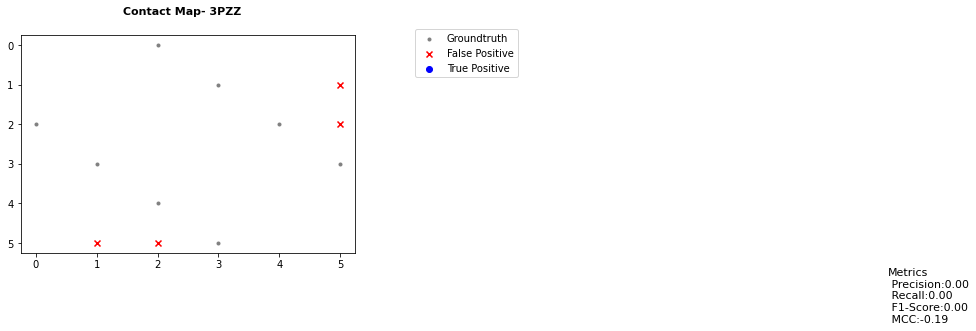

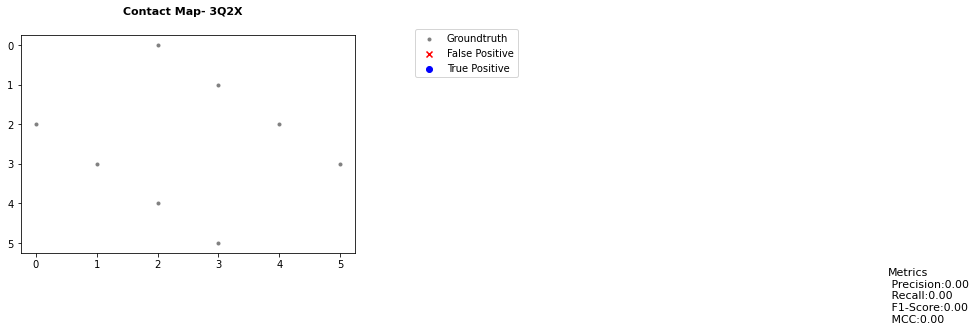

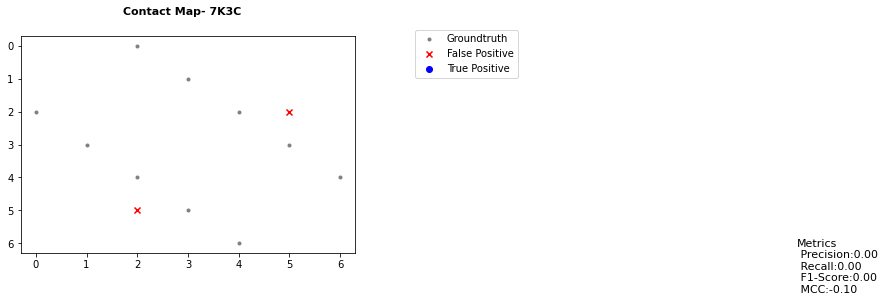

In [11]:
lis_pdbname,lis_prec,lis_recall,lis_f1,lis_mcc,lis_fpr,lis_tpr=main7a()

In [20]:
len(lis_pdbname)

315

In [21]:
lis_mcc

[0.139894223425816,
 0.20586929193426787,
 0.18215037923298733,
 0.09992720844525459,
 0.06988068319410089,
 0.0,
 0.06283263145564007,
 0.08527438649596705,
 0.06283263145564007,
 0.1811029757635018,
 0.1811029757635018,
 0.05759766776584467,
 0.05759766776584467,
 0.17649170275541248,
 0.055215961732041206,
 0.06345931545891792,
 0.11709446337780159,
 0.07730823179446242,
 0.1311296871832434,
 0.014290972345732235,
 0.014290972345732235,
 0.1985228344226021,
 0.011570962888813246,
 -0.011201424001681575,
 0.13006190845723495,
 0.18496297038888898,
 0.21627286470600296,
 0.08830213874839038,
 0.1812799540152815,
 0.1241358193278332,
 -0.02580486807610759,
 0.03506588001853135,
 0.23534742290690172,
 0.12601450046028936,
 -0.2182178902359924,
 0.2359732476942263,
 0.08483802266472812,
 0.1466557172574461,
 0.06283263145564007,
 0.06283263145564007,
 0.10425769606899736,
 0.06572317697553656,
 0.01800954015247577,
 0.02091662335225456,
 0.14613128616483498,
 0.1272424297020771,
 0.17987

In [22]:
mcc_dict=dict(zip(lis_pdbname, lis_mcc))

In [23]:
mcc_dict

{'2D9Z': 0.139894223425816,
 '3D95': 0.20586929193426787,
 '4JL7': 0.18215037923298733,
 '4Q3H': 0.09992720844525459,
 '2DN2': 0.06988068319410089,
 '5E5V': 0.0,
 '2DN3': 0.06283263145564007,
 '1JWR': 0.08527438649596705,
 '2D5Z': 0.06283263145564007,
 '7LHJ': 0.1811029757635018,
 '7LHO': 0.1811029757635018,
 '1FCX': 0.05759766776584467,
 '1FCZ': 0.05759766776584467,
 '1D4T': 0.17649170275541248,
 '7DY4': 0.055215961732041206,
 '7DY3': 0.06345931545891792,
 '2BNU': 0.11709446337780159,
 '5ZG2': 0.07730823179446242,
 '1HK0': 0.1311296871832434,
 '2QGB': 0.014290972345732235,
 '2QGC': 0.014290972345732235,
 '5P21': 0.1985228344226021,
 '1UZ3': 0.011570962888813246,
 '3NSO': -0.011201424001681575,
 '1OGA': 0.13006190845723495,
 '2VWR': 0.18496297038888898,
 '1MJN': 0.21627286470600296,
 '1NTE': 0.08830213874839038,
 '1QDD': 0.1812799540152815,
 '1X7Q': 0.1241358193278332,
 '6HK9': -0.02580486807610759,
 '1I71': 0.03506588001853135,
 '2ICC': 0.23534742290690172,
 '1WM3': 0.1260145004602893

In [24]:
sorted_mcc_dict=dict(sorted(mcc_dict.items(), key=lambda item: item[1]))

In [25]:
sorted_mcc_dict

{'3SGP': -0.2186968418511498,
 '5ZCK': -0.2182178902359924,
 '6ODG': -0.1889822365046136,
 '6BWZ': -0.1889822365046136,
 '3PZZ': -0.1889822365046136,
 '6BXV': -0.15450786078738143,
 '5WHP': -0.1504142093990467,
 '6BXX': -0.1504142093990467,
 '5WMJ': -0.12964074471043288,
 '5WIA': -0.12964074471043288,
 '6CEW': -0.12964074471043288,
 '6S6M': -0.12814947284335323,
 '5ZGD': -0.10482848367219184,
 '5WIQ': -0.10445609001327771,
 '4NIN': -0.10445609001327771,
 '4NIO': -0.10445609001327771,
 '7K3C': -0.10445609001327771,
 '6Q43': -0.04415862511680357,
 '6TKL': -0.038590196633953654,
 '6TKG': -0.038590196633953654,
 '5NHU': -0.038590196633953654,
 '6HK9': -0.02580486807610759,
 '1GK7': -0.017139394346361723,
 '4NYW': -0.016984110341722775,
 '6YIP': -0.01614306326193765,
 '3NSO': -0.011201424001681575,
 '6OD3': -0.009813609135853657,
 '4OWZ': -0.009165188050737204,
 '1K2A': -0.004583696193037557,
 '3TT8': -0.002088707062733586,
 '3W80': -0.002088707062733586,
 '2OMH': -0.002088707062733586,
 '5

In [26]:
for i in sorted_mcc_dict.keys():
    print(i)

3SGP
5ZCK
6ODG
6BWZ
3PZZ
6BXV
5WHP
6BXX
5WMJ
5WIA
6CEW
6S6M
5ZGD
5WIQ
4NIN
4NIO
7K3C
6Q43
6TKL
6TKG
5NHU
6HK9
1GK7
4NYW
6YIP
3NSO
6OD3
4OWZ
1K2A
3TT8
3W80
2OMH
5HRQ
3W7Z
4XC4
5E5V
6WPQ
5W50
4QXX
5ZMZ
5TXD
3Q2X
5JIQ
2X04
4R0U
7KSW
5FW7
4HIS
6PHO
2C01
1UZ3
4X9R
2QGB
2QGC
4UIT
3I35
4OUF
5PH2
3KZD
5O3H
5PHB
2YEX
5NAT
5BQG
6KB8
5KYC
6I0L
5O3E
5S7D
3D08
5UM3
5I86
6Q4K
1I71
5S7N
5S84
5S7H
3ZXF
7JUC
2R3R
6AJZ
7PUV
1I2T
1I1J
4HEY
6BHD
3MI2
5KDI
6J5S
4CY7
4EY1
4EYD
4NIB
5UGD
6C7E
6WQ7
3R4G
5KCO
5AHG
3F66
7NYG
7MS7
6FUI
6WQ5
6ALC
3EDG
3RDA
3RD9
6JJ5
6JJ6
2NLF
3FDO
7O6K
7NXS
6RHJ
7DY4
2CN0
2CF8
3R54
4A3P
5COY
5KTW
1PSR
1FCX
1FCZ
2X2A
5NZP
5B4O
2C4J
2DN3
2D5Z
1J40
1J41
1IRD
7JY3
6LCX
6LCW
6L5V
6KAO
6KAP
6KA9
6KAI
6KAH
6KAE
7DY3
6V6V
5TDR
4ZZ2
4FGJ
5I83
5A2M
2DN2
6BQA
1OAI
3EAC
6WQ8
5EKH
5EKM
7MLS
6KC4
6X3Y
5ZG2
7NZK
2HXM
5I7Y
2NLE
1PA7
4GOF
4GOE
3DJH
6FVH
6L1S
1JWR
1JSF
3H61
6BSL
1OGW
6CJ2
3GA3
1NTE
3H62
4PQD
3SXE
2KNT
6LVQ
5J0F
5GOB
4MTC
1T7H
7L9M
7AJN
6G0R
6FT4
4O7A
6XUZ
6XV3
4CL9
6UWX
6UVJ
2CVD


In [27]:
lis_sorted_mcc= list(sorted_mcc_dict.keys())

In [28]:
every_fifteenth_element =lis_sorted_mcc[::15]

In [29]:
every_fifteenth_element

['3SGP',
 '4NIO',
 '3W80',
 '7KSW',
 '5PHB',
 '5S84',
 '4EY1',
 '3EDG',
 '5COY',
 '6LCX',
 '5A2M',
 '2NLE',
 '3H62',
 '6XV3',
 '2NLD',
 '4HXQ',
 '1OGA',
 '6LUJ',
 '1HDO',
 '1QDD',
 '2CE2']

In [30]:
import matplotlib.image as mpimg

In [ ]:
img = mpimg.imread('my_image.png')

In [32]:
img = mpimg.imread('/Users/rohan/Desktop/contact_map_analysis/contacts_only1/1CTQ.png')
img

FileNotFoundError: [Errno 2] No such file or directory: '/Users/rohan/Desktop/contact_map_analysis/contacts_only1/1CTQ.png'

In [26]:
from PIL import Image
import glob
image_list = []


In [33]:
for i in every_fifteenth_element:
    filename="/Users/rohan/Desktop/contact_map_analysis/contacts_only/"+str(i)+".pdf"
    im=Image.open(filename)
    image_list.append(im)

UnidentifiedImageError: cannot identify image file '/Users/rohan/Desktop/contact_map_analysis/contacts_only/3SGP.pdf'

In [25]:
image_list

[]

In [12]:
def main4():
    #PDB_IDs = ['2D9Z']
    PDB_IDs = pdb_list1
    #Load ESM_1b Model
    esm1b,esm1b_batch_converter=load_ESM_1b()
    #Set the path to results
    results_path="/Users/rohan/Desktop/contact_map_analysis/contacts9/" 
    lis_pdbname=[]
    lis_prec=[]
    lis_recall=[]
    lis_f1=[]
    lis_mcc=[]
    lis_fpr=[]
    lis_tpr=[]
    for i,j in enumerate(PDB_IDs):
        print(PDB_IDs[i])
        PDB_IDs_lower = str(PDB_IDs[i]).lower()
        #Set path to PDB files
        PDB_file = f'//Users/rohan/Desktop/contact_map_analysis/data_main/pdb_files1/pdb{PDB_IDs_lower}.ent' 
        #Set path to FASTA files
        fasta_file=f'//Users/rohan/Desktop/contact_map_analysis/data_main/fasta_files1/{PDB_IDs[i]}_1.fasta'
        if os.path.isfile(PDB_file) and os.path.isfile(fasta_file):
            contact_pdb=getContactMap_fromPDB(PDB_file)
            fasta_data = [read_sequence(fasta_file),]
            if len(fasta_data[0][1])<1024:
                print("FASTA Length:")
                print(len(fasta_data[0][1]))
                contact_esm=getContactMap_fromESM(esm1b,esm1b_batch_converter,fasta_file)
            else:
                print("Fasta sequence>1024")
                continue
        if (contact_pdb is not None) and (contact_pdb.shape[0]==contact_esm.shape[0]):
            prec,recall,f1,mcc,fpr,tpr=compareContactMaps_Difference4(contact_pdb,contact_esm,PDB_IDs[i],results_path)
            lis_pdbname.append(PDB_IDs[i])
            lis_prec.append(prec)
            lis_recall.append(recall)
            lis_f1.append(f1)
            lis_mcc.append(mcc)
            lis_fpr.append(fpr)
            lis_tpr.append(tpr)
        else: 
            continue
    return lis_pdbname,lis_prec,lis_recall,lis_f1,lis_mcc,lis_fpr,lis_tpr

In [ ]:
6NW7

2G7B


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
137
2FS6
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
137
3D95
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
137
137 137
(18769,)
F1
0.3758241758241759
[0.         0.02635284 1.        ]
[0.         0.33861386 1.        ]
[2 1 0]
7D0E
137 137
(18769,)
F1
0.3758241758241759
[0.         0.02635284 1.        ]
[0.         0.33861386 1.        ]
[2 1 0]
2FR3
137 137
(18769,)
F1
0.3758241758241759
[0.         0.02635284 1.        ]
[0.         0.33861386 1.        ]
[2 1 0]
7Q9Q
137 137
(18769,)
F1
0.3758241758241759
[0.         0.02635284 1.        ]
[0.         0.33861386 1.   

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
138
2AEB


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
322
4JL7
4Q3H
5CFA
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
331
1NKO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
132
3RFE
6ISM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
196
6ITA
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
196
3IQJ
3K05
3SPV
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


6TT2
7 7
(49,)
F1
0.0
[0. 1.]
[0. 1.]
[1 0]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


5DZO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
107
1IE9
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
259
6JOZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
275
7KGQ


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
278
7KGP
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
278
1OGT


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
3A40
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
263
2DN3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.11729323308270677
[0.         0.01146193 1.        ]
[0.         0.07528958 1.        ]
[2 1 0]
5IB2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
5YD4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Leng

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


2NW2
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
200
6YPE


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AS
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
205
7BRQ
2UWR
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
79
6FR5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
202
6EH4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
204
6EH5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
202
1OBX
1FD0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


4YUD
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
92
2EAQ
[[ 0.  0.  2. ...  0. 87.  0.]
 [ 0.  0.  0. ... 85. 86. 87.]
 [ 2.  0.  0. ... 84. 85. 86.]
 ...
 [ 0. 85. 84. ...  0.  0.  2.]
 [87. 86. 85. ...  0.  0.  0.]
 [ 0. 87. 86. ...  2.  0.  0.]]
FASTA Length:
90


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


1JWR
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
130
130 130
(16900,)
F1
0.15592680986475735
[0.         0.01037344 1.        ]
[0.         0.09859155 1.        ]
[2 1 0]
2DN1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
2D5Z
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.12139605462822459
[0.         0.01134857 1.        ]
[0.       0.078125 1.      ]
[2 1 0]
4WW1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
207
6EEY
[[ 0.  0.  2. ...  0.  0.  0.]
 [ 0.  0.  0. ... 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


3R0N
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
128
6B8G
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
182
3US5
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
118
1LF7
6EGE
5PYW
5PXB
5PXA
5PXL
5PY5
5PXT
5PXS
5PXN
5PWG
5PWF
5PX4
5PWS
5PX2
5PWR
5PX6
5PWU
4GSV


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
322
4GRZ
1D4T
7DY4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.11746987951807229
[0.         0.01167047 1.        ]
[0.         0.07572816 1.        ]
[2 1 0]
7DY3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.1148036253776435
[0.         0.01135459 1.        ]
[0.         0.07350097 1.        ]
[2 1 0]
3NZL
[[ 0.  0.  2. ...  0.  0.  0.]
 [ 0.  0.  0. ... 69. 70.  0.]
 [ 2.  0.  0. ...  0. 69.  0.]
 ...
 [ 0. 69.  0. ...  0.  0.  2.]
 [ 0. 70. 69. ...  0.  0.  0.]
 [ 0.  0.  0. ...  2.  0.  0.]]
FASTA Length:
83


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


4RMT
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
100
4RMQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
100
2ZNR


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: PR
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
178
1OKI
1H4A
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
173
6RQU
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
256
5AUL
6B8F
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
182
2BNU
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
203
203 203
(41209,)
F1
0.28497600590623845
[0.         0.02052845 1.        ]
[0.         0.25596817 1.

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_48981/4063245157.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 9))


2QGC
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
127
127 127
(16129,)
F1
0.08067664281067013
[0.         0.02637698 1.        ]
[0.         0.05751391 1.        ]
[2 1 0]
2QGE
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
127
5L0S
3G36
5P21
1K5N
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
6EW4
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
133
3CZF
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


1XOZ
6MS1
[[ 0.  0.  2. ...  0. 94.  0.]
 [ 0.  0.  0. ... 92. 93. 94.]
 [ 2.  0.  0. ... 91. 92. 93.]
 ...
 [ 0. 92. 91. ...  0.  0.  2.]
 [94. 93. 92. ...  0.  0.  0.]
 [ 0. 94. 93. ...  2.  0.  0.]]
FASTA Length:
94
6DN7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
229
5FFV
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
116
3AJ4
1UZ3
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
102
102 102
(10404,)
F1
0.031128404669260697
[0.         0.01056627 1.        ]
[0.         0.01829268 1.        ]
[2 1 0]
4F3J
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0.

275 275
(75625,)
F1
0.2397003745318352
[0.         0.00719053 1.        ]
[0.         0.17120623 1.        ]
[2 1 0]
5PG1
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
138
2XZC
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
222
4N7I
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
190
6FZL
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
127
6FXU
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
227
6PYJ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
276
1I71
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
83
83 83
(6889,)
F1
0.09574468085106383
[0.         0.01437011 1.        ]
[0.         0.05750799 1.        ]
[2 1 0]
1SR7
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
259
6Y1J
5FAZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Len

5PTN
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5PTM
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5PTK
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5PTT
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5PTS
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
156
5PT0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0.

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


6FNK
6FNL
6FNI
6FNJ
6AC0
1T3Y
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
2HXS
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
178
3MAO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
105
5DK8
2RCQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
2FRG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
106
106 106
(11236,)
F1
0.43251533742331294
[0.         0.02108491 1.        ]


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.11532625189681336
[0.         0.01156069 1.        ]
[0.         0.07421875 1.        ]
[2 1 0]
1J41


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
141
141 141
(19881,)
F1
0.11782477341389729
[0.         0.01145828 1.        ]
[0.         0.07572816 1.        ]
[2 1 0]
6GBI
141 141
(19881,)
F1
0.11782477341389729
[0.         0.01145828 1.        ]
[0.         0.07572816 1.        ]
[2 1 0]
6EXY
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
139


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


3WAR
6MV4
5LLC
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
260
5LLG
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
260
4EO7
4RRV
5AJO
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
571
3HNB
[[  0.   0.   2. ...   0.   0.   0.]
 [  0.   0.   0. ... 174.   0.   0.]
 [  2.   0.   0. ... 173.   0.   0.]
 ...
 [  0. 174. 173. ...   0.   0.   2.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   2.   0.   0.]]
FASTA Length:
159
3HNY
[[  0.   0.   2. ...   0.   0.   0.]
 [  0.   0.   0. ... 166.   0.   0.]
 [  2.   0.   0. ... 165.   0.   0.]
 ...
 [  0. 166. 165. ...   0.   0.   2.]
 [  0.   0.   0. ...   0.   0.   0

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
195
3S8S
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
110


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


4L7X
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
63
6L0O
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
81
5BT5
[[  0.   0.   2. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  2.   0.   0. ...   0. 111.   0.]
 ...
 [  0.   0.   0. ...   0.   0.   2.]
 [  0.   0. 111. ...   0.   0.   0.]
 [  0.   0.   0. ...   2.   0.   0.]]
FASTA Length:
114
5HFQ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
114
5HEL
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
126
6I80
[[0. 0. 2. ... 0. 0. 0.]
 [0. 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
407
5EQ0
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
55
5TDB
[[ 0.  0.  2. ...  0. 70.  0.]
 [ 0.  0.  0. ...  0. 69.  0.]
 [ 2.  0.  0. ...  0.  0.  0.]
 ...
 [ 0.  0.  0. ...  0.  0.  2.]
 [70. 69.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  2.  0.  0.]]
FASTA Length:
76
5PNW


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PNU
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PMY
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PMZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PN8
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
364
5PMW
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]


3I6C
5LO5
6GQS
6GR5
6GPO
6TN5
6TN4
4TNS
3TC5
6F78
1C5L
5I29
3P17
2CF8
6GBW
5JZY
6ROT
2ZFF
3U98
5NHU
6I51
7AC9
6T52
6T3M
6YSX
6YSJ
6YN3
6YMP
6YHJ
6YB6
6Y9H
4PWQ
5MYX
4PQD
6VIG
6YOJ
2J30
2J32
6O5I
7OFV
3U8R
3U8O
6SJA
3GP2
6RWU
6WBW
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
376
6WBZ
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
FASTA Length:
376
6JD8
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
360
6YIP
6AX4
4R0U
5KL3
6TS3
7NUS
6Q9L
6Q9O
5UL6
4X9V
4X9R
3EXX
1T7H
6VER
5USV
5UU2
5URT
5USP
5UOZ
4ZZN
4QTA
6SLG
5WP1
4QTB
4RMI
4RMH
4O6W
4U1P
3W7Z
6GV0
4XC4
6S34
4AJX
4FKA
5C4M
5NJ9
5NJA
4YJR
4YJQ
6ZCS
5G0C
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 

IndexError: index 220 is out of bounds for axis 1 with size 167

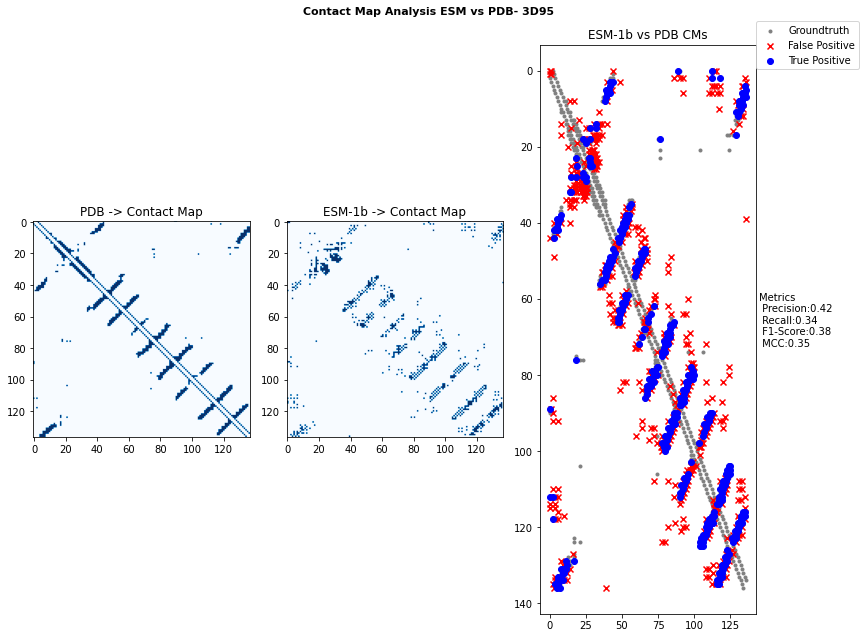

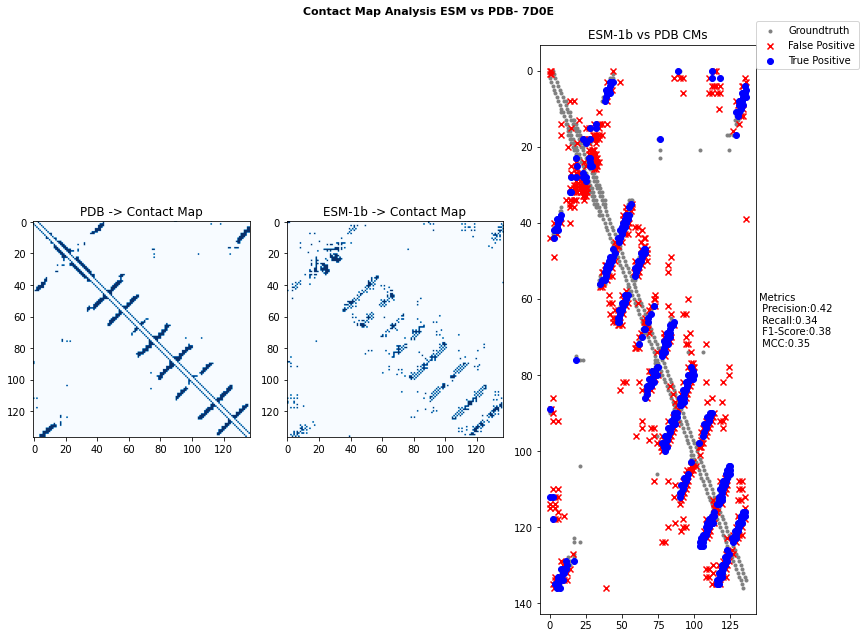

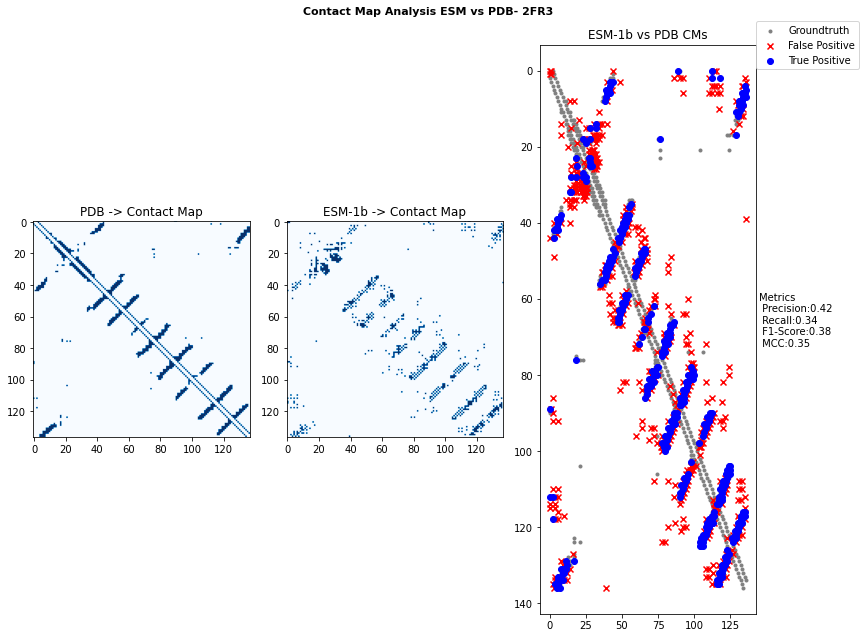

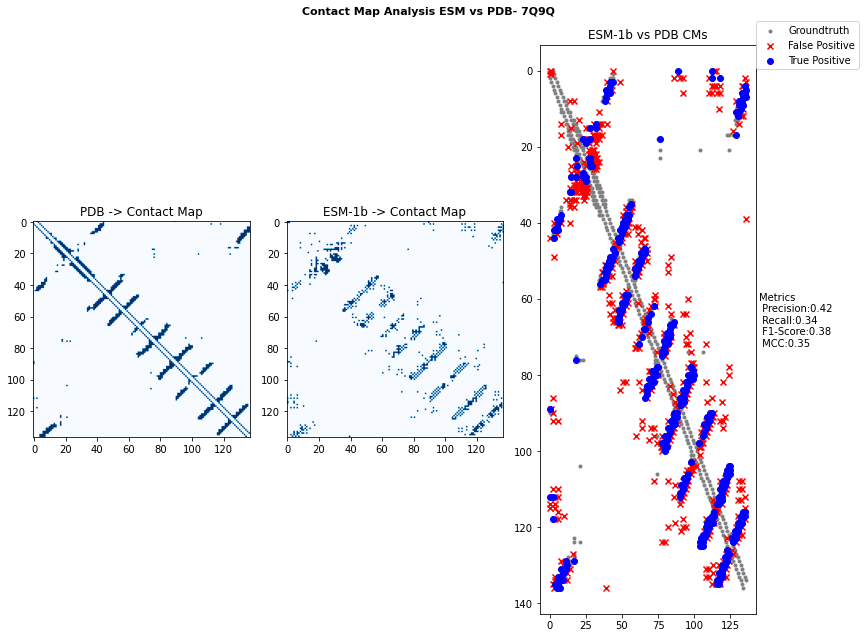

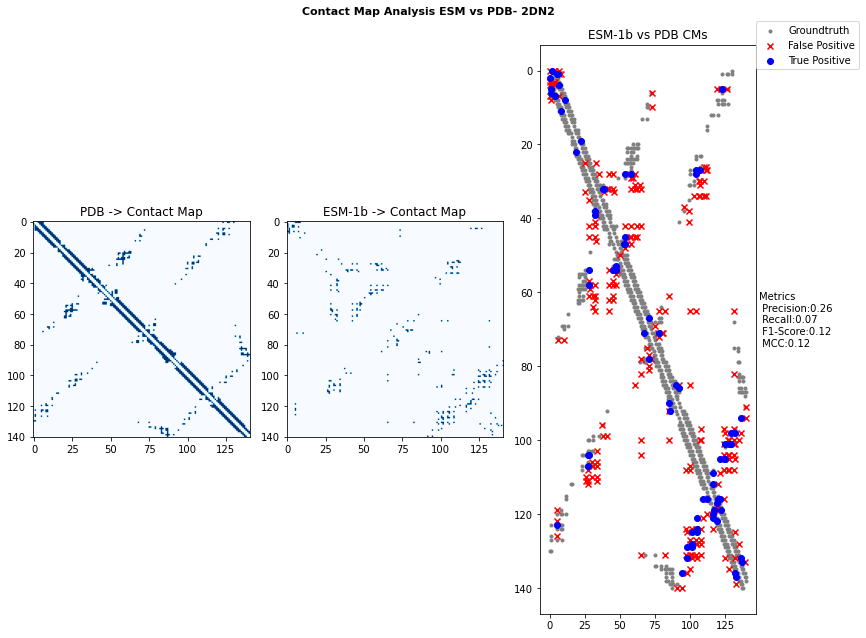

...

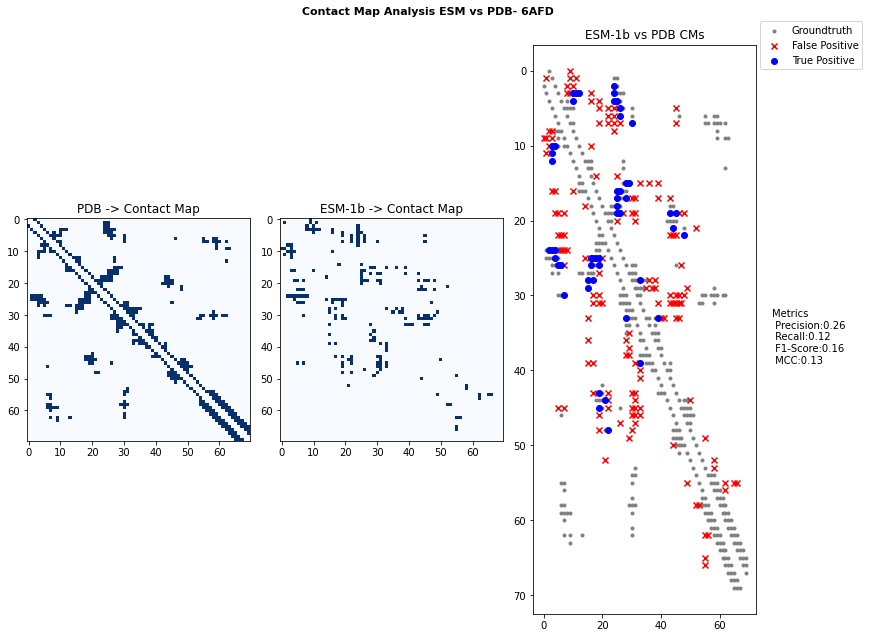

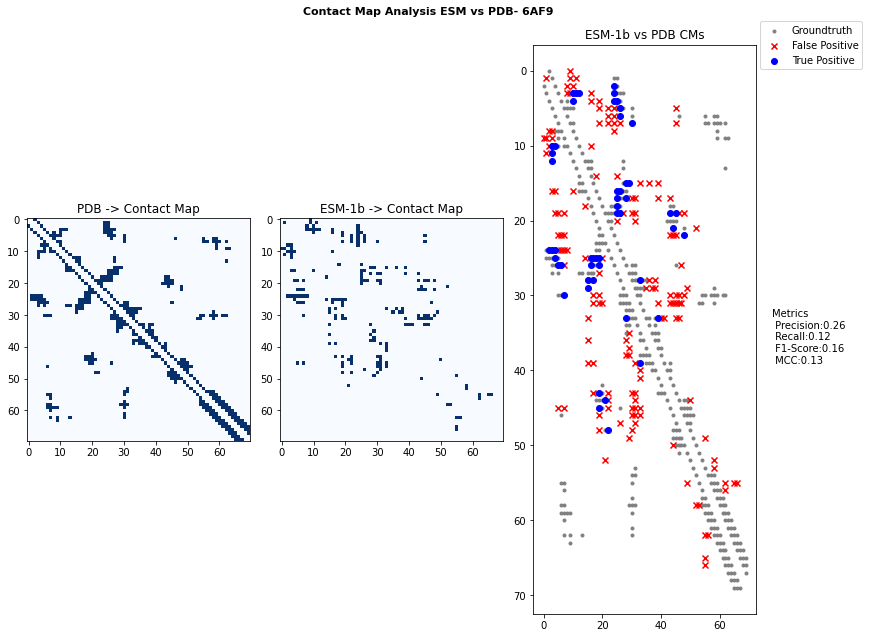

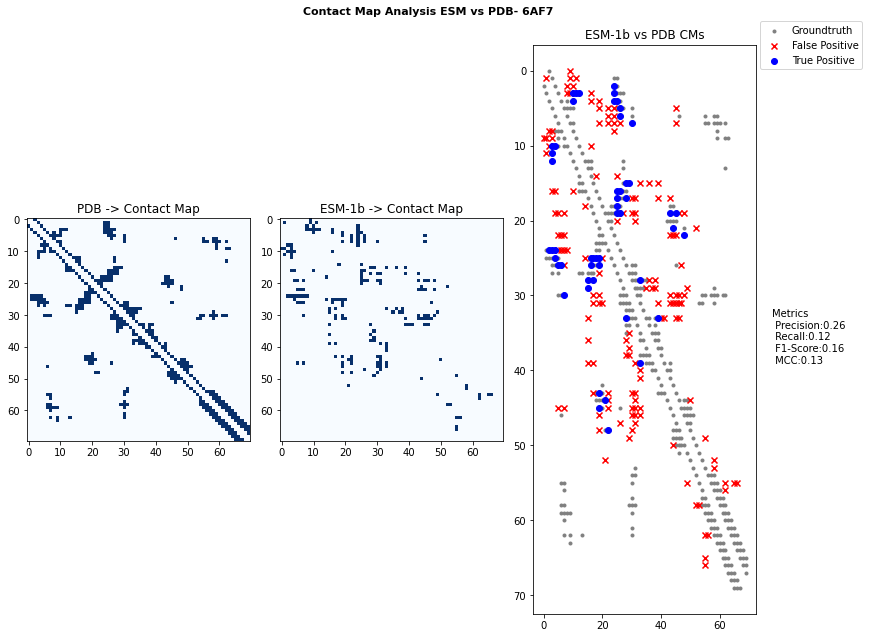

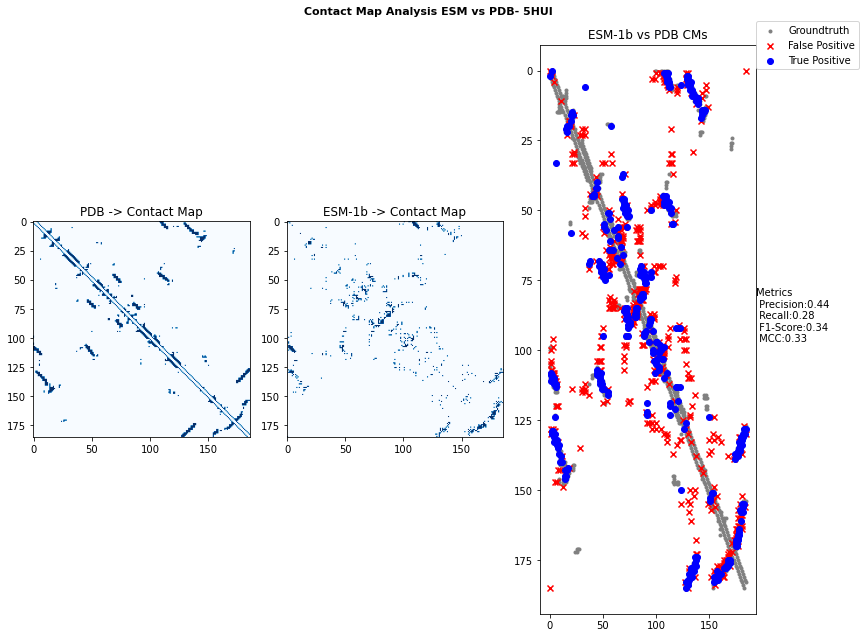

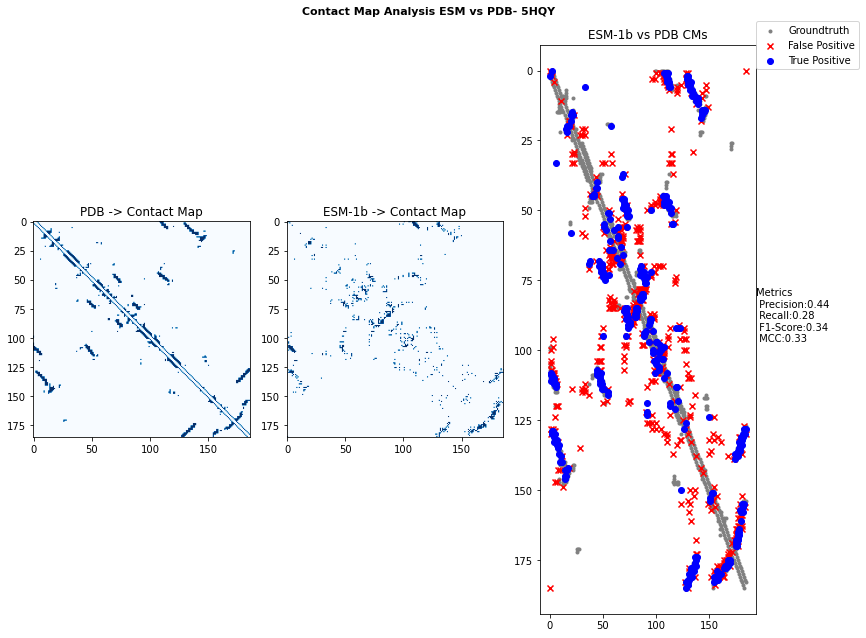

In [13]:
lis_pdbname,lis_prec,lis_recall,lis_f1,lis_mcc,lis_fpr,lis_tpr=main4()
print(lis_pdbname)
print(lis_mcc)
print(lis_tpr)

In [25]:
lis_mcc

[0.2555843906213753,
 0.258819080350597,
 0.01766886659420748,
 0.1962033817247376,
 0.09131136576380539,
 0.050642703777559,
 0.3168429475565571,
 0.30338253495344913,
 0.19701761256432077,
 0.11174686974259918,
 0.13264698405713443,
 -0.2182178902359924,
 0.12153099542237943,
 0.27699973031626335,
 0.15462558060033021,
 0.25139295018446955,
 -0.003035332139851956,
 0.2437602402415012,
 0.2801448799702117,
 0.08224226663904052,
 0.2840653878028548,
 0.24622589572684828,
 0.34085071753476165,
 0.2740248815264403,
 0.12783527664355332,
 0.0987790465218959,
 -0.09628688254509728,
 -0.10074482397180604,
 0.2086835121409068,
 0.212674637305575,
 0.18540107518236462,
 0.3156615625961563,
 0.24553009326617872,
 0.12087198336860727,
 0.12020005957291507,
 0.2938772124128937,
 -0.08242721540254713,
 0.11279639639495406,
 0.20474229488262377,
 0.0930911107675289,
 0.10001196109626144,
 0.2240704565049582,
 0.09884517967975706,
 0.07854487673552302,
 0.17673769206050127,
 0.247042375496735,
 0.2

In [47]:
np.median(lis_mcc)

0.11998048750908512

In [16]:
len(lis_pdbname)

314

In [46]:
np.array(lis_fpr)

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_4284/540401810.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array(lis_fpr)


array([array([0.        , 0.03216762, 1.        ]),
       array([0.        , 0.02320614, 1.        ]),
       array([0.        , 0.00581024, 1.        ]),
       array([0.        , 0.02712777, 1.        ]),
       array([0.        , 0.01637255, 1.        ]),
       array([0.        , 0.03471225, 1.        ]),
       array([0.        , 0.02697907, 1.        ]),
       array([0.        , 0.02864742, 1.        ]),
       array([0.        , 0.03281875, 1.        ]),
       array([0.        , 0.02934407, 1.        ]),
       array([0.        , 0.02286575, 1.        ]),
       array([0.        , 0.16666667, 1.        ]),
       array([0.        , 0.02327411, 1.        ]),
       array([0.        , 0.03371227, 1.        ]),
       array([0.       , 0.0447092, 1.       ]),
       array([0.        , 0.03401693, 1.        ]),
       array([0.        , 0.04432888, 1.        ]),
       array([0.        , 0.02979171, 1.        ]),
       array([0.        , 0.05356018, 1.        ]),
       array([0

In [31]:
query_res1="2G7B,2FS6,3D95,7D0E,2FR3,7Q9Q,5O9M,3IU1,6FR3,1SMO,4PZ3,1YPQ,5N86,4N6X,6QRN,6FR4,4O8I,5ML3,5EMA,5GJH,6YA6,4JV8,4AL0,4R0X,4MPA,4LMM,3MRK,1D1Z,2YXF,3WA4,6TSE,5V1Y,3FSO,2J8B,4L0N,4P0C,5Y45,6AT6,2H2T,5Y46,6EYM,2AEB,4JL7,4Q3H,5CFA,1NKO,3RFE,6ISM,6ITA,3IQJ,3K05,3SPV,3NFK,5YD3,4GXV,2DN2,6TDP,3MRB,3ICH,3IQV,3IQU,5E5V,6TT2,5DZO,1IE9,6JOZ,7KGQ,7KGP,1OGT,3A40,2DN3,5IB2,5YD4,6F2Q,2NW2,6YPE,7BRQ,2UWR,6FR5,6EH4,6EH5,1OBX,1FD0,7E0B,4N19,4DND,4YUD,2EAQ,1JWR,2DN1,2D5Z,4WW1,6EEY,5LXI,3FQ4,3EY6,3I4W,1XPH,7LHJ,7LHO,6AQ1,6GKS,6TCR,4RAH,6LAN,4UDT,4RFZ,3TV3,6Y26,6Y27,6Y29,6Y2B,6Y2A,1FCX,1FCY,1FCZ,3UE2,3R0N,6B8G,3US5,1LF7,6EGE,5PYW,5PXB,5PXA,5PXL,5PY5,5PXT,5PXS,5PXN,5PWG,5PWF,5PX4,5PWS,5PX2,5PWR,5PX6,5PWU,4GSV,4GRZ,1D4T,7DY4,7DY3,3NZL,4RMT,4RMQ,2ZNR,1OKI,1H4A,6RQU,5AUL,6B8F,2BNU,3O46,5ZG1,5ZG2,4IEJ,5C0E,5N1Y,3CN4,4YEP,1M9Z,1IWX,1IWY,1IWZ,1IWT,1IWU,1IWV,1IWW,7NDY,6R9U,6R8O,6R8W,1HK0,3ESP,3ESO,3ESN,1TBF,4P5Q,3CJW,6PUV,6ETC,6RQW,6RQQ,4N7U,2A83,2QGB,2QGC,2QGE,5L0S,3G36,5P21,1K5N,6EW4,3CZF,1K8U,1XOZ,6MS1,6DN7,5FFV,3AJ4,1UZ3,4F3J,3NSO,3WH2,3WH3,1PWA,1OGA,5L0T,5LLP,5MSB,6TRN,5LXX,6B8K,2AKZ,3IB4,2PIE,6FBB,1SQN,5P9K,1SG4,3IMW,3IMV,3IMU,3IMT,3IMS,5HKJ,7BQI,5DWP,3O5P,3O5O,3O5L,1XD3,2VWR,4PQW,6FCP,6HMT,1K96,6V7S,6V7Q,6UYZ,1MJN,4WJQ,7AEW,6HYO,4XOF,7EV1,5C0F,1NTE,6Y8E,4H2Z,4GH0,1QDD,6B9X,1X7Q,5PG1,2XZC,4N7I,6FZL,6FXU,6HK9,3CR6,2CB8,5LJG,2XR6,4IN0,6TX7,6TX5,6TX4,6G6K,2Q3G,6UMU,6UMV,6TX9,6TX8,5W2F,6L9O,4QPN,6PYJ,1I71,1SR7,6Y1J,5FAZ,5F7G,5F6B,6O5W,5MR1,6DCM,6SW3,5LF9,2QG1,4WLH,2CAR,5O6H,2V89,3JVE,3GIX,2ILI,4QGX,2ICC,7LIN,4CAY,1WM3,2B69,5BOW,5ZCK,7KQL,3KHF,2FZD,6TGK,3PE6,3KUJ,3BQP,5IO9,4YDP,3O2T,5EV9,5EVA,5ETD,5ETB,5EPS,5EM3,6ZBK,4FH0,2GBJ,6Z1V,5PVT,5PV3,5PUZ,5PV8,5PTF,5PTG,5PTQ,5PTN,5PTM,5PTK,5PTT,5PTS,5PT0,5PSN,5PSK,5PSL,5PSJ,5PT9,5PST,5PSQ,5PRP,5PPX,5PPY,5PPW,5PQC,5PQI,5PPE,5PPB,5PQ2,4BB9,3M9J,5POU,5PNX,5PNY,5PO5,5POC,5POO,5PO4,5PO0,6W2G,3CZT,5VEI,6FNK,6FNL,6FNI,6FNJ,6AC0,1T3Y,2HXS,3MAO,5DK8,2RCQ,2FRG,5XN3,1PA7,3EYI,6HAR,4TXR,4JFI,6VB2,7JX5,4NUA,4NKE,6MEE,3S92,2HQX,6VJJ,2FE5,6PYV,6PYW,6G9Z,5O8I,5WLV,7CIO,3RZN,3O3U,6A66,6MEG,6R6Y,4C45,2FZ8,2P02,6D0A,6YZH,6Z19,4HCV,4HCU,4HCT,3LNY,5WL1,1WMS,1J40,1J41,6GBI,6EXY,3WAR,6MV4,5LLC,5LLG,4EO7,4RRV,5AJO,3HNB,3HNY,2VXV,2JIK,6ASH,1X3S,3S8S,4L7X,6L0O,5BT5,5HFQ,5HEL,6I80,7JGW,3VWD,4JZQ,4K0G,4K0N,4ZZ1,4ZZ2,7M3X,5EQ0,5TDB,5PNW,5PNU,5PMY,5PMZ,5PN8,5PMW,5PN9,5PMX,5PN6,5PMU,5PN7,5PMV,5PN4,5PMS,5PN5,5PMT,5PNB,5PNC,5PNJ,5PNK,5PNH,5PNI,5PNF,5PNG,5PND,5PNE,5PNR,5PNS,5PNP,5PNQ,5PNN,5PNL,5PNM,5PLX,,4UIY,4CL9,6DL2,6SWN,6Z7M,6FVH,6FVE,4Q6S,6UWX,6UVJ,4UYD,6GQZ,6TKK,4GRR,5LJ2,6G0D,6FNX,4WHW,5XI4,6JJ5,6JJ6,7JKY,7JKX,7JKW,7A9U,7P6W,7P6V,7M16,4A7V,4A7T,4A7S,4A7G,4A7Q,2WYT,6Z3V,6Z4G,6Z4O,6Z4K,4P2K,5O3Y,5YVN,3CBZ,5FMI,2YI7,4AOH,5M9R,6T5B,6T5V,6U4W,6U4U,5OQ5,6QXU,7S5H,2F69,4PZZ,4Q03,2AGT,3T42,6T7Q,6T5G,6T27,1GZ8,6ALC,5I8G,4PUW,3LZ3,3LQL,3LD5,3LBO,3K0N,3K0M,6AY3,6AXQ,5W0E,6F8O,6F84,6F82,6TUF,6TUC,1H10,5LUD,5AD3,5F66,6X3Y,4N1M,4N1S,2X25,5WC7,2BVR,2BVS,5I80,6GJL,6GJM,6GJJ,6GJY,6GS6,4HXS,4HXN,1Y2K,1Y2B,4Z47,6TPZ,6TPX,6G0G,5WMA,5WMG,5WMD,3GZQ,5IBP,2XJK,1UYL,3VHA,3VHC,2YKJ,2YKE,2YK9,5IT3,3I6C,5LO5,6GQS,6GR5,6GPO,6TN5,6TN4,4TNS,3TC5,6F78,1C5L,5I29,3P17,2CF8,6GBW,5JZY,6ROT,2ZFF,3U98,5NHU,6I51,7AC9,6T52,6T3M,6YSX,6YSJ,6YN3,6YMP,6YHJ,6YB6,6Y9H,4PWQ,5MYX,4PQD,6VIG,6YOJ,2J30,2J32,6O5I,7OFV,3U8R,3U8O,6SJA,3GP2,6RWU,6WBW,6WBZ,6JD8,6YIP,6AX4,4R0U,5KL3,6TS3,7NUS,6Q9L,6Q9O,5UL6,4X9V,4X9R,3EXX,1T7H,6VER,5USV,5UU2,5URT,5USP,5UOZ,4ZZN,4QTA,6SLG,5WP1,4QTB,4RMI,4RMH,4O6W,4U1P,3W7Z,6GV0,4XC4,6S34,4AJX,4FKA,5C4M,5NJ9,5NJA,4YJR,4YJQ,6ZCS,5G0C,5TXD,3PZZ,3Q2X,6GGE,5AB9,5LAP,5O1F,5O1C,5AOJ,3ZME,7K3C,1A7S,5ONR,5ONQ,5ONP"
pdb_list1 = query_res1.split(",")

In [34]:
counter=0
for i,j in enumerate(pdb_list1):
    print(pdb_list1[i])
    
    PDB_IDs_lower = str(pdb_list1[i]).lower()
        #Set path to PDB files
    PDB_file = f'//Users/rohan/Desktop/DTI_setup/data_main/test4/pdbs/pdb{PDB_IDs_lower}.ent' 
    if os.path.isfile(f'//Users/rohan/Desktop/contact_map_analysis/data_main/pdb_files/pdb{PDB_IDs_lower}.ent'):
        print("File already exists")
        os.remove(f'//Users/rohan/Desktop/DTI_setup/data_main/test4/pdbs/pdb{PDB_IDs_lower}.ent')
        counter=counter+1
        continue
    else:
        print("need to process")
print(counter)

2G7B
need to process
2FS6
need to process
3D95
need to process
7D0E
File already exists
2FR3
File already exists
7Q9Q
need to process
5O9M
need to process
3IU1
need to process
6FR3
need to process
1SMO
need to process
4PZ3
File already exists
1YPQ
need to process
5N86
need to process
4N6X
File already exists
6QRN
need to process
6FR4
need to process
4O8I
need to process
5ML3
need to process
5EMA
File already exists
5GJH
File already exists
6YA6
File already exists
4JV8
File already exists
4AL0
need to process
4R0X
need to process
4MPA
File already exists
4LMM
File already exists
3MRK
File already exists
1D1Z
need to process
2YXF
need to process
3WA4
File already exists
6TSE
File already exists
5V1Y
File already exists
3FSO
need to process
2J8B
need to process
4L0N
File already exists
4P0C
need to process
5Y45
need to process
6AT6
need to process
2H2T
need to process
5Y46
need to process
6EYM
need to process
2AEB
need to process
4JL7
File already exists
4Q3H
File already exists
5CFA
nee

3U98
File already exists
5NHU
File already exists
6I51
File already exists
7AC9
File already exists
6T52
File already exists
6T3M
File already exists
6YSX
File already exists
6YSJ
File already exists
6YN3
File already exists
6YMP
File already exists
6YHJ
File already exists
6YB6
File already exists
6Y9H
File already exists
4PWQ
File already exists
5MYX
File already exists
4PQD
File already exists
6VIG
File already exists
6YOJ
File already exists
2J30
File already exists
2J32
File already exists
6O5I
File already exists
7OFV
File already exists
3U8R
File already exists
3U8O
File already exists
6SJA
File already exists
3GP2
File already exists
6RWU
File already exists
6WBW
need to process
6WBZ
need to process
6JD8
need to process
6YIP
File already exists
6AX4
File already exists
4R0U
File already exists
5KL3
File already exists
6TS3
File already exists
7NUS
File already exists
6Q9L
File already exists
6Q9O
File already exists
5UL6
File already exists
4X9V
File already exists
4X9R
File al

2D9Z
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
129
129 129
(16641,)
F1
0.2965159377316531
F1-score
0.2965159377316531


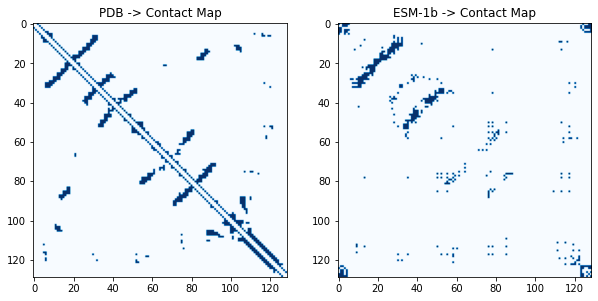

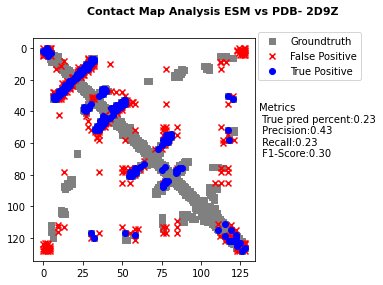

In [41]:
main4()

2D9Z
[[0. 0. 2. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [2. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 2.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 2. 0. 0.]]
FASTA Length:
129
129 129
(16641,)
F1
0.0788513593032835
F1-score
0.0788513593032835


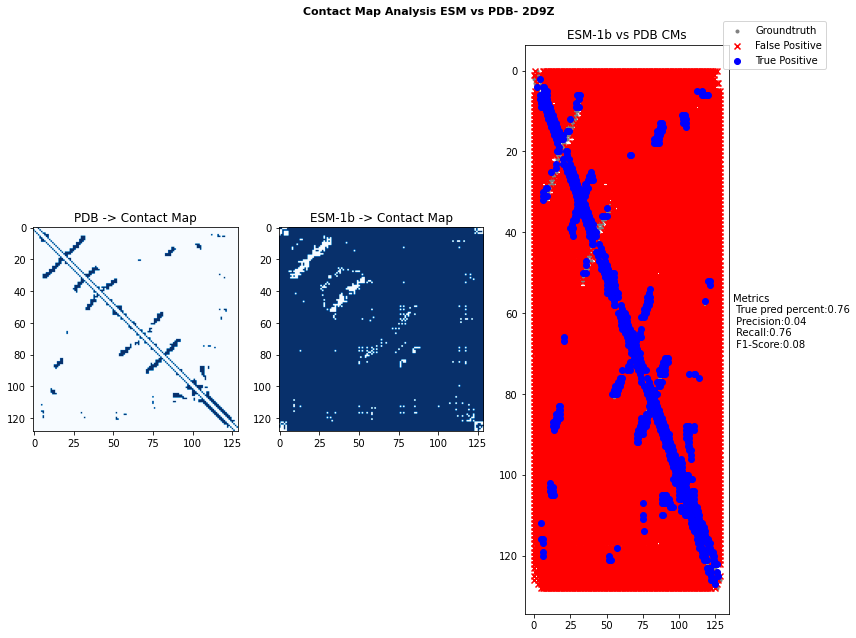

In [63]:
main4()

In [70]:
fasta_data = [read_sequence('/Users/rohan/Desktop/contact_map_analysis/data_main/fasta_pdb/1A7S_1_pdb.fasta'),]


In [72]:
fasta_data[0][1]

'IVGGRKARPRQFPFLASIQNQGRHFCGGALIHARFVMTAASCFXXXXPGVSTVVLGAYDLRRRERQSRQTFSISSMSENGYDPQQNLNDLMLLQLDREANLTSSVTILPLPLQNATVEAGTRCQVAGWGSQRSGGRLSRFPRFVNVTVTPEDQCRPNNVCTGVLTRRGGICNGDGGTPLVCEGLAHGVASFSLGPCGRGPDFFTRVALFRDWIDGVLNNPGPGPA'

In [ ]:
if os.path.isfile(PDB_file):
        with open(PDB_file, 'r') as pdb_file:
            for record in SeqIO.parse(pdb_file, 'pdb-atom'):

3KHF
FASTA Length:
97
106 97
FASTA and PDB are differnet for3KHF
3LQ3
FASTA Length:
347
358 347
FASTA and PDB are differnet for3LQ3
3FEG
FASTA Length:
347
360 347
FASTA and PDB are differnet for3FEG
6YA6
FASTA Length:
140
348 140
FASTA and PDB are differnet for6YA6
2WWE
Fasta sequence>1024
2IIM
FASTA Length:
62
65 62
FASTA and PDB are differnet for2IIM
4L0N
FASTA Length:
48
57 48
FASTA and PDB are differnet for4L0N
3WAR
FASTA Length:
334
354 334
FASTA and PDB are differnet for3WAR
2X18
FASTA Length:
116
113 116
FASTA and PDB are differnet for2X18
7A22
FASTA Length:
328
337 328
FASTA and PDB are differnet for7A22
7A1Z
FASTA Length:
328
338 328
FASTA and PDB are differnet for7A1Z
7A2H
FASTA Length:
325
336 325
FASTA and PDB are differnet for7A2H
7A1B
FASTA Length:
327
345 327
FASTA and PDB are differnet for7A1B
1WYX
FASTA Length:
69
68 69
FASTA and PDB are differnet for1WYX
6Z19
FASTA Length:
8
335 8
FASTA and PDB are differnet for6Z19
3M9J
FASTA Length:
105
130 105
FASTA and PDB are dif

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


96 84
FASTA and PDB are differnet for3O46
3I4W
FASTA Length:
98
99 98
FASTA and PDB are differnet for3I4W
6TSE
FASTA Length:
169
166 169
FASTA and PDB are differnet for6TSE
3S4E
FASTA Length:
209
144 209
FASTA and PDB are differnet for3S4E
3G36
FASTA Length:
51
52 51
FASTA and PDB are differnet for3G36
6EGE
FASTA Length:
296
284 296
FASTA and PDB are differnet for6EGE
2QT1
FASTA Length:
194
202 194
FASTA and PDB are differnet for2QT1
6HOG
FASTA Length:
126
132 126
FASTA and PDB are differnet for6HOG
2QFA
FASTA Length:
45
140 45
FASTA and PDB are differnet for2QFA
2C60
FASTA Length:
133
5 133
FASTA and PDB are differnet for2C60
2XRW
FASTA Length:
12
358 12
FASTA and PDB are differnet for2XRW
5GJH
FASTA Length:
8
103 8
FASTA and PDB are differnet for5GJH
6G9Z
FASTA Length:
118
131 118
FASTA and PDB are differnet for6G9Z
5O8I
FASTA Length:
116
128 116
FASTA and PDB are differnet for5O8I
1LKK
FASTA Length:
4
105 4
FASTA and PDB are differnet for1LKK
4N6X
FASTA Length:
91
95 91
FASTA and PD

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


94 95
FASTA and PDB are differnet for3L46
5EP6
FASTA Length:
46
41 46
FASTA and PDB are differnet for5EP6
1EAZ
FASTA Length:
104
103 104
FASTA and PDB are differnet for1EAZ
6KC4
FASTA Length:
6
102 6
FASTA and PDB are differnet for6KC4
6KEC
FASTA Length:
123
126 123
FASTA and PDB are differnet for6KEC
6KEI
FASTA Length:
123
124 123
FASTA and PDB are differnet for6KEI
5K26
FASTA Length:
75
82 75
FASTA and PDB are differnet for5K26
6TT2
FASTA Length:
169
165 169
FASTA and PDB are differnet for6TT2
4EIH
FASTA Length:
101
107 101
FASTA and PDB are differnet for4EIH
5NP5
FASTA Length:
57
66 57
FASTA and PDB are differnet for5NP5
6B9X
FASTA Length:
91
60 91
FASTA and PDB are differnet for6B9X
3FIA
FASTA Length:
98


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


100 98
FASTA and PDB are differnet for3FIA
4LMM
FASTA Length:
91
97 91
FASTA and PDB are differnet for4LMM
2R3R
FASTA Length:
298
299 298
FASTA and PDB are differnet for2R3R
2R3I
FASTA Length:
298
303 298
FASTA and PDB are differnet for2R3I
6HOL
FASTA Length:
10
122 10
FASTA and PDB are differnet for6HOL
6J5S
FASTA Length:
116
128 116
FASTA and PDB are differnet for6J5S
5ED3
FASTA Length:
115
113 115
FASTA and PDB are differnet for5ED3
6TEW
FASTA Length:
325
331 325
FASTA and PDB are differnet for6TEW
4FKL
FASTA Length:
298
329 298
FASTA and PDB are differnet for4FKL
4EK4
FASTA Length:
296
323 296
FASTA and PDB are differnet for4EK4
4EK3
FASTA Length:
296
313 296
FASTA and PDB are differnet for4EK3
4P5Q
FASTA Length:
296
285 296
FASTA and PDB are differnet for4P5Q
6HMB
FASTA Length:
328
350 328
FASTA and PDB are differnet for6HMB
6HMC
FASTA Length:
327
344 327
FASTA and PDB are differnet for6HMC
6HMD
FASTA Length:
328
349 328
FASTA and PDB are differnet for6HMD
4LDJ
FASTA Length:
202
1

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


99 6
FASTA and PDB are differnet for3WA4
1OBX
FASTA Length:
4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


74 4
FASTA and PDB are differnet for1OBX
5P21
FASTA Length:
166
166 166
5XRD
FASTA Length:
208
208 208
4YDP
FASTA Length:
103
88 103
FASTA and PDB are differnet for4YDP
4FH0


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
95
99 95
FASTA and PDB are differnet for4FH0
7F0W
FASTA Length:
200
169 200
FASTA and PDB are differnet for7F0W
6ZBK
FASTA Length:
103
117 103
FASTA and PDB are differnet for6ZBK
3EAZ
FASTA Length:
102
107 102
FASTA and PDB are differnet for3EAZ
3EAC
FASTA Length:
101
106 101
FASTA and PDB are differnet for3EAC
6Q4Q
FASTA Length:
8
336 8
FASTA and PDB are differnet for6Q4Q
5AUL
FASTA Length:
6
135 6
FASTA and PDB are differnet for5AUL
7L9M
FASTA Length:
127
127 127
6SRH
FASTA Length:
295
302 295
FASTA and PDB are differnet for6SRH
7M10
FASTA Length:
8
72 8
FASTA and PDB are differnet for7M10
6Z36
FASTA Length:
295
296 295
FASTA and PDB are differnet for6Z36
6B42
FASTA Length:
113
120 113
FASTA and PDB are differnet for6B42
5WA8
FASTA Length:
112
118 112
FASTA and PDB are differnet for5WA8
5WA9
FASTA Length:
112
121 112
FASTA and PDB are differnet for5WA9
5LR1
FASTA Length:
208
209 208
FASTA and PDB are differnet for5LR1
5XRE
FASTA Length:
208
207 208
FASTA and PDB are dif

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
338
347 338
FASTA and PDB are differnet for6G36
6HOI
FASTA Length:
9
125 9
FASTA and PDB are differnet for6HOI
5J1S
FASTA Length:
123
291 123
FASTA and PDB are differnet for5J1S
2YJ2
FASTA Length:
220
231 220
FASTA and PDB are differnet for2YJ2
2YJ9
FASTA Length:
220
223 220
FASTA and PDB are differnet for2YJ9
2YJ8
FASTA Length:
220
232 220
FASTA and PDB are differnet for2YJ8
2YJB
FASTA Length:
220
225 220
FASTA and PDB are differnet for2YJB
2IZX
FASTA Length:
18
39 18
FASTA and PDB are differnet for2IZX
5ZCK
FASTA Length:
4
4 4


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


4FKU
FASTA Length:
298
314 298
FASTA and PDB are differnet for4FKU
5J1T
FASTA Length:
121
288 121
FASTA and PDB are differnet for5J1T
2OVJ
FASTA Length:
201
207 201
FASTA and PDB are differnet for2OVJ
6RQW
FASTA Length:
256
263 256
FASTA and PDB are differnet for6RQW
6RQQ
FASTA Length:
256
268 256
FASTA and PDB are differnet for6RQQ
6J65
FASTA Length:
115
114 115
FASTA and PDB are differnet for6J65
6DMJ
FASTA Length:
127
130 127
FASTA and PDB are differnet for6DMJ
6HYO
FASTA Length:
131
150 131
FASTA and PDB are differnet for6HYO
7AJN
FASTA Length:
127
127 127
6SE4
FASTA Length:
126
131 126
FASTA and PDB are differnet for6SE4
6S25
FASTA Length:
127
132 127
FASTA and PDB are differnet for6S25
5O97
FASTA Length:
127
130 127
FASTA and PDB are differnet for5O97
6ZED
130 127
FASTA and PDB are differnet for6ZED
6ZEL
130 127
FASTA and PDB are differnet for6ZEL
6ZF9
130 127
FASTA and PDB are differnet for6ZF9
6I7Y
FASTA Length:
127
134 127
FASTA and PDB are differnet for6I7Y
6I7X
FASTA Length:

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


65 7
FASTA and PDB are differnet for4X3K
1NTE
FASTA Length:
82
82 82
5J80
FASTA Length:
208
215 208
FASTA and PDB are differnet for5J80
5J64
FASTA Length:
208
213 208
FASTA and PDB are differnet for5J64
7AEW
213 208
FASTA and PDB are differnet for7AEW
6FCP
FASTA Length:
8
257 8
FASTA and PDB are differnet for6FCP
5P9K
FASTA Length:
271
287 271
FASTA and PDB are differnet for5P9K
4HCV
FASTA Length:
263
263 263
4HCU
FASTA Length:
263
263 263
4HCT
FASTA Length:
265
265 265
3KZD
FASTA Length:
91
94 91
FASTA and PDB are differnet for3KZD
2RGG
FASTA Length:
166
159 166
FASTA and PDB are differnet for2RGG
6Y8E
FASTA Length:
363
248 363
FASTA and PDB are differnet for6Y8E
2A2A
FASTA Length:
303
314 303
FASTA and PDB are differnet for2A2A
7A2N
FASTA Length:
59
59 59
6QUW
FASTA Length:
167
171 167
FASTA and PDB are differnet for6QUW
6QUV
FASTA Length:
167
170 167
FASTA and PDB are differnet for6QUV
2FE5
FASTA Length:
94
101 94
FASTA and PDB are differnet for2FE5
3O3U
Fasta sequence>1024
7A2S
FAS

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
325
344 325
FASTA and PDB are differnet for4ZX2
1W1G
FASTA Length:
144
143 144
FASTA and PDB are differnet for1W1G
6G6K
FASTA Length:
76
92 76
FASTA and PDB are differnet for6G6K
3IQJ
FASTA Length:
8
273 8
FASTA and PDB are differnet for3IQJ
7NPG
FASTA Length:
8
251 8
FASTA and PDB are differnet for7NPG
7NPB
FASTA Length:
9
247 9
FASTA and PDB are differnet for7NPB
7NP2
FASTA Length:
8
246 8
FASTA and PDB are differnet for7NP2
7NND
FASTA Length:
9
240 9
FASTA and PDB are differnet for7NND
3A7I
FASTA Length:
287
287 287
4UU5
FASTA Length:
14
111 14
FASTA and PDB are differnet for4UU5
6M64
FASTA Length:
27
205 27
FASTA and PDB are differnet for6M64
3NSZ
FASTA Length:
327
333 327
FASTA and PDB are differnet for3NSZ
4QLI
FASTA Length:
6
258 6
FASTA and PDB are differnet for4QLI
6T29
258 6
FASTA and PDB are differnet for6T29
7LB1
FASTA Length:
249
249 249


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()


3GU6
FASTA Length:
293
297 293
FASTA and PDB are differnet for3GU6
3GU4
FASTA Length:
293
305 293
FASTA and PDB are differnet for3GU4
2OSS
FASTA Length:
127
138 127
FASTA and PDB are differnet for2OSS
3EYI
FASTA Length:
170
64 170
FASTA and PDB are differnet for3EYI
3U5L
FASTA Length:
127
139 127
FASTA and PDB are differnet for3U5L
1W1H
FASTA Length:
137
147 137
FASTA and PDB are differnet for1W1H
3G4E
FASTA Length:
297
306 297
FASTA and PDB are differnet for3G4E
3UVW
FASTA Length:
12
135 12
FASTA and PDB are differnet for3UVW
5DC4
FASTA Length:
92
100 92
FASTA and PDB are differnet for5DC4
6M5Y
FASTA Length:
270
277 270
FASTA and PDB are differnet for6M5Y
5VBM
FASTA Length:
203
169 203
FASTA and PDB are differnet for5VBM
4KS7
FASTA Length:
287
302 287
FASTA and PDB are differnet for4KS7
5NNF
FASTA Length:
8
132 8
FASTA and PDB are differnet for5NNF
6H5W
FASTA Length:
586
608 586
FASTA and PDB are differnet for6H5W
2A2R
FASTA Length:
209
214 209
FASTA and PDB are differnet for2A2R
2OUR

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
327
328 327
FASTA and PDB are differnet for5ZN0
5ZN1
FASTA Length:
327
331 327
FASTA and PDB are differnet for5ZN1
5ZN2
FASTA Length:
327
325 327
FASTA and PDB are differnet for5ZN2
5E8X
FASTA Length:
304
306 304
FASTA and PDB are differnet for5E8X
3IQV
FASTA Length:
6
271 6
FASTA and PDB are differnet for3IQV
3IQU
FASTA Length:
6
275 6
FASTA and PDB are differnet for3IQU
6MV4
FASTA Length:
54
250 54
FASTA and PDB are differnet for6MV4
5J2X
FASTA Length:
209
215 209
FASTA and PDB are differnet for5J2X
4D3P
FASTA Length:
147
147 147
5DQY
FASTA Length:
105
109 105
FASTA and PDB are differnet for5DQY
5EOP
FASTA Length:
121
127 121
FASTA and PDB are differnet for5EOP
3CO1
FASTA Length:
132
135 132
FASTA and PDB are differnet for3CO1
7LAY
FASTA Length:
112
124 112
FASTA and PDB are differnet for7LAY
1PWA
FASTA Length:
136
123 136
FASTA and PDB are differnet for1PWA
5MSA
FASTA Length:
261
277 261
FASTA and PDB are differnet for5MSA
5KM2
FASTA Length:
112
125 112
FASTA and PDB a

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
162
153 162
FASTA and PDB are differnet for1UZK
3P34
FASTA Length:
6
236 6
FASTA and PDB are differnet for3P34
7S5A
FASTA Length:
76
77 76
FASTA and PDB are differnet for7S5A
4LM4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
327
330 327
FASTA and PDB are differnet for4LM4
4LM3
FASTA Length:
327
331 327
FASTA and PDB are differnet for4LM3
2QUZ
FASTA Length:
180
166 180
FASTA and PDB are differnet for2QUZ
1MFG
FASTA Length:
9
95 9
FASTA and PDB are differnet for1MFG
6BLN
FASTA Length:
264
270 264
FASTA and PDB are differnet for6BLN
6BKW
FASTA Length:
266
272 266
FASTA and PDB are differnet for6BKW
6PCL
FASTA Length:
135
146 135
FASTA and PDB are differnet for6PCL
6PCK
FASTA Length:
134
145 134
FASTA and PDB are differnet for6PCK
3SOV
FASTA Length:
7
323 7
FASTA and PDB are differnet for3SOV
5NK5
FASTA Length:
292
297 292
FASTA and PDB are differnet for5NK5
5NK6
FASTA Length:
292
298 292
FASTA and PDB are differnet for5NK6
5NK4
FASTA Length:
296
297 296
FASTA and PDB are differnet for5NK4
5NKA
FASTA Length:
291
274 291
FASTA and PDB are differnet for5NKA
5NKG
FASTA Length:
292
301 292
FASTA and PDB are differnet for5NKG
5NKH
FASTA Length:
295
303 295
FASTA and PDB are differnet for5NKH
5NKE
FAST

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
140
142 140
FASTA and PDB are differnet for1KQ6
6X3P
FASTA Length:
266
270 266
FASTA and PDB are differnet for6X3P
3P1N
FASTA Length:
6
288 6
FASTA and PDB are differnet for3P1N
5L0S
FASTA Length:
39
362 39
FASTA and PDB are differnet for5L0S
4O7A
FASTA Length:
127
127 127
4O74
FASTA Length:
127
129 127
FASTA and PDB are differnet for4O74
4O72
FASTA Length:
127
131 127
FASTA and PDB are differnet for4O72
4O78
FASTA Length:
127
136 127
FASTA and PDB are differnet for4O78
3TEM
FASTA Length:
228
228 228
6PKF
FASTA Length:
259
268 259
FASTA and PDB are differnet for6PKF
4CY7
FASTA Length:
30
21 30
FASTA and PDB are differnet for4CY7
6ICG
FASTA Length:
95
101 95
FASTA and PDB are differnet for6ICG
6TC2
FASTA Length:
28
22 28
FASTA and PDB are differnet for6TC2
4U7H
FASTA Length:
230
232 230
FASTA and PDB are differnet for4U7H
5NNE
FASTA Length:
10
131 10
FASTA and PDB are differnet for5NNE
5MME
FASTA Length:
119
121 119
FASTA and PDB are differnet for5MME
1XOZ
FASTA Length:
32

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
190
207 190
FASTA and PDB are differnet for4ZGG
3T0H
FASTA Length:
209
209 209
7RT1
FASTA Length:
201
170 201
FASTA and PDB are differnet for7RT1
7RT5
FASTA Length:
201
171 201
FASTA and PDB are differnet for7RT5
5P9M
FASTA Length:
271
275 271
FASTA and PDB are differnet for5P9M
5P9L
FASTA Length:
266
256 266
FASTA and PDB are differnet for5P9L
5P9I
FASTA Length:
271
275 271
FASTA and PDB are differnet for5P9I
5P9J
FASTA Length:
266
272 266
FASTA and PDB are differnet for5P9J
4J46
FASTA Length:
76
83 76
FASTA and PDB are differnet for4J46
4J45
FASTA Length:
76
84 76
FASTA and PDB are differnet for4J45
4J44
FASTA Length:
76
85 76
FASTA and PDB are differnet for4J44
4J47
FASTA Length:
76
84 76
FASTA and PDB are differnet for4J47
5S9K
FASTA Length:
295
295 295
5S8A
FASTA Length:
295
300 295
FASTA and PDB are differnet for5S8A
5S81
FASTA Length:
292
297 292
FASTA and PDB are differnet for5S81
5S7N
FASTA Length:
293
301 293
FASTA and PDB are differnet for5S7N
5S7L
FASTA Length

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
898
325 898
FASTA and PDB are differnet for2B69
6HFP
FASTA Length:
362
384 362
FASTA and PDB are differnet for6HFP
6HFN
FASTA Length:
362
377 362
FASTA and PDB are differnet for6HFN
5F2E
FASTA Length:
207
188 207
FASTA and PDB are differnet for5F2E
7S6O
FASTA Length:
73
84 73
FASTA and PDB are differnet for7S6O
6OC0
FASTA Length:
365
375 365
FASTA and PDB are differnet for6OC0
6PHQ
FASTA Length:
26
29 26
FASTA and PDB are differnet for6PHQ
6PHM
FASTA Length:
28
34 28
FASTA and PDB are differnet for6PHM
6PHN
FASTA Length:
25
30 25
FASTA and PDB are differnet for6PHN
3BER
FASTA Length:
220
231 220
FASTA and PDB are differnet for3BER
3GHU
FASTA Length:
316
374 316
FASTA and PDB are differnet for3GHU
3GHT
FASTA Length:
316
374 316
FASTA and PDB are differnet for3GHT
3GHS
FASTA Length:
316
374 316
FASTA and PDB are differnet for3GHS
3GHR
FASTA Length:
316
374 316
FASTA and PDB are differnet for3GHR
3Q1I
FASTA Length:
7
224 7
FASTA and PDB are differnet for3Q1I
3WHA
FASTA Lengt

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


29 26
FASTA and PDB are differnet for6PHO
6PHL
FASTA Length:
25
27 25
FASTA and PDB are differnet for6PHL
6PHI
FASTA Length:
28
31 28
FASTA and PDB are differnet for6PHI
4EO7
FASTA Length:
144
155 144
FASTA and PDB are differnet for4EO7
4ONM
FASTA Length:
149
146 149
FASTA and PDB are differnet for4ONM
5GOD
FASTA Length:
76
76 76
5GOB
FASTA Length:
74
76 74
FASTA and PDB are differnet for5GOB
5W7W
FASTA Length:
105
110 105
FASTA and PDB are differnet for5W7W
2OUS
FASTA Length:
329
326 329
FASTA and PDB are differnet for2OUS
6EDF
FASTA Length:
77


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


81 77
FASTA and PDB are differnet for6EDF
4QR5
FASTA Length:
125
127 125
FASTA and PDB are differnet for4QR5
4QR4
FASTA Length:
125
130 125
FASTA and PDB are differnet for4QR4
4QR3
FASTA Length:
125
128 125
FASTA and PDB are differnet for4QR3
4NUC
FASTA Length:
126
129 126
FASTA and PDB are differnet for4NUC
4NUE
FASTA Length:
126
126 126
4NUD
FASTA Length:
123
125 123
FASTA and PDB are differnet for4NUD
4UDW
FASTA Length:
28
266 28
FASTA and PDB are differnet for4UDW
4UE7
FASTA Length:
28
266 28
FASTA and PDB are differnet for4UE7
4UD9
FASTA Length:
28
267 28
FASTA and PDB are differnet for4UD9
5AHG
FASTA Length:
28
258 28
FASTA and PDB are differnet for5AHG
5AFY
FASTA Length:
29
264 29
FASTA and PDB are differnet for5AFY
5AF9
FASTA Length:
28
262 28
FASTA and PDB are differnet for5AF9
6FT3
FASTA Length:
127
130 127
FASTA and PDB are differnet for6FT3
6FT4
FASTA Length:
127
127 127
6FSY
FASTA Length:
127
130 127
FASTA and PDB are differnet for6FSY
6VUJ
FASTA Length:
125
132 125
FASTA 

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6SZM
FASTA Length:
295
296 295
FASTA and PDB are differnet for6SZM
6G3R


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: TE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
380
393 380
FASTA and PDB are differnet for6G3R
6Y1E
FASTA Length:
209
211 209
FASTA and PDB are differnet for6Y1E
5PYW
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PYW
5PXB
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PXB
5PXA
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PXA
5PXL
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PXL
5PY5
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PY5
5PXT
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PXT
5PXS
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PXS
5PXN
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PXN
5PWG
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PWG
5PWF
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PWF
5PX4
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PX4
5PWS
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PWS
5PX2
FASTA Length:
177
188 177
FASTA and PDB are differnet for5PX2


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6GJ5
FASTA Length:
170
168 170
FASTA and PDB are differnet for6GJ5
4XO6
FASTA Length:
325
335 325
FASTA and PDB are differnet for4XO6
4GQ4


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
587
485 587
FASTA and PDB are differnet for4GQ4
4GPQ
FASTA Length:
588
487 588
FASTA and PDB are differnet for4GPQ
4OG4
FASTA Length:
587
476 587
FASTA and PDB are differnet for4OG4
4OG6
FASTA Length:
587
478 587
FASTA and PDB are differnet for4OG6
6O53
FASTA Length:
10
275 10
FASTA and PDB are differnet for6O53
4C9X
FASTA Length:
154
173 154
FASTA and PDB are differnet for4C9X
3EG3
FASTA Length:
63
65 63
FASTA and PDB are differnet for3EG3
5LMA
FASTA Length:
270
282 270
FASTA and PDB are differnet for5LMA
6DJC
FASTA Length:
131
133 131
FASTA and PDB are differnet for6DJC
5XHE
FASTA Length:
113
127 113
FASTA and PDB are differnet for5XHE
5KU3
FASTA Length:
126
136 126
FASTA and PDB are differnet for5KU3
5NWD
FASTA Length:
47
165 47
FASTA and PDB are differnet for5NWD
5NWG
FASTA Length:
47
178 47
FASTA and PDB are differnet for5NWG
7ROV
FASTA Length:
14
170 14
FASTA and PDB are differnet for7ROV
3I3S
FASTA Length:
166
200 166
FASTA and PDB are differnet for3I3S
5Y8C
FASTA 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
1
346 1
FASTA and PDB are differnet for7KT5
1CTQ
FASTA Length:
166
166 166
3BUW
FASTA Length:
305
9 305
FASTA and PDB are differnet for3BUW
7K5L
FASTA Length:
124
131 124
FASTA and PDB are differnet for7K5L
6G0P
FASTA Length:
9
128 9
FASTA and PDB are differnet for6G0P
4WJQ
FASTA Length:
12
78 12
FASTA and PDB are differnet for4WJQ
5OCG
FASTA Length:
172
175 172
FASTA and PDB are differnet for5OCG
5M9O
FASTA Length:
4
217 4
FASTA and PDB are differnet for5M9O
2CL6
FASTA Length:
166
166 166
2EVW
FASTA Length:
166
166 166
6G0Q
FASTA Length:
10
125 10
FASTA and PDB are differnet for6G0Q
3RS0
FASTA Length:
166
171 166
FASTA and PDB are differnet for3RS0
5C2K


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AL
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
502
392 502
FASTA and PDB are differnet for5C2K
7NEL
FASTA Length:
11
250 11
FASTA and PDB are differnet for7NEL
6G0O
FASTA Length:
11
125 11
FASTA and PDB are differnet for6G0O
5XCT
FASTA Length:
6
181 6
FASTA and PDB are differnet for5XCT
5XCQ
FASTA Length:
6
177 6
FASTA and PDB are differnet for5XCQ
7KHL
FASTA Length:
127
131 127
FASTA and PDB are differnet for7KHL
5JFD
FASTA Length:
31
32 31
FASTA and PDB are differnet for5JFD
6T56
FASTA Length:
30
31 30
FASTA and PDB are differnet for6T56
6T55
FASTA Length:
29
30 29
FASTA and PDB are differnet for6T55
6T53
FASTA Length:
28
30 28
FASTA and PDB are differnet for6T53
6YQV
FASTA Length:
28
31 28
FASTA and PDB are differnet for6YQV
6YHG
FASTA Length:
31
35 31
FASTA and PDB are differnet for6YHG
5A2M
FASTA Length:
29
258 29
FASTA and PDB are differnet for5A2M
6TKL
FASTA Length:
36
36 36
6TKG
FASTA Length:
36
36 36
6Y02
FASTA Length:
28
32 28
FASTA and PDB are differnet for6Y02
6VAJ
FASTA Length:
158
155 158
FASTA and PDB a

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


120 116
FASTA and PDB are differnet for3PP2
6PAF
FASTA Length:
426
435 426
FASTA and PDB are differnet for6PAF
6G2N
FASTA Length:
192
194 192
FASTA and PDB are differnet for6G2N
4KNN
FASTA Length:
258
269 258
FASTA and PDB are differnet for4KNN
2ITK
FASTA Length:
5
145 5
FASTA and PDB are differnet for2ITK
2E3N
FASTA Length:
234
231 234
FASTA and PDB are differnet for2E3N
2E3P
FASTA Length:
234
235 234
FASTA and PDB are differnet for2E3P
7AVC
235 234
FASTA and PDB are differnet for7AVC
7ER8
FASTA Length:
206
211 206
FASTA and PDB are differnet for7ER8
2C9S
FASTA Length:
153
168 153
FASTA and PDB are differnet for2C9S
2C9U
FASTA Length:
153
153 153
2C9V
FASTA Length:
153
166 153
FASTA and PDB are differnet for2C9V
4HY4
FASTA Length:
95
92 95
FASTA and PDB are differnet for4HY4
1DG6
FASTA Length:
162
149 162
FASTA and PDB are differnet for1DG6
4AG1
FASTA Length:
63
230 63
FASTA and PDB are differnet for4AG1
3NCL
FASTA Length:
248
245 248
FASTA and PDB are differnet for3NCL
7KG8


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AS
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
512
508 512
FASTA and PDB are differnet for7KG8
4QUJ
FASTA Length:
4
259 4
FASTA and PDB are differnet for4QUJ
5CQ2
FASTA Length:
12


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


37 12
FASTA and PDB are differnet for5CQ2
3SJM
FASTA Length:
55
6QW3
FASTA Length:
110
124 110
FASTA and PDB are differnet for6QW3
6NV2
FASTA Length:
9
239 9
FASTA and PDB are differnet for6NV2
6QHM
FASTA Length:
3
249 3
FASTA and PDB are differnet for6QHM
5MM6
FASTA Length:
28
29 28
FASTA and PDB are differnet for5MM6
5MJT
FASTA Length:
31
31 31
5I88
FASTA Length:
126
131 126
FASTA and PDB are differnet for5I88
5KTU
FASTA Length:
113
108 113
FASTA and PDB are differnet for5KTU
4FYO
FASTA Length:
277
267 277
FASTA and PDB are differnet for4FYO
5MPZ
FASTA Length:
110
115 110
FASTA and PDB are differnet for5MPZ
5MQG
FASTA Length:
113
122 113
FASTA and PDB are differnet for5MQG
6I44
FASTA Length:
728
629 728
FASTA and PDB are differnet for6I44
5B4O
FASTA Length:
114
114 114
5TIU
FASTA Length:
277
267 277
FASTA and PDB are differnet for5TIU
4PZ3
FASTA Length:
4
167 4
FASTA and PDB are differnet for4PZ3
6RL3
FASTA Length:
12
246 12
FASTA and PDB are differnet for6RL3
5R8B
FASTA Length:
152


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
153
153 153
5COY
FASTA Length:
65
65 65
3UGC
FASTA Length:
287
278 287
FASTA and PDB are differnet for3UGC
3TOW
FASTA Length:
152
155 152
FASTA and PDB are differnet for3TOW
6O24
FASTA Length:
112
232 112
FASTA and PDB are differnet for6O24
4JJE
FASTA Length:
1
246 1
FASTA and PDB are differnet for4JJE
3VXE
FASTA Length:
27
28 27
FASTA and PDB are differnet for3VXE
1OGW
FASTA Length:
76
76 76
1Z89
FASTA Length:
316
316 316
6TNQ
FASTA Length:
8
70 8
FASTA and PDB are differnet for6TNQ
7NHU
FASTA Length:
29
25 29
FASTA and PDB are differnet for7NHU
2H3L
FASTA Length:
98
103 98
FASTA and PDB are differnet for2H3L
5NI9
FASTA Length:
14
183 14
FASTA and PDB are differnet for5NI9
5NIG
FASTA Length:
15
183 15
FASTA and PDB are differnet for5NIG
5NR4
FASTA Length:
220
222 220
FASTA and PDB are differnet for5NR4
4IUM
FASTA Length:
75
133 75
FASTA and PDB are differnet for4IUM
4N7F
FASTA Length:
454
37 454
FASTA and PDB are differnet for4N7F
5YQO
FASTA Length:
306
291 306
FASTA and

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
293
293 293
6Y3V
FASTA Length:
1
239 1
FASTA and PDB are differnet for6Y3V
3H61


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
315
315 315
3H63


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
315
316 315
FASTA and PDB are differnet for3H63
5UGG
FASTA Length:
248
272 248
FASTA and PDB are differnet for5UGG
5UGD
FASTA Length:
248
251 248
FASTA and PDB are differnet for5UGD
3H62
FASTA Length:
315
315 315
1I27
FASTA Length:
73
73 73
4IGH
FASTA Length:
363
376 363
FASTA and PDB are differnet for4IGH
6I42
FASTA Length:
13
175 13
FASTA and PDB are differnet for6I42
5HKJ
FASTA Length:
407
426 407
FASTA and PDB are differnet for5HKJ
3AP9
FASTA Length:
151
155 151
FASTA and PDB are differnet for3AP9
4LNP
FASTA Length:
10
67 10
FASTA and PDB are differnet for4LNP
4LN2
FASTA Length:
10
72 10
FASTA and PDB are differnet for4LN2
6BCD
FASTA Length:
25
211 25
FASTA and PDB are differnet for6BCD
5L0T
FASTA Length:
40
364 40
FASTA and PDB are differnet for5L0T
4NIB
FASTA Length:
30
21 30
FASTA and PDB are differnet for4NIB
5HRQ
FASTA Length:
29
21 29
FASTA and PDB are differnet for5HRQ
1BKR
FASTA Length:
108
108 108
5TXY
FASTA Length:
256
271 256
FASTA and PDB are differnet for

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: TB
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
319
290 319
FASTA and PDB are differnet for7NX1
5S8I
FASTA Length:
119
123 119
FASTA and PDB are differnet for5S8I
5S8J
FASTA Length:
125
131 125
FASTA and PDB are differnet for5S8J
5S8G
FASTA Length:
119
123 119
FASTA and PDB are differnet for5S8G
5S8H
FASTA Length:
119
124 119
FASTA and PDB are differnet for5S8H
5S8E
FASTA Length:
119
124 119
FASTA and PDB are differnet for5S8E
5S8F
FASTA Length:
119
124 119
FASTA and PDB are differnet for5S8F
5S8C
FASTA Length:
118
124 118
FASTA and PDB are differnet for5S8C
5S8D
FASTA Length:
119
124 119
FASTA and PDB are differnet for5S8D
5S8P
FASTA Length:
120
122 120
FASTA and PDB are differnet for5S8P
5S8M
FASTA Length:
119
125 119
FASTA and PDB are differnet for5S8M
5S8N
FASTA Length:
119
124 119
FASTA and PDB are differnet for5S8N
5S8K
FASTA Length:
119
124 119
FASTA and PDB are differnet for5S8K
5S8L
FASTA Length:
119
125 119
FASTA and PDB are differnet for5S8L
5RKU
FASTA Length:
119
124 119
FASTA and PDB are differnet for5RKU


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
285
275 285
FASTA and PDB are differnet for3SXB
3SX8
FASTA Length:
284
274 284
FASTA and PDB are differnet for3SX8
3SX5
FASTA Length:
288
286 288
FASTA and PDB are differnet for3SX5
6LJE
FASTA Length:
101
108 101
FASTA and PDB are differnet for6LJE
4EEW
FASTA Length:
75
78 75
FASTA and PDB are differnet for4EEW
4WZX
FASTA Length:
16


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


88 16
FASTA and PDB are differnet for4WZX
2IKG
FASTA Length:
316
316 316
2IKI
FASTA Length:
311
311 311
7JGW
FASTA Length:
201
148 201
FASTA and PDB are differnet for7JGW
4GV1
FASTA Length:
335
345 335
FASTA and PDB are differnet for4GV1
6KX2
FASTA Length:
197
177 197
FASTA and PDB are differnet for6KX2
3WLU


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
142
142 142
4ICV
FASTA Length:
84


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: PR
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


97 84
FASTA and PDB are differnet for4ICV
4OQV
FASTA Length:
362
365 362
FASTA and PDB are differnet for4OQV
6HYN
FASTA Length:
132
155 132
FASTA and PDB are differnet for6HYN
3CBP
FASTA Length:
4
247 4
FASTA and PDB are differnet for3CBP
4WK9
FASTA Length:
369
388 369
FASTA and PDB are differnet for4WK9
4WKH
FASTA Length:
369
401 369
FASTA and PDB are differnet for4WKH
4WKF
FASTA Length:
368
386 368
FASTA and PDB are differnet for4WKF
6XLV
FASTA Length:
1
211 1
FASTA and PDB are differnet for6XLV
4WJO
FASTA Length:
23
77 23
FASTA and PDB are differnet for4WJO
5UDP
FASTA Length:
28
22 28
FASTA and PDB are differnet for5UDP
5E50
FASTA Length:
9
116 9
FASTA and PDB are differnet for5E50
1X96
FASTA Length:
316
322 316
FASTA and PDB are differnet for1X96
1X98
FASTA Length:
316
329 316
FASTA and PDB are differnet for1X98
3ONB
FASTA Length:
312
320 312
FASTA and PDB are differnet for3ONB
3ONC
FASTA Length:
313
336 313
FASTA and PDB are differnet for3ONC
2QJZ
FASTA Length:
119


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


121 119
FASTA and PDB are differnet for2QJZ
4UZ1
FASTA Length:
367
364 367
FASTA and PDB are differnet for4UZ1
4WW6
FASTA Length:
258
284 258
FASTA and PDB are differnet for4WW6
6XXC
FASTA Length:
7
252 7
FASTA and PDB are differnet for6XXC
6XY5
FASTA Length:
7
251 7
FASTA and PDB are differnet for6XY5
6Y18
FASTA Length:
7
252 7
FASTA and PDB are differnet for6Y18
6UYV
FASTA Length:
24
80 24
FASTA and PDB are differnet for6UYV
5KFZ


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
435
434 435
FASTA and PDB are differnet for5KFZ
7MU3
FASTA Length:
260
282 260
FASTA and PDB are differnet for7MU3
5SYA
FASTA Length:
186
221 186
FASTA and PDB are differnet for5SYA
5SY9
FASTA Length:
188
223 188
FASTA and PDB are differnet for5SY9
5SY6
FASTA Length:
187
204 187
FASTA and PDB are differnet for5SY6
4P2G
FASTA Length:
187
200 187
FASTA and PDB are differnet for4P2G
3CZA
FASTA Length:
186
196 186
FASTA and PDB are differnet for3CZA
7AA7
FASTA Length:
8
119 8
FASTA and PDB are differnet for7AA7
6V1B
FASTA Length:
113
120 113
FASTA and PDB are differnet for6V1B
7RNS
FASTA Length:
9
118 9
FASTA and PDB are differnet for7RNS
6MX3
FASTA Length:
183
167 183
FASTA and PDB are differnet for6MX3
3HJ0
FASTA Length:
115
131 115
FASTA and PDB are differnet for3HJ0
5MHC
FASTA Length:
12
277 12
FASTA and PDB are differnet for5MHC
4HI9
FASTA Length:
72
177 72
FASTA and PDB are differnet for4HI9
4HI8
FASTA Length:
72
181 72
FASTA and PDB are differnet for4HI8
4FRA
FASTA Len

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
2
270 2
FASTA and PDB are differnet for6F4Q
7LIP
FASTA Length:
135
135 135
6D30
FASTA Length:
188
201 188
FASTA and PDB are differnet for6D30
6D2Z
FASTA Length:
188
189 188
FASTA and PDB are differnet for6D2Z
5JIX
FASTA Length:
150
154 150
FASTA and PDB are differnet for5JIX
6RJL
FASTA Length:
10
246 10
FASTA and PDB are differnet for6RJL
6RHC
FASTA Length:
13
241 13
FASTA and PDB are differnet for6RHC
7BF2
241 13
FASTA and PDB are differnet for7BF2
5NXI
FASTA Length:
260
273 260
FASTA and PDB are differnet for5NXI
6EIM
FASTA Length:
295
299 295
FASTA and PDB are differnet for6EIM
5JGI
FASTA Length:
154
160 154
FASTA and PDB are differnet for5JGI
5C7G
FASTA Length:
155
155 155
4U3Y
FASTA Length:
304
303 304
FASTA and PDB are differnet for4U3Y
5CMM
FASTA Length:
259
267 259
FASTA and PDB are differnet for5CMM
6R8R
FASTA Length:
368
374 368
FASTA and PDB are differnet for6R8R
6GRO
FASTA Length:
293
303 293
FASTA and PDB are differnet for6GRO
2UYZ
FASTA Length:
78
173 78
FAS

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


109 100
FASTA and PDB are differnet for5KH9
5B8D
FASTA Length:
100
112 100
FASTA and PDB are differnet for5B8D
4JJ7
FASTA Length:
1
243 1
FASTA and PDB are differnet for4JJ7
3EWY
FASTA Length:
257
281 257
FASTA and PDB are differnet for3EWY
3EWX
FASTA Length:
259
271 259
FASTA and PDB are differnet for3EWX
4GAI
FASTA Length:
151
167 151
FASTA and PDB are differnet for4GAI
7AZ1
FASTA Length:
7
254 7
FASTA and PDB are differnet for7AZ1
7AZ2
FASTA Length:
7
249 7
FASTA and PDB are differnet for7AZ2
7AXN
FASTA Length:
9
256 9
FASTA and PDB are differnet for7AXN
7BG3
FASTA Length:
8
250 8
FASTA and PDB are differnet for7BG3
3MRK
FASTA Length:
9
292 9
FASTA and PDB are differnet for3MRK
5KTW
FASTA Length:
114
114 114
5KTX
FASTA Length:
114
115 114
FASTA and PDB are differnet for5KTX
6RA7
FASTA Length:
302
307 302
FASTA and PDB are differnet for6RA7
4NFN
FASTA Length:
293
295 293
FASTA and PDB are differnet for4NFN
6FEW
FASTA Length:
309
294 309
FASTA and PDB are differnet for6FEW
3DN5
FASTA 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: YB
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
608
644 608
FASTA and PDB are differnet for3U9W
7L8Q
FASTA Length:
165
165 165
6B6U
FASTA Length:
519
544 519
FASTA and PDB are differnet for6B6U
3DJH
FASTA Length:
114
114 114
6N6K
FASTA Length:
186
209 186
FASTA and PDB are differnet for6N6K
5G4M
FASTA Length:
197
201 197
FASTA and PDB are differnet for5G4M
5G4N
FASTA Length:
197
199 197
FASTA and PDB are differnet for5G4N
7BF1
199 197
FASTA and PDB are differnet for7BF1
6FVF
FASTA Length:
327
336 327
FASTA and PDB are differnet for6FVF
3F1N
FASTA Length:
112
116 112
FASTA and PDB are differnet for3F1N
2VR8
FASTA Length:
153
155 153
FASTA and PDB are differnet for2VR8
7AT9
FASTA Length:
328
349 328
FASTA and PDB are differnet for7AT9
6ZEI


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
65
312 65
FASTA and PDB are differnet for6ZEI
5FAF
FASTA Length:
113
135 113
FASTA and PDB are differnet for5FAF
6QHJ
FASTA Length:
252
280 252
FASTA and PDB are differnet for6QHJ
6G8L
FASTA Length:
9
277 9
FASTA and PDB are differnet for6G8L
6G8J
FASTA Length:
77
274 77
FASTA and PDB are differnet for6G8J
6G8K
FASTA Length:
5
278 5
FASTA and PDB are differnet for6G8K
6G6X
FASTA Length:
9
289 9
FASTA and PDB are differnet for6G6X
6GUK
FASTA Length:
298
280 298
FASTA and PDB are differnet for6GUK
1MKK
FASTA Length:
94
93 94
FASTA and PDB are differnet for1MKK
6TLS
FASTA Length:
333
413 333
FASTA and PDB are differnet for6TLS
5QIT
FASTA Length:
225
232 225
FASTA and PDB are differnet for5QIT
5QIR
FASTA Length:
225
231 225
FASTA and PDB are differnet for5QIR
5QIQ
FASTA Length:
225
231 225
FASTA and PDB are differnet for5QIQ
5QIO
FASTA Length:
225
228 225
FASTA and PDB are differnet for5QIO
5QIX
FASTA Length:
225
230 225
FASTA and PDB are differnet for5QIX
5QIV
FASTA Length:


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
258
269 258
FASTA and PDB are differnet for5THN
6Q4F
FASTA Length:
300
310 300
FASTA and PDB are differnet for6Q4F
6Q3F
FASTA Length:
302
302 302
6Q3C
FASTA Length:
297
300 297
FASTA and PDB are differnet for6Q3C
6OMU
FASTA Length:
271
282 271
FASTA and PDB are differnet for6OMU
6Q4H
FASTA Length:
299
311 299
FASTA and PDB are differnet for6Q4H
6Q4I
FASTA Length:
298
301 298
FASTA and PDB are differnet for6Q4I
6Q4D
FASTA Length:
296
300 296
FASTA and PDB are differnet for6Q4D
6Q4E
FASTA Length:
299
303 299
FASTA and PDB are differnet for6Q4E
6Q4B
FASTA Length:
298
301 298
FASTA and PDB are differnet for6Q4B
6Q4J
FASTA Length:
299
313 299
FASTA and PDB are differnet for6Q4J
6Q4K
FASTA Length:
299
306 299
FASTA and PDB are differnet for6Q4K
6Q3B
FASTA Length:
298
292 298
FASTA and PDB are differnet for6Q3B
6Q48
FASTA Length:
296
290 296
FASTA and PDB are differnet for6Q48
6Q49
FASTA Length:
298
309 298
FASTA and PDB are differnet for6Q49
4HBQ
FASTA Length:
210
240 210
FASTA

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


117 117
6OSH
FASTA Length:
113
115 113
FASTA and PDB are differnet for6OSH
6OSN
FASTA Length:
85
87 85
FASTA and PDB are differnet for6OSN
6OSV
FASTA Length:
111
114 111
FASTA and PDB are differnet for6OSV
4GCJ
FASTA Length:
304
304 304
6E28
FASTA Length:
90
99 90
FASTA and PDB are differnet for6E28
1GK7
FASTA Length:
39
39 39
1Z0J
FASTA Length:
51
169 51
FASTA and PDB are differnet for1Z0J
5MHQ
FASTA Length:
301
297 301
FASTA and PDB are differnet for5MHQ
5TZM
FASTA Length:
90
95 90
FASTA and PDB are differnet for5TZM
5EHW
FASTA Length:
258
273 258
FASTA and PDB are differnet for5EHW
5EHV
FASTA Length:
258
272 258
FASTA and PDB are differnet for5EHV
6R8P
FASTA Length:
364
359 364
FASTA and PDB are differnet for6R8P
6TJT
FASTA Length:
3
160 3
FASTA and PDB are differnet for6TJT
6ZTB
FASTA Length:
217
222 217
FASTA and PDB are differnet for6ZTB
7KT0
FASTA Length:
358
360 358
FASTA and PDB are differnet for7KT0
7KSZ
FASTA Length:
357
351 357
FASTA and PDB are differnet for7KSZ
5KO0
FASTA

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6VXQ
FASTA Length:
267
265 267
FASTA and PDB are differnet for6VXQ
4CT2
FASTA Length:
285
291 285
FASTA and PDB are differnet for4CT2
6NFH
FASTA Length:
271
290 271
FASTA and PDB are differnet for6NFH
5ACK
FASTA Length:
287
315 287
FASTA and PDB are differnet for5ACK
5YVN
FASTA Length:
238
240 238
FASTA and PDB are differnet for5YVN
1GZ8
FASTA Length:
298
291 298
FASTA and PDB are differnet for1GZ8
7B2V
FASTA Length:
366
361 366
FASTA and PDB are differnet for7B2V
7B2Y
FASTA Length:
366
359 366
FASTA and PDB are differnet for7B2Y
5LVL
FASTA Length:
286
317 286
FASTA and PDB are differnet for5LVL
5YP7
FASTA Length:
44
44 44
3SX7


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
287
285 287
FASTA and PDB are differnet for3SX7
3SX3
FASTA Length:
293
291 293
FASTA and PDB are differnet for3SX3
5LVM
FASTA Length:
284
305 284
FASTA and PDB are differnet for5LVM
6SI3
FASTA Length:
198
201 198
FASTA and PDB are differnet for6SI3
6SI1
FASTA Length:
198
205 198
FASTA and PDB are differnet for6SI1
6SHZ
FASTA Length:
198
207 198
FASTA and PDB are differnet for6SHZ
7OFV
FASTA Length:
3
188 3
FASTA and PDB are differnet for7OFV
4XCT
FASTA Length:
157
174 157
FASTA and PDB are differnet for4XCT
5W3R
FASTA Length:
114
116 114
FASTA and PDB are differnet for5W3R
3CBZ
FASTA Length:
105
109 105
FASTA and PDB are differnet for3CBZ
6O4J
FASTA Length:
11
11 11


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


5WAA
FASTA Length:
112
120 112
FASTA and PDB are differnet for5WAA
2V0A
FASTA Length:
153
160 153
FASTA and PDB are differnet for2V0A
6ZK0
160 153
FASTA and PDB are differnet for6ZK0
3I0G


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
289
268 289
FASTA and PDB are differnet for3I0G
5ZMZ
FASTA Length:
4
4 4


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6YQM
4 4


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


5BXC
FASTA Length:
346
303 346
FASTA and PDB are differnet for5BXC
5C49
FASTA Length:
343
282 343
FASTA and PDB are differnet for5C49
5LVO
FASTA Length:
287
304 287
FASTA and PDB are differnet for5LVO
3FEC
FASTA Length:
697
721 697
FASTA and PDB are differnet for3FEC
7PB5
FASTA Length:
524
551 524
FASTA and PDB are differnet for7PB5
7P9R
FASTA Length:
524
552 524
FASTA and PDB are differnet for7P9R
5LO5
FASTA Length:
207
207 207
5MRD
FASTA Length:
284
307 284
FASTA and PDB are differnet for5MRD
2YI7
FASTA Length:
209
215 209
FASTA and PDB are differnet for2YI7
3NHE
FASTA Length:
76
355 76
FASTA and PDB are differnet for3NHE
1LZI


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
413
269 413
FASTA and PDB are differnet for1LZI
1LZJ
FASTA Length:
413
267 413
FASTA and PDB are differnet for1LZJ
7RXV
FASTA Length:
487
409 487
FASTA and PDB are differnet for7RXV
4XJJ
FASTA Length:
105
114 105
FASTA and PDB are differnet for4XJJ
6TN5
114 105
FASTA and PDB are differnet for6TN5
6TN4
114 105
FASTA and PDB are differnet for6TN4
6W2I
FASTA Length:
48
49 48
FASTA and PDB are differnet for6W2I
3MYQ
FASTA Length:
258
268 258
FASTA and PDB are differnet for3MYQ
3D06
FASTA Length:
192
201 192
FASTA and PDB are differnet for3D06
3D08
FASTA Length:
191
200 191
FASTA and PDB are differnet for3D08
7LIN
FASTA Length:
8
141 8
FASTA and PDB are differnet for7LIN
6YHA
FASTA Length:
258
272 258
FASTA and PDB are differnet for6YHA
5G4O
FASTA Length:
197
204 197
FASTA and PDB are differnet for5G4O
6V4F
FASTA Length:
14
95 14
FASTA and PDB are differnet for6V4F
5LL4
FASTA Length:
260
277 260
FASTA and PDB are differnet for5LL4
6N6I
FASTA Length:
186
196 186
FASTA and PDB a

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
357
340 357
FASTA and PDB are differnet for7KT2
4OQ4
FASTA Length:
187
194 187
FASTA and PDB are differnet for4OQ4
5JO3
FASTA Length:
323
323 323
7KTG
FASTA Length:
1
360 1
FASTA and PDB are differnet for7KTG
7KTN
FASTA Length:
1
365 1
FASTA and PDB are differnet for7KTN
7KT9
FASTA Length:
1
360 1
FASTA and PDB are differnet for7KT9
3EZG
FASTA Length:
187
194 187
FASTA and PDB are differnet for3EZG
1SOA
FASTA Length:
187
203 187
FASTA and PDB are differnet for1SOA
4BCY


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
153
152 153
FASTA and PDB are differnet for4BCY
6YOJ
FASTA Length:
273
276 273
FASTA and PDB are differnet for6YOJ
7LH7
FASTA Length:
195
154 195
FASTA and PDB are differnet for7LH7
3SP7
FASTA Length:
202
162 202
FASTA and PDB are differnet for3SP7
4X2F
FASTA Length:
303
310 303
FASTA and PDB are differnet for4X2F
6N3X
FASTA Length:
112
127 112
FASTA and PDB are differnet for6N3X
6N3V
FASTA Length:
112
123 112
FASTA and PDB are differnet for6N3V
3OIU
FASTA Length:
166
172 166
FASTA and PDB are differnet for3OIU
3OIW
FASTA Length:
166
171 166
FASTA and PDB are differnet for3OIW
4EPV
FASTA Length:
202
170 202
FASTA and PDB are differnet for4EPV
6GPO
FASTA Length:
233
247 233
FASTA and PDB are differnet for6GPO
7RPZ
FASTA Length:
201
169 201
FASTA and PDB are differnet for7RPZ
1UYL
FASTA Length:
208
207 208
FASTA and PDB are differnet for1UYL
5BN8
FASTA Length:
379
399 379
FASTA and PDB are differnet for5BN8
6PQA
FASTA Length:
6
6 6


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


7A1X
FASTA Length:
202
172 202
FASTA and PDB are differnet for7A1X
6MS9
FASTA Length:
201
163 201
FASTA and PDB are differnet for6MS9
3VHA
FASTA Length:
215
219 215
FASTA and PDB are differnet for3VHA
2CIA
FASTA Length:
9
112 9
FASTA and PDB are differnet for2CIA
4BTE
FASTA Length:
187
190 187
FASTA and PDB are differnet for4BTE
4PQD
FASTA Length:
105
105 105
6E5Z
FASTA Length:
187
188 187
FASTA and PDB are differnet for6E5Z
4S0Z
FASTA Length:
189
206 189
FASTA and PDB are differnet for4S0Z
4MTC
FASTA Length:
187
189 187
FASTA and PDB are differnet for4MTC
3VHC
FASTA Length:
216
218 216
FASTA and PDB are differnet for3VHC
2YKJ
FASTA Length:
207
207 207
2YKE
FASTA Length:
207
207 207
2YK9
FASTA Length:
207
207 207
3O0I
FASTA Length:
208
208 208
2OR3
FASTA Length:
187
198 187
FASTA and PDB are differnet for2OR3
3F71
FASTA Length:
187
197 187
FASTA and PDB are differnet for3F71
6GQS
FASTA Length:
233
257 233
FASTA and PDB are differnet for6GQS
6GR5
FASTA Length:
215
232 215
FASTA and PDB 

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


5DRS
FASTA Length:
258
272 258
FASTA and PDB are differnet for5DRS
3FF3
FASTA Length:
694
726 694
FASTA and PDB are differnet for3FF3
6QL2
FASTA Length:
258
264 258
FASTA and PDB are differnet for6QL2
6QL3
FASTA Length:
258
270 258
FASTA and PDB are differnet for6QL3
6O5I
FASTA Length:
587
481 587
FASTA and PDB are differnet for6O5I
6MQT
FASTA Length:
201
178 201
FASTA and PDB are differnet for6MQT
1L3K
FASTA Length:
174
163 174
FASTA and PDB are differnet for1L3K
4U1P
FASTA Length:
11
110 11
FASTA and PDB are differnet for4U1P
5M33
FASTA Length:
90
97 90
FASTA and PDB are differnet for5M33
6T5B
FASTA Length:
203
170 203
FASTA and PDB are differnet for6T5B
6T5V
FASTA Length:
202
171 202
FASTA and PDB are differnet for6T5V
6TAN
FASTA Length:
202
189 202
FASTA and PDB are differnet for6TAN
4QTA
FASTA Length:
349
350 349
FASTA and PDB are differnet for4QTA
6ZCS
FASTA Length:
275
272 275
FASTA and PDB are differnet for6ZCS
5J0F
FASTA Length:
114
114 114
4PZZ
FASTA Length:
202
170 202
FASTA

/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6GGF
FASTA Length:
198
201 198
FASTA and PDB are differnet for6GGF
5O1I
FASTA Length:
197
205 197
FASTA and PDB are differnet for5O1I
6GGC
FASTA Length:
198
205 198
FASTA and PDB are differnet for6GGC
6GGD
FASTA Length:
198
202 198
FASTA and PDB are differnet for6GGD
6GGB
FASTA Length:
198
206 198
FASTA and PDB are differnet for6GGB
5O1G
FASTA Length:
197
205 197
FASTA and PDB are differnet for5O1G
5O1D
FASTA Length:
197
206 197
FASTA and PDB are differnet for5O1D
5O1E
FASTA Length:
198
209 198
FASTA and PDB are differnet for5O1E
5O1B
FASTA Length:
198
203 198
FASTA and PDB are differnet for5O1B
5O1A
FASTA Length:
196
207 196
FASTA and PDB are differnet for5O1A
5O1H
FASTA Length:
196
205 196
FASTA and PDB are differnet for5O1H
5AOK
FASTA Length:
198
207 198
FASTA and PDB are differnet for5AOK
5LUD
FASTA Length:
165
170 165
FASTA and PDB are differnet for5LUD
5NOY
FASTA Length:
165
173 165
FASTA and PDB are differnet for5NOY
5NOW
FASTA Length:
165
168 165
FASTA and PDB are differnet for

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element D found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: D
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


135 133
FASTA and PDB are differnet for6AJZ
5EI4
FASTA Length:
127
133 127
FASTA and PDB are differnet for5EI4
6SWN
133 127
FASTA and PDB are differnet for6SWN
4UIZ
FASTA Length:
127
136 127
FASTA and PDB are differnet for4UIZ
4UIY
FASTA Length:
127
129 127
FASTA and PDB are differnet for4UIY
4CL9
FASTA Length:
127
127 127
6Z7M
127 127
6DL2
FASTA Length:
128
130 128
FASTA and PDB are differnet for6DL2
5A5S
FASTA Length:
127
131 127
FASTA and PDB are differnet for5A5S
1T7H
FASTA Length:
18
18 18
4UYD
FASTA Length:
127
130 127
FASTA and PDB are differnet for4UYD
6UWX
FASTA Length:
127
127 127
6UVJ
FASTA Length:
127
127 127
4CFQ
FASTA Length:
29
88 29
FASTA and PDB are differnet for4CFQ
6TS3
FASTA Length:
17
78 17
FASTA and PDB are differnet for6TS3
7JKY
FASTA Length:
127
133 127
FASTA and PDB are differnet for7JKY
7JKX
FASTA Length:
127
129 127
FASTA and PDB are differnet for7JKX
7JKW
FASTA Length:
127
130 127
FASTA and PDB are differnet for7JKW
5LJ2
FASTA Length:
127
131 127
FASTA and P

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
269
270 269
FASTA and PDB are differnet for3U2U
7LCU
FASTA Length:
470
494 470
FASTA and PDB are differnet for7LCU
3P6C
FASTA Length:
139
143 139
FASTA and PDB are differnet for3P6C
1X97
FASTA Length:
316
328 316
FASTA and PDB are differnet for1X97
4XZH
FASTA Length:
316
326 316
FASTA and PDB are differnet for4XZH
4QX4
FASTA Length:
316
326 316
FASTA and PDB are differnet for4QX4
1PWL
FASTA Length:
316
321 316
FASTA and PDB are differnet for1PWL
4OEL
FASTA Length:
69
285 69
FASTA and PDB are differnet for4OEL
5IPC
FASTA Length:
112
120 112
FASTA and PDB are differnet for5IPC
5IPE
FASTA Length:
112
117 112
FASTA and PDB are differnet for5IPE
4GGC
FASTA Length:
313
313 313
3K8Y
FASTA Length:
166
168 166
FASTA and PDB are differnet for3K8Y
4AOH
FASTA Length:
123
135 123
FASTA and PDB are differnet for4AOH
4GRR
FASTA Length:
116
119 116
FASTA and PDB are differnet for4GRR
4GRP
FASTA Length:
117
126 117
FASTA and PDB are differnet for4GRP
6YF2
FASTA Length:
108


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


120 108
FASTA and PDB are differnet for6YF2
6YF3
FASTA Length:
108
118 108
FASTA and PDB are differnet for6YF3
6YF1
FASTA Length:
107
116 107
FASTA and PDB are differnet for6YF1
5M9Q
FASTA Length:
122
137 122
FASTA and PDB are differnet for5M9Q
5M9R
FASTA Length:
121
127 121
FASTA and PDB are differnet for5M9R
5MG7
FASTA Length:
200
215 200
FASTA and PDB are differnet for5MG7
5MCT
FASTA Length:
11
220 11
FASTA and PDB are differnet for5MCT
5WDQ
FASTA Length:
166
198 166
FASTA and PDB are differnet for5WDQ
5WDP
FASTA Length:
166
199 166
FASTA and PDB are differnet for5WDP
6RWU
FASTA Length:
12
265 12
FASTA and PDB are differnet for6RWU
5H5Q
FASTA Length:
13
170 13
FASTA and PDB are differnet for5H5Q
5H5R
FASTA Length:
13
178 13
FASTA and PDB are differnet for5H5R
4TNS
FASTA Length:
114
118 114
FASTA and PDB are differnet for4TNS
2RJ5


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
284
295 284
FASTA and PDB are differnet for2RJ5
4A3P
FASTA Length:
217
217 217
7AC9
FASTA Length:
28
31 28
FASTA and PDB are differnet for7AC9
5EDC
FASTA Length:
133
143 133
FASTA and PDB are differnet for5EDC
5EDB
FASTA Length:
134
143 134
FASTA and PDB are differnet for5EDB
6YVK
FASTA Length:
256
310 256
FASTA and PDB are differnet for6YVK
6YVN
FASTA Length:
256
310 256
FASTA and PDB are differnet for6YVN
6YVL
FASTA Length:
256
310 256
FASTA and PDB are differnet for6YVL
6YVM
FASTA Length:
256
310 256
FASTA and PDB are differnet for6YVM
5I80
FASTA Length:
126
129 126
FASTA and PDB are differnet for5I80
5HZ6
FASTA Length:
131
141 131
FASTA and PDB are differnet for5HZ6
5HZ8
FASTA Length:
135
147 135
FASTA and PDB are differnet for5HZ8
5N20
FASTA Length:
123
128 123
FASTA and PDB are differnet for5N20
3RZY
FASTA Length:
139
151 139
FASTA and PDB are differnet for3RZY
3P6H
FASTA Length:
139
155 139
FASTA and PDB are differnet for3P6H
3P6G
FASTA Length:
139
160 139
FASTA an

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
345
347 345
FASTA and PDB are differnet for6GX2
5NJ9
FASTA Length:
4
510 4
FASTA and PDB are differnet for5NJ9
5NJA
FASTA Length:
3
509 3
FASTA and PDB are differnet for5NJA
6T52
FASTA Length:
28
28 28
6T3M
FASTA Length:
30
32 30
FASTA and PDB are differnet for6T3M
3U98
FASTA Length:
28
29 28
FASTA and PDB are differnet for3U98
6I51
FASTA Length:
28
30 28
FASTA and PDB are differnet for6I51
6YSJ
FASTA Length:
28
30 28
FASTA and PDB are differnet for6YSJ
6YN3
FASTA Length:
28
29 28
FASTA and PDB are differnet for6YN3
6YMP
FASTA Length:
28
30 28
FASTA and PDB are differnet for6YMP
6YHJ
FASTA Length:
33
38 33
FASTA and PDB are differnet for6YHJ
6YB6
FASTA Length:
28
32 28
FASTA and PDB are differnet for6YB6
6Y9H
FASTA Length:
28
31 28
FASTA and PDB are differnet for6Y9H
5IBP
FASTA Length:
4
258 4
FASTA and PDB are differnet for5IBP
6GMC
FASTA Length:
362
383 362
FASTA and PDB are differnet for6GMC
6GMB
FASTA Length:
362
379 362
FASTA and PDB are differnet for6GMB
3EXX
FASTA 

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: NI
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


23 30
FASTA and PDB are differnet for3EXX
3W7Z
FASTA Length:
30
21 30
FASTA and PDB are differnet for3W7Z
6VET
FASTA Length:
22
20 22
FASTA and PDB are differnet for6VET
4X5W
FASTA Length:
15
197 15
FASTA and PDB are differnet for4X5W
6S34
FASTA Length:
30
23 30
FASTA and PDB are differnet for6S34
6VER
FASTA Length:
22
25 22
FASTA and PDB are differnet for6VER
4XC4
FASTA Length:
30
21 30
FASTA and PDB are differnet for4XC4
5USV
FASTA Length:
29
22 29
FASTA and PDB are differnet for5USV
5UU2
FASTA Length:
29
22 29
FASTA and PDB are differnet for5UU2
5URT
FASTA Length:
29
22 29
FASTA and PDB are differnet for5URT
5USP
FASTA Length:
29
24 29
FASTA and PDB are differnet for5USP
5UOZ
FASTA Length:
29
23 29
FASTA and PDB are differnet for5UOZ
3U8R
FASTA Length:
27
28 27
FASTA and PDB are differnet for3U8R
4AJX
FASTA Length:
29
26 29
FASTA and PDB are differnet for4AJX
4R0U
FASTA Length:
7
7 7
6GV0


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


FASTA Length:
21
22 21
FASTA and PDB are differnet for6GV0
5I29
FASTA Length:
139
142 139
FASTA and PDB are differnet for5I29
2BVR
FASTA Length:
28
250 28
FASTA and PDB are differnet for2BVR
2BVS
FASTA Length:
28
251 28
FASTA and PDB are differnet for2BVS
2ZFF
FASTA Length:
28
29 28
FASTA and PDB are differnet for2ZFF
6OD3
FASTA Length:
52
62 52
FASTA and PDB are differnet for6OD3
4ZNN
FASTA Length:
10
10 10


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


4RIL
FASTA Length:
11
11 11
5C4M
FASTA Length:
200
182 200
FASTA and PDB are differnet for5C4M
2JKH
FASTA Length:
54
246 54
FASTA and PDB are differnet for2JKH
4QKZ
FASTA Length:
163
165 163
FASTA and PDB are differnet for4QKZ
2J30
FASTA Length:
4
245 4
FASTA and PDB are differnet for2J30
2J32
FASTA Length:
4
240 4
FASTA and PDB are differnet for2J32
3KL6
FASTA Length:
50
235 50
FASTA and PDB are differnet for3KL6
5SVY
FASTA Length:
11
61 11
FASTA and PDB are differnet for5SVY
4FKA
FASTA Length:
30


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


22 30
FASTA and PDB are differnet for4FKA
6GBW
FASTA Length:
28
33 28
FASTA and PDB are differnet for6GBW
6ROT
FASTA Length:
28
32 28
FASTA and PDB are differnet for6ROT
5JZY
FASTA Length:
29
32 29
FASTA and PDB are differnet for5JZY
3P17
FASTA Length:
27
28 27
FASTA and PDB are differnet for3P17
5R7W
FASTA Length:
152
157 152
FASTA and PDB are differnet for5R7W
6Y8I
FASTA Length:
150
152 150
FASTA and PDB are differnet for6Y8I
4HK2
FASTA Length:
76
75 76
FASTA and PDB are differnet for4HK2
5NHU
FASTA Length:
36
36 36
6YSX
FASTA Length:
28
30 28
FASTA and PDB are differnet for6YSX
4IBY
FASTA Length:
196
215 196
FASTA and PDB are differnet for4IBY
5A7B
FASTA Length:
197
205 197
FASTA and PDB are differnet for5A7B
4AGQ
FASTA Length:
196
202 196
FASTA and PDB are differnet for4AGQ
4AGO
FASTA Length:
196
200 196
FASTA and PDB are differnet for4AGO
3U8O
FASTA Length:
30
32 30
FASTA and PDB are differnet for3U8O
1HE4
FASTA Length:
205
206 205
FASTA and PDB are differnet for1HE4
5BT3
FASTA Le

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: AL
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
192
193 192
FASTA and PDB are differnet for2I7D
5TXD
FASTA Length:
6
6 6
3PZZ
FASTA Length:
6


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6 6


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


3Q2X
FASTA Length:
6
6 6
5TOG


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


FASTA Length:
75
154 75
FASTA and PDB are differnet for5TOG
7CAP
FASTA Length:
76
77 76
FASTA and PDB are differnet for7CAP
4JTR
FASTA Length:
317
328 317
FASTA and PDB are differnet for4JTR
4JQA
FASTA Length:
317
324 317
FASTA and PDB are differnet for4JQA
6D3Y
FASTA Length:
14
248 14
FASTA and PDB are differnet for6D3Y
5VOS
FASTA Length:
11
11 11


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


7KJM
FASTA Length:
12
87 12
FASTA and PDB are differnet for7KJM
1KJL
FASTA Length:
138
142 138
FASTA and PDB are differnet for1KJL
6UYR
FASTA Length:
24
78 24
FASTA and PDB are differnet for6UYR
6UYP
FASTA Length:
23
78 23
FASTA and PDB are differnet for6UYP
6OIZ
FASTA Length:
15
15 15
6NB9
FASTA Length:
15
15 15
5TOF
FASTA Length:
73
138 73
FASTA and PDB are differnet for5TOF
6T5G
FASTA Length:
316
331 316
FASTA and PDB are differnet for6T5G
6T27
FASTA Length:
316
348 316
FASTA and PDB are differnet for6T27
6IBE
FASTA Length:
284
307 284
FASTA and PDB are differnet for6IBE
6X8H
FASTA Length:
3
152 3
FASTA and PDB are differnet for6X8H
4PUW
FASTA Length:
316
329 316
FASTA and PDB are differnet for4PUW
6TUF
FASTA Length:
316
347 316
FASTA and PDB are differnet for6TUF
6TUC
FASTA Length:
313
356 313
FASTA and PDB are differnet for6TUC
2AXI
FASTA Length:
10
92 10
FASTA and PDB are differnet for2AXI
6YBM
FASTA Length:
164
167 164
FASTA and PDB are differnet for6YBM
4Q2Q
FASTA Length:
96
94

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: CD
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
5
326 5
FASTA and PDB are differnet for5ONQ
5ONR
FASTA Length:
3
323 3
FASTA and PDB are differnet for5ONR
5ONP
FASTA Length:
5
325 5
FASTA and PDB are differnet for5ONP
5HOB
FASTA Length:
46
45 46
FASTA and PDB are differnet for5HOB
4D6A
FASTA Length:
135
142 135
FASTA and PDB are differnet for4D6A
6Q0M
FASTA Length:
7
96 7
FASTA and PDB are differnet for6Q0M
6Q0N
FASTA Length:
7
100 7
FASTA and PDB are differnet for6Q0N
6F4P


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
1
269 1
FASTA and PDB are differnet for6F4P
2RK6
FASTA Length:
186
196 186
FASTA and PDB are differnet for2RK6
5HOC
FASTA Length:
44
45 44
FASTA and PDB are differnet for5HOC
6T7Q
FASTA Length:
316
349 316
FASTA and PDB are differnet for6T7Q
2AGT
FASTA Length:
316
389 316
FASTA and PDB are differnet for2AGT
3T42
FASTA Length:
1
331 1
FASTA and PDB are differnet for3T42
3LZ3
FASTA Length:
313
335 313
FASTA and PDB are differnet for3LZ3
3LQL
FASTA Length:
313
332 313
FASTA and PDB are differnet for3LQL
3LD5
FASTA Length:
311
322 311
FASTA and PDB are differnet for3LD5
3LBO
FASTA Length:
315
338 315
FASTA and PDB are differnet for3LBO
4NIN
FASTA Length:
7
7 7


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


6F8O
FASTA Length:
315
331 315
FASTA and PDB are differnet for6F8O
6F84
FASTA Length:
316
333 316
FASTA and PDB are differnet for6F84
6F82
FASTA Length:
316
344 316
FASTA and PDB are differnet for6F82
4OWZ
FASTA Length:
134
134 134
6BXX
FASTA Length:
6
6 6


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


2RK4
FASTA Length:
187
193 187
FASTA and PDB are differnet for2RK4
2RK3
FASTA Length:
187
199 187
FASTA and PDB are differnet for2RK3
2R8U


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MO
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
190
131 190
FASTA and PDB are differnet for2R8U
5EH7
FASTA Length:
256
272 256
FASTA and PDB are differnet for5EH7
5EH8
FASTA Length:
258
274 258
FASTA and PDB are differnet for5EH8
5EH5
FASTA Length:
256
275 256
FASTA and PDB are differnet for5EH5
6AFC
FASTA Length:
187
192 187
FASTA and PDB are differnet for6AFC
6AFJ
FASTA Length:
187
189 187
FASTA and PDB are differnet for6AFJ
6AFD
FASTA Length:
187
191 187
FASTA and PDB are differnet for6AFD
6AF9
FASTA Length:
187
195 187
FASTA and PDB are differnet for6AF9
6AF7
FASTA Length:
187
203 187
FASTA and PDB are differnet for6AF7
2WD2
FASTA Length:
259
255 259
FASTA and PDB are differnet for2WD2
4CQ0
FASTA Length:
257
278 257
FASTA and PDB are differnet for4CQ0
6GL8
FASTA Length:
197
148 197
FASTA and PDB are differnet for6GL8
5RJI
FASTA Length:
119
125 119
FASTA and PDB are differnet for5RJI
3MRG
FASTA Length:
9
315 9
FASTA and PDB are differnet for3MRG
6ZEG


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
65
334 65
FASTA and PDB are differnet for6ZEG
5UL6
FASTA Length:
13
59 13
FASTA and PDB are differnet for5UL6
3D25
FASTA Length:
9
274 9
FASTA and PDB are differnet for3D25
2WNV
FASTA Length:
129
139 129
FASTA and PDB are differnet for2WNV
4NIO
FASTA Length:
7
7 7


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


3UVC
FASTA Length:
159
177 159
FASTA and PDB are differnet for3UVC
5YBY
FASTA Length:
245
250 245
FASTA and PDB are differnet for5YBY
4ZSD
FASTA Length:
164
168 164
FASTA and PDB are differnet for4ZSD
5CBT
FASTA Length:
164
164 164
6ALC
FASTA Length:
114
114 114
6F78
FASTA Length:
318
322 318
FASTA and PDB are differnet for6F78
5I8G
FASTA Length:
234
233 234
FASTA and PDB are differnet for5I8G
5V8Q
FASTA Length:
249
259 249
FASTA and PDB are differnet for5V8Q
6AY3
FASTA Length:
115
123 115
FASTA and PDB are differnet for6AY3
6AXQ
FASTA Length:
114
113 114
FASTA and PDB are differnet for6AXQ
5W0E
FASTA Length:
114
116 114
FASTA and PDB are differnet for5W0E
6RT6
FASTA Length:
1
6RT4
FASTA Length:
1
6EW6
FASTA Length:
123
127 123
FASTA and PDB are differnet for6EW6
5ZGD
FASTA Length:
9
9 9


/var/folders/3h/x516l3bx56lc9gv2vh327x6w0000gn/T/ipykernel_2141/1529844249.py:35: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


4GYX
FASTA Length:
26
28 26
FASTA and PDB are differnet for4GYX
6UGO
FASTA Length:
258
257 258
FASTA and PDB are differnet for6UGO
6I3E


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: HG
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
258
309 258
FASTA and PDB are differnet for6I3E
6X8O
FASTA Length:
26
30 26
FASTA and PDB are differnet for6X8O
6E78
FASTA Length:
115
120 115
FASTA and PDB are differnet for6E78
6E72
FASTA Length:
115
119 115
FASTA and PDB are differnet for6E72
6T2K
FASTA Length:
364
349 364
FASTA and PDB are differnet for6T2K
6T2H
FASTA Length:
365
365 365
6SJA
FASTA Length:
134
386 134
FASTA and PDB are differnet for6SJA
7B9N
FASTA Length:
363
345 363
FASTA and PDB are differnet for7B9N
7B9I
FASTA Length:
364
358 364
FASTA and PDB are differnet for7B9I
7B84
FASTA Length:
364
359 364
FASTA and PDB are differnet for7B84
7B7Y
FASTA Length:
364
344 364
FASTA and PDB are differnet for7B7Y
7B86
FASTA Length:
364
349 364
FASTA and PDB are differnet for7B86
7B8C
FASTA Length:
364
359 364
FASTA and PDB are differnet for7B8C
7B8A
FASTA Length:
366
367 366
FASTA and PDB are differnet for7B8A
7B8L
FASTA Length:
364
351 364
FASTA and PDB are differnet for7B8L
7B8M
FASTA Length:
364
346 364
FASTA an

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: MN
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
291
290 291
FASTA and PDB are differnet for2RJ4
4AVS
FASTA Length:
208
211 208
FASTA and PDB are differnet for4AVS
3D32
FASTA Length:
12
125 12
FASTA and PDB are differnet for3D32
7AES
FASTA Length:
259
276 259
FASTA and PDB are differnet for7AES
5EXN
FASTA Length:
238
241 238
FASTA and PDB are differnet for5EXN
2PZN
FASTA Length:
1
354 1
FASTA and PDB are differnet for2PZN
4QR6
FASTA Length:
316
324 316
FASTA and PDB are differnet for4QR6
4Q7B
FASTA Length:
315
324 315
FASTA and PDB are differnet for4Q7B
4PUU
FASTA Length:
316
325 316
FASTA and PDB are differnet for4PUU
4RPQ
FASTA Length:
314
318 314
FASTA and PDB are differnet for4RPQ
4YU1
FASTA Length:
316
334 316
FASTA and PDB are differnet for4YU1
4PRR
FASTA Length:
315
327 315
FASTA and PDB are differnet for4PRR
4PR4
FASTA Length:
315
328 315
FASTA and PDB are differnet for4PR4
4NKC
FASTA Length:
314
320 314
FASTA and PDB are differnet for4NKC
2PQ8


/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/PDBParser.py:334: UserWarning: Unknown element X found for some atoms. These have been given an empty element record. If needed they can be guessed using MDAnalysis.topology.guessers.
  warnings.warn(wmsg)
/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: X
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
271
266 271
FASTA and PDB are differnet for2PQ8
6YIP
FASTA Length:
62
75 62
FASTA and PDB are differnet for6YIP
4M5S
FASTA Length:
10
93 10
FASTA and PDB are differnet for4M5S
1RYO
FASTA Length:
324
325 324
FASTA and PDB are differnet for1RYO
4YS1
FASTA Length:
316
332 316
FASTA and PDB are differnet for4YS1
6D40
FASTA Length:
14
253 14
FASTA and PDB are differnet for6D40
2PDG
FASTA Length:
314
314 314
2PDH
FASTA Length:
315
315 315
2PDL
FASTA Length:
315
315 315
1Z3N
FASTA Length:
316
359 316
FASTA and PDB are differnet for1Z3N
3LQG
FASTA Length:
311
315 311
FASTA and PDB are differnet for3LQG
5KL3
FASTA Length:
87
89 87
FASTA and PDB are differnet for5KL3
4PK3
FASTA Length:
4
189 4
FASTA and PDB are differnet for4PK3
4PK2
FASTA Length:
4
208 4
FASTA and PDB are differnet for4PK2
4Q6S
FASTA Length:
15
89 15
FASTA and PDB are differnet for4Q6S
2XG3
FASTA Length:
138
167 138
FASTA and PDB are differnet for2XG3
4UE1
FASTA Length:
11
107 11
FASTA and PDB are differnet for4UE

/Users/rohan/opt/anaconda3/envs/mldd/lib/python3.8/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: SE
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


FASTA Length:
167
190 167
FASTA and PDB are differnet for6HN3
7NUS
FASTA Length:
14
87 14
FASTA and PDB are differnet for7NUS
6Q9L
FASTA Length:
94
94 94
6Q9O
FASTA Length:
94
97 94
FASTA and PDB are differnet for6Q9O


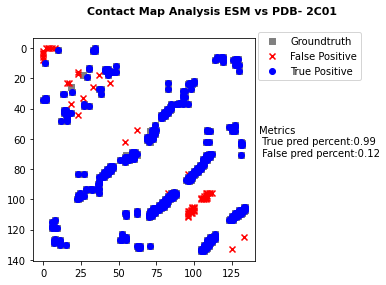

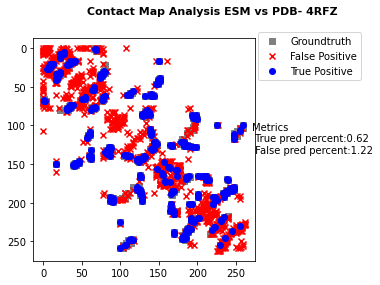

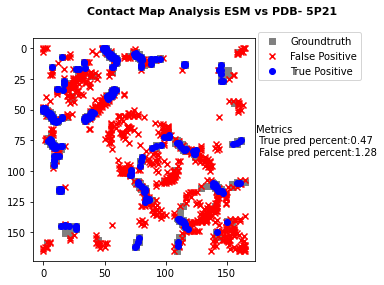

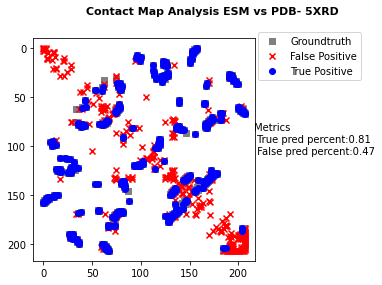

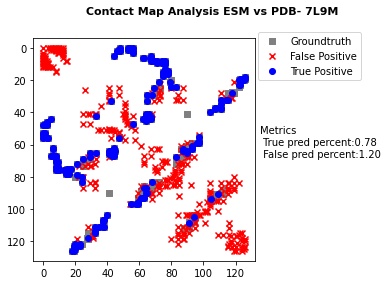

...

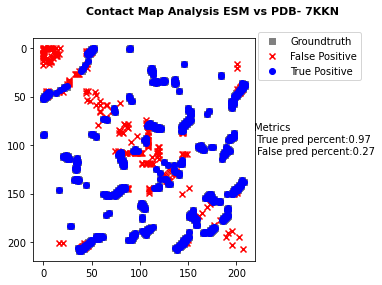

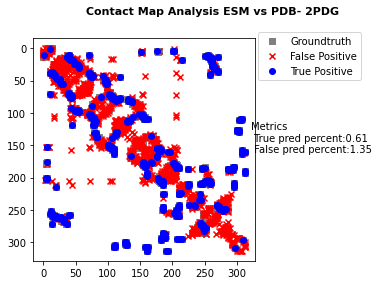

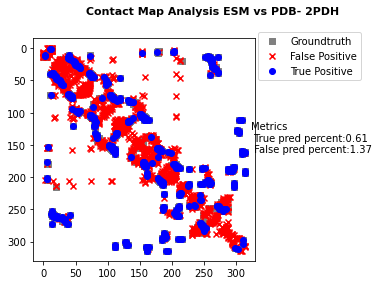

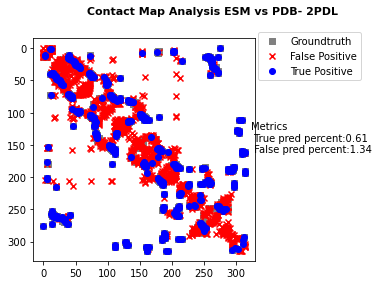

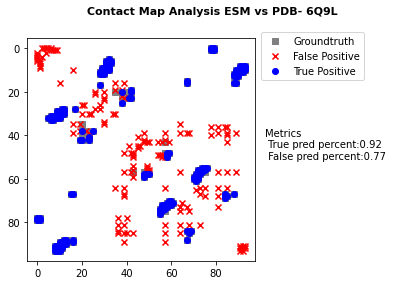

In [76]:
main4()

In [ ]:
import sys
from Bio import SeqIO

PDBFile = '/Users/rohan/Desktop/DTI_setup/data_main/pdb_files/pdb7sug.ent'
with open(PDBFile, 'r') as pdb_file:
    for record in SeqIO.parse(pdb_file, 'pdb-atom'):
        print('>' + record.id)
        print(record.seq)
        print(len(record.seq))
        
        

In [46]:
### Protein Alignment

In [ ]:
def seq_format(proteins_dic, output_dir):
    # datasets = ['kiba', 'davis']
    # for dataset in datasets:
    # seq_path = os.path.join('data', dataset, 'seq_original')
    # fpath = os.path.join('data', dataset, 'proteins.txt')
    # proteins = json.load(fpath, object_pairs_hook=OrderedDict)
    for key, value in proteins_dic.items():
        with open(os.path.join(output_dir, key + '.fasta'), 'w') as f:
            f.writelines('>' + key + '\r\n')
            f.writelines(value + '\r\n')



In [ ]:
def HHblitsMSA(bin_path, db_path, input_dir, output_dir):
    for fas_file in os.listdir(input_dir):
        process_file = os.path.join(input_dir, fas_file)
        output_file = os.path.join(output_dir, fas_file.split('.fasta')[0] + '.hhr')  # igore
        output_file_a3m = os.path.join(output_dir, fas_file.split('.fasta')[0] + '.a3m')
        if os.path.exists(output_file) and os.path.exists(output_file_a3m):
            # print(output_file, output_file_a3m, 'exist.')
            # count += 1
            continue
        # print(process_file)
        process_file = process_file.replace('(', '\(').replace(')', '\)')
        output_file = output_file.replace('(', '\(').replace(')', '\)')
        output_file_a3m = output_file_a3m.replace('(', '\(').replace(')', '\)')
        cmd = bin_path + ' -maxfilt 100000 -realign_max 100000 -d ' + db_path + ' -all -B 100000 -Z 100000 -n 3 -e 0.001 -i ' + process_file + ' -o ' + output_file + ' -oa3m ' + output_file_a3m + ' -cpu 8'
        print(cmd)
        os.system(cmd)
        # print(cmd)
        # print(count)


In [ ]:
def HHblitsMSA(bin_path, db_path, input_dir, output_dir):
    for fas_file in os.listdir(input_dir):
        process_file = os.path.join(input_dir, fas_file)
        output_file = os.path.join(output_dir, fas_file.split('.fasta')[0] + '.hhr')  # igore
        output_file_a3m = os.path.join(output_dir, fas_file.split('.fasta')[0] + '.a3m')
        if os.path.exists(output_file) and os.path.exists(output_file_a3m):
            # print(output_file, output_file_a3m, 'exist.')
            # count += 1
            continue
        # print(process_file)
        process_file = process_file.replace('(', '\(').replace(')', '\)')
        output_file = output_file.replace('(', '\(').replace(')', '\)')
        output_file_a3m = output_file_a3m.replace('(', '\(').replace(')', '\)')
        cmd = bin_path + ' -maxfilt 100000 -realign_max 100000 -d ' + db_path + ' -all -B 100000 -Z 100000 -n 3 -e 0.001 -i ' + process_file + ' -o ' + output_file + ' -oa3m ' + output_file_a3m + ' -cpu 8'
        print(cmd)
        os.system(cmd)
        # print(cmd)
        # print(count)


def HHfilter(bin_path, input_dir, output_dir):
    file_prefix = []
    # print(input_dir)
    for file in os.listdir(input_dir):
        if 'a3m' not in file:
            continue
        temp_prefix = file.split('.a3m')[0]
        if temp_prefix not in file_prefix:
            file_prefix.append(temp_prefix)
    # random.shuffle(file_prefix)
    # print(len(file_prefix))
    # print(file_prefix)
    for msa_file_prefix in file_prefix:
        file_name = msa_file_prefix + '.a3m'
        process_file = os.path.join(input_dir, file_name)
        output_file = os.path.join(output_dir, file_name)
        if os.path.exists(output_file):
            continue
        process_file = process_file.replace('(', '\(').replace(')', '\)')
        output_file = output_file.replace('(', '\(').replace(')', '\)')
        cmd = bin_path + ' -id 90 -i ' + process_file + ' -o ' + output_file
        print(cmd)
        os.system(cmd)


def reformat(bin_path, input_dir, output_dir):
    # print('reformat')
    for a3m_file in os.listdir(input_dir):
        process_file = os.path.join(input_dir, a3m_file)
        output_file = os.path.join(output_dir, a3m_file.split('.a3m')[0] + '.fas')
        if os.path.exists(output_file):
            continue
        process_file = process_file.replace('(', '\(').replace(')', '\)')
        output_file = output_file.replace('(', '\(').replace(')', '\)')
        cmd = bin_path + ' ' + process_file + ' ' + output_file + ' -r'
        print(cmd)
        os.system(cmd)


def convertAlignment(bin_path, input_dir, output_dir):
    # print('convertAlignment')
    for fas_file in os.listdir(input_dir):
        process_file = input_dir + '/' + fas_file
        output_file = output_dir + '/' + fas_file.split('.fas')[0] + '.aln'
        if os.path.exists(output_file):
            continue
        process_file = process_file.replace('(', '\(').replace(')', '\)')
        output_file = output_file.replace('(', '\(').replace(')', '\)')
        cmd = 'python ' + bin_path + ' ' + process_file + ' fasta ' + output_file
        print(cmd)
        os.system(cmd)



In [47]:
PDB_IDs = ["2D9Z",'3o96']
data4 = [
    read_sequence("rcsb_pdb_2D9Z.fasta"),
]

In [51]:
data4[0]

('2D9Z_1|Chain A|Protein kinase C, nu type|Homo sapiens (9606)',
 'GSSGSSGMVKEGWMVHYTSRDNLRKRHYWRLDSKCLTLFQNESGSKYYKEIPLSEILRISSPRDFTNISQGSNPHCFEIITDTMVYFVGENNGDSSHNPVLAATGVGLDVAQSWEKAIRQALMSGPSSG')

In [54]:
from Bio.Align.Applications import MafftCommandline

In [59]:
PDB_IDs = ["2D9Z",'3o96']
#Load ESM_1b Model
#esm1b,esm1b_batch_converter=load_ESM_1b()
#Set the path to results
results_path="/Users/rohan/Desktop/contact_map_analysis/data_main/aligned_fasta/" 
for i,j in enumerate(PDB_IDs):
    print(PDB_IDs[i])
    PDB_IDs_lower = str(PDB_IDs[i]).lower()
    #Set path to PDB files
    PDB_file = f'/Users/rohan/Desktop/DTI_setup/data_main/pdb_files/pdb{PDB_IDs_lower}.ent' 
    #Set path to FASTA files
    fasta_file=f'/Users/rohan/Desktop/contact_map_analysis/data_main/fasta_files/{PDB_IDs[i]}_1.fasta'
    print(fasta_file)
    aligned_fasta_file=f'//Users/rohan/Desktop/contact_map_analysis/data_main/aligned_fasta/{PDB_IDs[i]}_1_aligned.fasta'
    if os.path.isfile(PDB_file) and os.path.isfile(fasta_file):
        with open(fasta_file) as f:
            output= aligned_fasta_file
            mafft_cline=MafftCommandline(input=str(fasta_file))
            stdout,stderr=mafft_cline()
            with open(output,'w') as handle:
                handle.write(stdout)

2D9Z
/Users/rohan/Desktop/contact_map_analysis/data_main/fasta_files/2D9Z_1.fasta


ApplicationError: Non-zero return code 127 from 'mafft /Users/rohan/Desktop/contact_map_analysis/data_main/fasta_files/2D9Z_1.fasta', message '/bin/sh: mafft: command not found'

In [60]:
mafft_cline()

ApplicationError: Non-zero return code 127 from 'mafft /Users/rohan/Desktop/contact_map_analysis/data_main/fasta_files/2D9Z_1.fasta', message '/bin/sh: mafft: command not found'

In [79]:
a=np.array([[1,2,3],[2,3,4],[4,5,6],[7,8,9]])

In [80]:
a

array([[1, 2, 3],
       [2, 3, 4],
       [4, 5, 6],
       [7, 8, 9]])

In [87]:
a[1:3]

array([[2, 3, 4],
       [4, 5, 6]])

In [ ]:
def compareContactMaps_Difference(contact_pdb,contact_esm,pdb_name,results_path):
    """ Compare contact maps generated by ESM_1b vs PDB and compute accuracy."""
    print(contact_pdb.shape[0],contact_esm.shape[0])
    if contact_pdb.shape[0]==contact_esm.shape[0]:
        fig = plt.figure()
        title_text='Contact Map Analysis ESM vs PDB- %s'%(pdb_name)
        fig.suptitle(title_text, fontsize=11,fontweight='bold')
        contact_esm_flatten=contact_esm.flatten()
        
        contact_pdb_flatten=contact_pdb.flatten()
        acc,f1=accuracy_score(contact_pdb_flatten,contact_esm_flatten),f1_score(contact_pdb_flatten,contact_esm_flatten)
        
        gt=np.where(contact_pdb == 1)
        pred=np.where(contact_esm == 1)
        fps=np.where(contact_pdb-contact_esm==-1)
        tps=np.where(contact_esm+contact_pdb==2)
        fns=np.where(contact_pdb-contact_esm==1)
        
        prec,recall=precision_score(contact_pdb_flatten,contact_esm_flatten),recall_score(contact_pdb_flatten,contact_esm_flatten)
        mcc=matthews_corrcoef(contact_pdb_flatten,contact_esm_flatten)
        scatter1 = plt.scatter(gt[0],gt[1],c='grey',marker=".",label="Groundtruth")
        scatter2 = plt.scatter(fps[0],fps[1],c='red', marker="x", label="False Positive")
        scatter3=plt.scatter(tps[0],tps[1],c='blue', marker="o",label="True Positive")

        plt.legend(loc='upper right',bbox_to_anchor=(1.5,1.05))
        ax1 = scatter1.axes
        ax1.invert_yaxis()
        ax2 = scatter2.axes
        ax2.invert_yaxis()
        ax3 = scatter3.axes
        ax3.invert_yaxis()
        resultstr = 'Metrics\n Precision:%.2f\n Recall:%.2f\n F1-Score:%.2f\n MCC:%.2f'%(prec,recall,f1,mcc)
        plt.text(contact_esm.shape[0]+8, contact_esm.shape[0]/2+4, resultstr, fontsize=11)
        fig.tight_layout()
        final_result_path=results_path+pdb_name+".pdf"
        fig.savefig(final_result_path, bbox_inches='tight')
        return prec,recall,f1,mcc
    else:
        print('FASTA and PDB are differentt for' +str(pdb_name))
        return None,None,None,None